In [1]:
import json
from pathlib import Path
from functools import partial
from itertools import zip_longest

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import display, Markdown

In [5]:
SIMILARITIES_PATH_FMT = "../../data/test/user_study/vectors/{model}/similarities_consolidated/similarities.json"
PATH_TO_ARTICLES = "../../data/processed/articles/test/texts/"
PATH_TO_ARTICLE_LABELS = "../../data/processed/articles/test/labels/labels.jsonl"
PATH_TO_STOCKS = "../../data/processed/stocks/revolut.2021-07-05.complete.stocks.jsonl"
OPTIMAL_RUN_PARAMS = dict(strategy="full", ratio=0.8)

sns.set_style("whitegrid")
color_palette = sns.color_palette("Set2")

In [6]:
def read_all_articles(paths):
    articles = list()
    for path in paths:
        with open(path, "r") as fp:
            article = fp.read()
        articles.append(article)
    return articles


def read_json_file(path):
    with open(path, "r") as fp:
        content = json.load(fp)
    return content

    
def read_json_lines_file(path):
    content = dict()
    with open(path, "r") as fp:
        for line in fp:
            line_content = json.loads(line)
            content[line_content["doc_id"]] = line_content
    return content
    

def get_score(entity_similarities):
    ratio = OPTIMAL_RUN_PARAMS["ratio"]
    strategy = OPTIMAL_RUN_PARAMS["strategy"]
    apply_ratio = lambda x: (ratio) * x + (1 - ratio) * entity_similarities["evs_child"]
    target = "evs_full" if strategy == "full" else "evs_summary"
    score = apply_ratio(entity_similarities[target])
    return score


def print_strong(text):
    markdown = "**" + text + "**"
    display(Markdown(markdown))
    
    
def left_align_text(dataframe):
    return dataframe.style.set_properties(**{'text-align': 'left'})


def tukeys_higher_fence(observations, k=1.75):
    iqr = observations.quantile(0.75) - observations.quantile(0.25)
    return observations.quantile(0.75) + k * iqr


def threshold_func(x):
    return -3/4 * (x-1)**2 + 2

In [7]:
# Specify models
models = ["Doc2Vec(dm-c,d100,n20,w2,mc5,s1e-05,t4,ep40)",
          "Doc2Vec(dm-c,d75,n20,w1,mc5,s1e-05,t4,ep20)",
          "Doc2Vec(dm-c,d50,n20,w2,mc5,s1e-05,t4,ep20)",
          "Doc2Vec(dm-c,d100,n20,w3,mc5,s1e-05,t4,ep40)",
          "Doc2Vec(dm-c,d100,n20,w4,mc5,s1e-05,t4,ep20)"]

model_weights = [1.1, 0.9, 1.2, 0.9, 0.9]

# Specify and read article paths
article_paths = sorted(list(Path(PATH_TO_ARTICLES).glob("*.txt")),
                       key=lambda x: int(x.stem))
articles = read_all_articles(article_paths)

# Read in labels
labels = read_json_lines_file(PATH_TO_ARTICLE_LABELS)

# Specify similarities generated by the models
similarities = dict.fromkeys(models)
for model in models:
    fmt = dict(model=model)
    similarities[model] = read_json_file(SIMILARITIES_PATH_FMT.format(**fmt))

# Read in stocks
stocks_df = pd.read_json(PATH_TO_STOCKS, lines=True)
stocks_df.drop(columns=["dbpedia_endpoint", "company_name", "wiki_page_id"], inplace=True)

In [58]:
article_matches = dict()

def show_results(article_id, models=models, stocks_df=stocks_df, articles=articles, max_matches=10):
    print_strong(f"Article {article_id}")
    print(articles[article_id])
    article_labels = labels[article_id]

    scores_all = None
    for model, weight in zip(models, model_weights):
        # Obtain similarities generated by the model in question
        similarities_ = similarities[model][str(article_id)]
        
        # Obtain similarity scores configured by optimal run params and assign to a column `score`
        _ = {entity:get_score(similarities) for entity, similarities in similarities_.items()}
        scores = pd.Series(data=_, name="score")
        
        if scores_all is None:
            scores_all = scores * weight / len(models)
        else:
            scores_all += scores * weight / len(models)
        
    stocks = stocks_df.copy()
    stocks = stocks.merge(scores_all.to_frame(), left_on="ticker_symbol", right_index=True)

    # Capture distribution parameters
    mean = stocks.score.mean()        
    std = stocks.score.std()
    skewness = stocks.score.skew()
    kurtosis = stocks.score.kurtosis()

    # Find out if outliers exist
#     threshold_for_outliers = tukeys_higher_fence(stocks.score)
#     if any(stocks.score > threshold_for_outliers):
#         threshold = stocks.score.max() - 1.05 * std
#     else:
#         threshold = stocks.score.max() - 0.25 * std

    threshold = stocks.score.max() - threshold_func(skewness) * std

    # Sort `stocks` by `score` and resert index to indicate rankings
    stocks = stocks.sort_values("score", ascending=False).reset_index()

    # Define sets of stocks that were considered relevant by the arbiter but didn't make it
    past_threshold = stocks.score > threshold
    top_tickers = set(stocks[past_threshold].head(max_matches).ticker_symbol) 
    top_tickers_missed = set(article_labels["ticker_top"]) - top_tickers
    other_tickers_missed = set(article_labels["ticker_rel"]) - top_tickers

    # Display rankings
    with pd.option_context("display.max_colwidth", None):
#         if any(stocks.score > threshold_for_outliers):
#             print(f"{sum(stocks.score > threshold_for_outliers)} outliers detected")
#         else:
#             print("No outliers")

        # Display top rankings as per model
        print_strong("Top stocks")
        display(left_align_text(stocks.copy()[stocks.score > threshold].head(max_matches)))
        article_matches[article_id] = stocks.copy()[stocks.score > threshold].head(max_matches)

        # Display missed top rankings as per arbiter
        if top_tickers_missed:
            print_strong("Missed stocks regarded as top")
            display(left_align_text(stocks.copy()[stocks.ticker_symbol.isin(top_tickers_missed)]))

        # Display missed other relevant rankings as per arbiter
        if other_tickers_missed:
            print_strong("Missed stocks regarded as relevant")
            display(left_align_text(stocks.copy()[stocks.ticker_symbol.isin(other_tickers_missed)]))

    # Display swarmplot and annotate with kurtosis and standard deviation of score distribution
    ax = plt.figure(figsize=(12,4), dpi=200)
    ax = sns.swarmplot(data=stocks[~stocks.ticker_symbol.isin(top_tickers)], x="score", size=7, 
                       color=color_palette[0], alpha=0.9, edgecolor=None)
    ax = sns.swarmplot(data=stocks[stocks.ticker_symbol.isin(top_tickers)], x="score", size=7, 
                       color=color_palette[2], alpha=0.9, edgecolor=None)
    ax.vlines([threshold], 0, 1, transform=ax.get_xaxis_transform(), 
              colors=color_palette[1], lw=1, ls="--")
    ax.set_xticks(np.arange(0.45, 0.8, 0.05))
    
    common_params = dict(xycoords="figure fraction", fontsize=12, fontname='Courier New')
    ax.annotate(f"{'threshold'.ljust(10)} {threshold:>6.4f}", xy=(0.055,0.845), **common_params)
    ax.annotate(f"{'skew'.ljust(10)} {skewness:>6.4f}", xy=(0.055,0.795), **common_params)
    ax.annotate(f"{'kurtosis'.ljust(10)} {kurtosis:>6.4f}", xy=(0.055,0.745), **common_params)
    ax.annotate(f"{'std'.ljust(10)} {std:>6.4f}", xy=(0.055,0.695), **common_params)
    
    plt.tight_layout()
    plt.show()

    # Display distribution plot
    ax = plt.figure(figsize=(12,4), dpi=200)
    ax = sns.kdeplot(data=stocks, x="score")
    ax.set_xticks(np.arange(0.45, 0.8, 0.05))
    plt.tight_layout()
    plt.show()

    return stocks

**Article 0**

AT&T CFO Pascal Desroches Updates Shareholders

DALLAS, September 15, 2021--(BUSINESS WIRE)--Pascal Desroches, senior executive vice president and chief financial officer of AT&T Inc.* (NYSE:T), spoke today at the Bank of America Media, Communications & Entertainment Conference, where he provided an update to shareholders.

Desroches said that AT&T continues to successfully execute in its market focus areas of 5G, fiber and HBO Max. While acknowledging the wireless industry continues to benefit from a healthy-demand backdrop, AT&T remains steadfast in its commitment to growing its postpaid phone base profitably. Desroches said AT&T’s strength in wireless has been supported by the company’s outstanding network quality, which has improved measurably over the last several years. AT&T has the Nation’s Best 5G Network [1] and, for the fourth straight year, America’s Best Wireless Network [2] overall. In addition, as most recently indicated by AT&T’s second-quarter 2021 results, its revamped

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,439,Lumen Technologies,LUMN,Communications,Specialty Telecommunications,"Lumen Technologies (formerly CenturyLink) is an American telecommunications company headquartered in Monroe, Louisiana, that offers communications, network services, security, cloud solutions, voice, and managed services. The company is a member of the S&P 500 index and the Fortune 500. Its communications services include local and long-distance voice, broadband, Multi-Protocol Label Switching (MPLS), private line (including special access), Ethernet, hosting (including cloud hosting and managed hosting), data integration, video, network, public access, Voice over Internet Protocol (VoIP), information technology, and other ancillary services. Lumen also serves global enterprise customers across North America, Latin America, EMEA (Europe, Middle East, and Africa), and Asia Pacific.",0.753879
1,734,Vonage Holdings,VG,Communications,Specialty Telecommunications,"Vonage (/ˈvɒnɪdʒ/, legal name Vonage Holdings Corp.) is an American publicly held business cloud communications provider. Headquartered in Holmdel Township, New Jersey, the company was founded in 2001 as a provider of residential telecommunications services based on voice over Internet Protocol (VoIP).",0.751131
2,183,Comcast,CMCSA,Consumer Services,Cable/Satellite TV,"Comcast Corporation (formerly registered as Comcast Holdings) is an American telecommunications conglomerate headquartered in Philadelphia, Pennsylvania. It is the second-largest broadcasting and cable television company in the world by revenue (behind AT&T), the largest pay-TV company, the largest cable TV company and largest home Internet service provider in the United States, and the nation's third-largest home telephone service provider. Comcast provides services to U.S. residential and commercial customers in 40 states and in the District of Columbia. As the parent company of the international media company NBCUniversal since 2011, Comcast is a producer of feature films and television programs intended for theatrical exhibition and over-the-air and cable television broadcast, respecti",0.747331
3,126,Cable One,CABO,Consumer Services,Cable/Satellite TV,"Cable One, Inc. (NYSE: CABO) is an American broadband communications provider. They are a former subsidiary of Graham Holdings Company. The company's name and current focus date back to 1997; prior to that time the company was known as Post-Newsweek Cable. It is headquartered in Phoenix, Arizona, though it does not service the Phoenix area. Sparklight provides service to 21 states and 900,000 residential and business customers.",0.741331
4,727,ViacomCBS,VIACA,Consumer Services,Broadcasting,"ViacomCBS Inc. is an American diversified multinational mass media and entertainment conglomerate corporation formed through the merger of the second incarnation of CBS Corporation and the second incarnation of Viacom on December 4, 2019 (which were split from the first incarnation of Viacom in 2006) and headquartered at the One Astor Plaza complex in Midtown Manhattan, New York City, United States. The company operates over 170 networks and reaches approximately 700 million subscribers in approximately 180 countries, as of 2019.",0.737592
5,596,Roku,ROKU,Consumer Durables,Electronics/Appliances,"Roku, Inc. (/ˈroʊkuː/ ROH-koo) is an American publicly traded company based in San Jose, California, that manufactures a variety of digital media players for video streaming. Roku has an advertising business and also licenses its hardware and software to other companies.",0.735365
6,31,Altice USA,ATUS,Consumer Services,Cable/Satellite TV,"Altice USA, Inc., commonly known as Altice, is an American cable television provider with headquarters in New York City. It delivers pay television, Internet access, telephone services, and original television content to approximately 4.9 million residential and business customers in 21 states. As a multipl

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
120,72,AT&T,T,Communications,Major Telecommunications,"AT&T Inc. is an American multinational conglomerate holding company that is Delaware-registered but headquartered at Whitacre Tower in Downtown Dallas, Texas. It is the world's largest telecommunications company, it is also the largest provider of mobile telephone services in the U.S. As of 2020, AT&T was ranked 9th on the Fortune 500 rankings of the largest United States corporations, with revenues of $181 billion. The current AT&T reconstitutes much of the former Bell System, and includes four of the seven ""Baby Bells"" along with the original AT&T Corp., including the long-distance division.",0.681574


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
22,35,AMC,AMC,Consumer Services,Movies/Entertainment,"AMC Entertainment Holdings, Inc. (d/b/a AMC Theatres, originally an abbreviation for American Multi-Cinema; often referred to simply as AMC and known in some countries as AMC Cinemas or AMC Multi-Cinemas) is an American movie theater chain headquartered in Leawood, Kansas, and the largest movie theater chain in the world. Founded in 1920, AMC has the largest share of the U.S. theater market ahead of Regal and Cinemark Theatres.",0.714670
228,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.664365


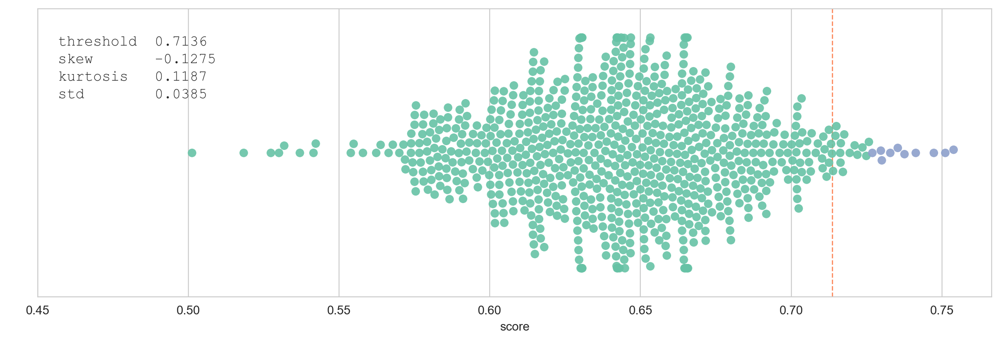

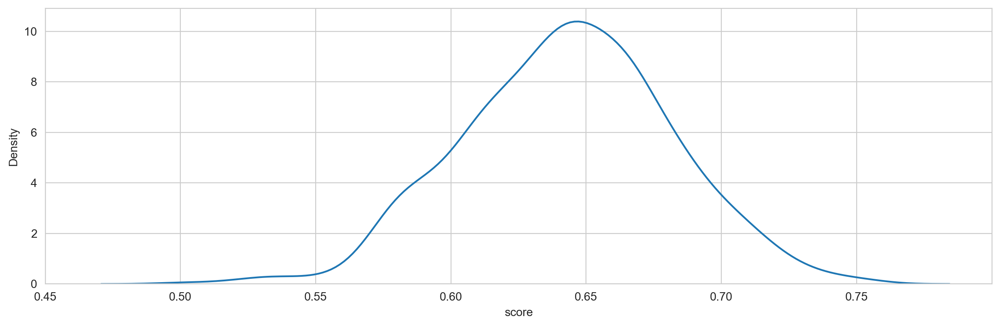

**Article 1**

Ford to build $11.4 billion mega campuses for electric car production

Saying Ford is driving head on into a future of electric vehicles may be an understatement. Think more along the line of hauling a-–. 

The Detroit-based auto giant said Monday it will partner with SK Innovation to invest $11.4 billion to construct two "mega-sites" — one in Tennessee and the other in Kentucky — that will build electric trucks and batteries. Ford's portion of the investment — $7 billion — is the largest manufacturing investment in the company's 118-year-old history. 

“This is a transformative moment where Ford will lead America’s transition to electric vehicles and usher in a new era of clean, carbon-neutral manufacturing,” said Ford executive chairman Bill Ford, a long-time proponent of the push to electric vehicles. “With this investment and a spirit of innovation, we can achieve goals once thought mutually exclusive – protect our planet, build great electric vehicles Americans will love and contr

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,430,Li Auto Inc.,LI,Producer Manufacturing,Auto Parts: OEM,"Li Auto Inc., also known as Li Xiang, is a Chinese electric vehicle manufacturer headquartered in Beijing, with manufacturing facilities in Changzhou.",0.715414
1,566,Proterra,PTRA,Finance,Financial Conglomerates,"Proterra is an American automotive and energy storage company based in Burlingame, California. The company designs and manufactures electric transit buses and electric charging systems. Proterra's Catalyst series includes transit buses ranging from 35 feet (11 m) to 40 feet (12 m) in length and various battery configurations. Buses are charged through an overhead charging station that is placed at maintenance facilities as well as route terminals. Founded in 2004, it became a public company in June 2021 through a business transaction with a Nasdaq-listed special-purpose acquisition company.",0.712994
2,140,Carvana Co.,CVNA,Retail Trade,Specialty Stores,"Carvana, based in Tempe, Arizona, is a leading e-commerce company that sells used cars through an easy-to-use technology platform. The Houston Chronicle dubbed the company the “Amazon of Auto”. The company is the fastest growing online used car dealer in the United States and is known for its multi-story car vending machines. Carvana is currently in hypergrowth mode and was recently added to the 2021 Fortune 500 List, one of the youngest companies to be added to the list.",0.712581
3,513,NRG Energy,NRG,Utilities,Electric Utilities,"NRG Energy, Inc. is a large American energy company, headquartered in Houston, Texas. It was formerly the wholesale arm of Northern States Power Company (NSP), which became Xcel Energy, but became independent in 2000. NRG Energy is involved in energy generation and retail electricity. Their portfolio includes natural gas generation, coal generation, oil generation, nuclear generation, wind generation, utility scale generation, and distributed solar generation. NRG serves 2.9 million retail customers in Texas, Connecticut, Delaware, Illinois, Maryland, Massachusetts, New Jersey, New York, Pennsylvania, Ohio, and the District of Columbia.",0.671679
4,631,Southern Company,SO,Utilities,Electric Utilities,"Southern Company is an American gas and electric utility holding company based in the southern United States. It is headquartered in Atlanta, Georgia, with executive offices also located in Birmingham, Alabama. The company is currently the second largest utility company in the U.S. in terms of customer base. Through its subsidiaries it serves 9 million gas and electric utility customers in 6 states. Southern Company's regulated regional electric utilities serve a 120,000-square-mile (310,000 km2) territory with 27,000 miles (43,000 km) of distribution lines.",0.664255
5,242,DTE Energy Co,DTE,Utilities,Electric Utilities,"DTE Energy (formerly Detroit Edison until 1996) is a Detroit-based diversified energy company involved in the development and management of energy-related businesses and services in the United States and Canada. Its operating units include an electric utility serving 2.2 million customers and a natural gas utility serving 1.3 million customers in Michigan. The DTE Energy portfolio includes non-utility energy businesses focused on power and industrial projects, energy marketing and trading.",0.658557
6,67,Arrival Group,ARVL,Consumer Durables,Motor Vehicles,"Arrival Ltd is a British-American electric vehicle manufacturer headquartered in London, UK, of primarily lightweight commercial vehicles. In June 2020, Arrival announced a new passenger bus designed for coronavirus-era social distancing. R&D takes place at their facility in Banbury, Oxfordshire. In March 2020, Arrival acquired a new factory in Bicester with plans to be operational by 2021 and start production in 2022. In December 2020, Arrival established its North American headquarters in Charlotte, NC, USA.",0.656337
7,298,Ford,F,Consumer Durables,Mo

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
13,502,NIO,NIO,Consumer Durables,Motor Vehicles,"NIO (Chinese: 蔚来; pinyin: Wèilái) is a Chinese multinational automobile manufacturer headquartered in Shanghai, specializing in designing and developing electric vehicles. The company is also involved in the FIA Formula E Championship, although NIO has ended funding the team after selling to Lisheng Racing.",0.643765
22,676,Tesla,TSLA,Consumer Durables,Motor Vehicles,"Tesla, Inc. is an American electric vehicle, clean energy, and technology company based in Palo Alto, California, United States. Tesla designs and manufactures electric cars, battery energy storage from home to grid-scale, solar panels and solar roof tiles, and related products and services. In 2020, Tesla had the most sales of battery electric vehicles and plug-in electric vehicles, capturing 16% of the plug-in market (which includes plug-in hybrids) and 23% of the battery-electric (purely electric) market. Through its subsidiary Tesla Energy, the company develops and is a major installer of photovoltaic systems in the United States. Tesla Energy is also one of the largest global suppliers of battery energy storage systems, with 3 gigawatt-hours (GWh) installed in 2020.",0.639088
36,311,General Motors,GM,Consumer Durables,Motor Vehicles,"General Motors Company (GM) is an American automotive multinational corporation headquartered in Detroit, Michigan, United States. It was founded by William C. Durant on September 16, 1908, as a holding company, and the present entity was established in 2009 after its restructuring. The company is the largest American automobile manufacturer and one of the world's largest automobile manufacturers.",0.631974
53,559,Plug Power,PLUG,Electronic Technology,Electronic Components,"Plug Power Inc. is an American company engaged in the development of hydrogen fuel cell systems that replace conventional batteries in equipment and vehicles powered by electricity. The company is headquartered in Latham, New York, and has facilities in Spokane, Washington, and Rochester, New York.",0.622497


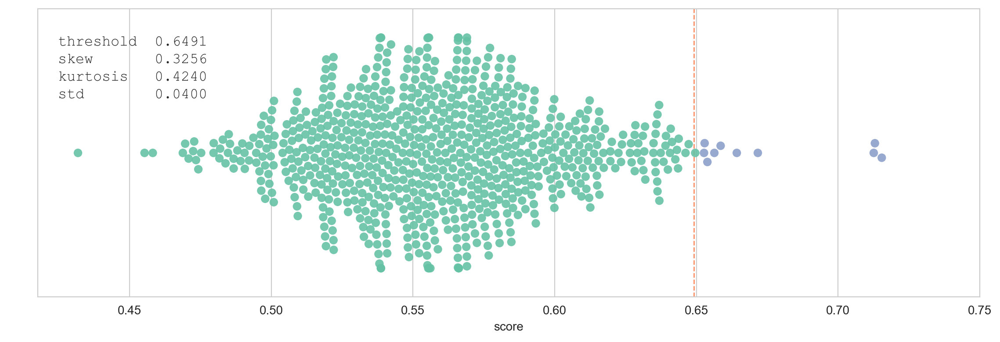

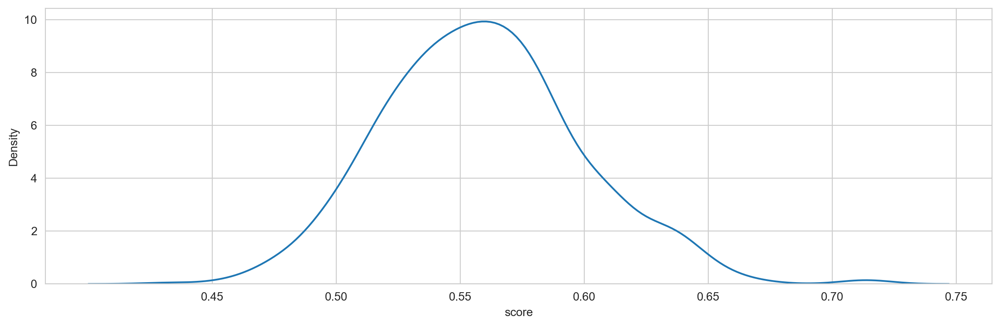

**Article 2**

General Motors and Motorq Team Up to Help Fleets Reduce Costs, Improve Driving Through Real-time, In-Vehicle Coaching Service

DETROIT and PALO ALTO, Calif., Sept. 28, 2021 (GLOBE NEWSWIRE) -- General Motors’ OnStar Business Solutions has teamed up with Motorq, the connected car API company, to help promote safer driving behaviors through a new In-Vehicle Coaching* service offered to fleet customers.

The In-Vehicle Coaching service provides fleet managers and drivers with real-time, verbal feedback regarding specific driving behaviors to help create awareness and encourage safer driving habits. Fleet owners set the criteria for each of the identified behaviors within the Motorq platform, including: if the driver is braking or accelerating too hard; if the driver is exceeding either/both the posted or maximum allowed speed limits and if the driver/passenger hasn’t fastened the seat belt.

Motorq’s secure, cloud-based platform analyzes streaming data directly from the vehicle in real-ti

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,636,Splunk,SPLK,Technology Services,Information Technology Services,"Splunk Inc. is an American technology company based in San Francisco, California, that produces software for searching, monitoring, and analyzing machine-generated data via a Web-style interface. Its software helps capture, index and correlate real-time data in a searchable repository, from which it can generate graphs, reports, alerts, dashboards and visualizations.Splunk uses machine data for identifying data patterns, providing metrics, diagnosing problems and providing intelligence for business operations. Splunk is a horizontal technology used for application management, security and compliance, as well as business and web analytics.",0.741153
1,312,Gentex,GNTX,Producer Manufacturing,Auto Parts: OEM,"Gentex Corporation (Nasdaq: GNTX) manufactures automatic-dimming rear-view mirrors, camera-based driver assistance systems, and the HomeLink Wireless Control System for the global automotive industry. The company also provides commercial smoke detectors and signaling devices to the North American fire protection market, as well as dimmable aircraft windows for the commercial, business and general aviation markets. The company is based in Zeeland, Michigan and was founded in 1974. Their mirrors use electrochromism to dim in proportion to the amount of light reaching them from following vehicles' headlamps. The mirrors are available with added electronic features. About 98 percent of the company's net sales are derived from the sale of auto-dimming mirrors to every major automaker in the wor",0.726317
2,701,UiPath,PATH,Technology Services,Packaged Software,"UiPath is a global software company for robotic process automation (RPA) founded in Romania by Daniel Dines and Marius Tîrcă and headquartered in New York City. The company's software monitors user activity to automate repetitive front and back office tasks, including those performed using other business software such as customer relationship management or enterprise resource planning (ERP) software. In December 2020, the company filed confidentially for an initial public offering, and became public on April 21, 2021.",0.723516
3,226,DiDi Global Inc.,DIDI,Technology Services,Packaged Software,"Didi Chuxing Technology Co., (stylized DiDi, Chinese: 滴滴出行; pinyin: Dīdī Chūxíng, pronounced [tɨ́tɨ́ ʈʂʰúɕɪ̌ŋ]), formerly named Didi Dache (嘀嘀打车) and Didi Kuaidi (Chinese: 滴滴快的), is a Chinese vehicle for hire company headquartered in Beijing with over 550 million users and tens of millions of drivers. The company provides app-based transportation services, including taxi hailing, private car hailing, social ride-sharing, and bike sharing; on-demand delivery services; and automobile services, including sales, leasing, financing, maintenance, fleet operation, electric vehicle charging, and co-development of vehicles with automakers. The company is a subsidiary of Xiaoju Kuaizhi Inc.",0.720249
4,770,Zebra Technologies,ZBRA,Electronic Technology,Computer Peripherals,"Zebra Technologies Corporation is a global enterprise mobile computing company that makes technology used to sense, analyze, and act in real time. The company manufactures and sells marking, tracking, and computer printing technologies. Its products include rugged mobile computers and tablets, intelligent software and solutions, thermal barcode label and receipt printers, RFID smart label printers/encoders/fixed & handheld readers/antennas, and card & kiosk printers that are used for barcode labeling, personal identification, and specialty printing, principally in the manufacturing, supply chain, retail, healthcare, and government sectors. Total revenue for 2020 was US$4.448 billion.",0.717485
5,322,GoPro,GPRO,Consumer Durables,Electronics/Appliances,"GoPro, Inc. (marketed as GoPro and sometimes stylized as GoPRO) is an American technology company founded in 2002 by Nick Woodman. It manufactures 

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
80,311,General Motors,GM,Consumer Durables,Motor Vehicles,"General Motors Company (GM) is an American automotive multinational corporation headquartered in Detroit, Michigan, United States. It was founded by William C. Durant on September 16, 1908, as a holding company, and the present entity was established in 2009 after its restructuring. The company is the largest American automobile manufacturer and one of the world's largest automobile manufacturers.",0.673858


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
10,676,Tesla,TSLA,Consumer Durables,Motor Vehicles,"Tesla, Inc. is an American electric vehicle, clean energy, and technology company based in Palo Alto, California, United States. Tesla designs and manufactures electric cars, battery energy storage from home to grid-scale, solar panels and solar roof tiles, and related products and services. In 2020, Tesla had the most sales of battery electric vehicles and plug-in electric vehicles, capturing 16% of the plug-in market (which includes plug-in hybrids) and 23% of the battery-electric (purely electric) market. Through its subsidiary Tesla Energy, the company develops and is a major installer of photovoltaic systems in the United States. Tesla Energy is also one of the largest global suppliers of battery energy storage systems, with 3 gigawatt-hours (GWh) installed in 2020.",0.710187
76,298,Ford,F,Consumer Durables,Motor Vehicles,"Ford Motor Company (commonly known as Ford) is an American multinational automobile manufacturer headquartered in Dearborn, Michigan, United States. It was founded by Henry Ford and incorporated on June 16, 1903. The company sells automobiles and commercial vehicles under the Ford brand, and luxury cars under its Lincoln luxury brand. Ford also owns Brazilian SUV manufacturer Troller, an 8% stake in Aston Martin of the United Kingdom and a 32% stake in Jiangling Motors. It also has joint-ventures in China (Changan Ford), Taiwan (Ford Lio Ho), Thailand (AutoAlliance Thailand), Turkey (Ford Otosan), and Russia (Ford Sollers). The company is listed on the New York Stock Exchange and is controlled by the Ford family; they have minority ownership but the majority of the voting power.",0.674816
79,502,NIO,NIO,Consumer Durables,Motor Vehicles,"NIO (Chinese: 蔚来; pinyin: Wèilái) is a Chinese multinational automobile manufacturer headquartered in Shanghai, specializing in designing and developing electric vehicles. The company is also involved in the FIA Formula E Championship, although NIO has ended funding the team after selling to Lisheng Racing.",0.674300


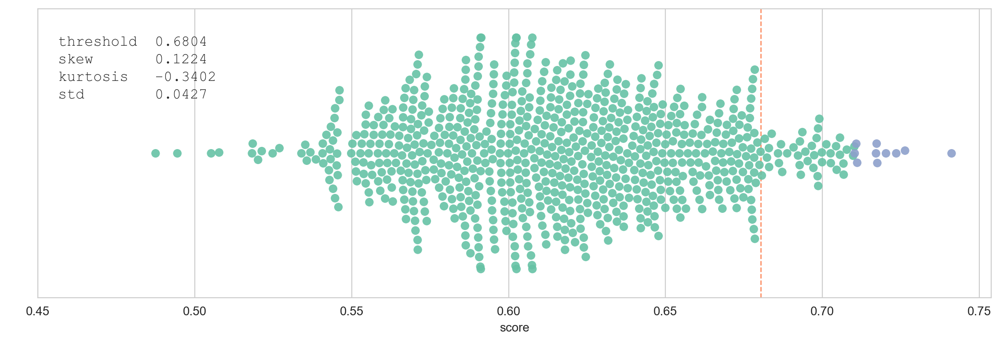

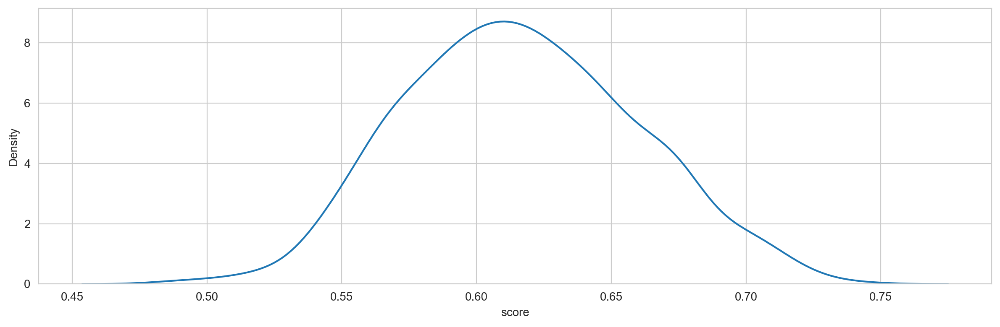

**Article 3**

NIO: Consumers Will Soon Realize NIO Has What Other EVs Are Missing, BaaS

Summary

1. NIO is a leading player in the Chinese electric vehicle market and their unique technology grants it several long-term advantages over competitors.
2. Their battery as a service technology solves a lot of short and long-term problems with EVs and cars in general.
3. China has been on a legislative tear recently, hurting many domestic companies. However, NIO's mission lines up with many Chinese goals and is likely to enjoy preferential treatment.
4. The current fall of Chinese stocks makes NIO an attractive long-term investment.
NIO logo and the Nio"s user center, NIO House

Thesis

NIO Inc. (NIO) is one of the leading electric vehicle producers in China, the largest market for EVs. While still being outsold by Tesla (TSLA), the fast-growing nature of the company and market offers promise. Their battery as a service subscription option offers NIO a unique advantage and solves many of the problems cons

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,763,Xpeng,XPEV,Consumer Durables,Motor Vehicles,"Xpeng or Xiaopeng Motors (Chinese: 小鹏汽车), also known as XMotors.ai, is a Chinese electric vehicle manufacturer. The company is headquartered in Guangzhou, with offices in Mountain View, California in the US and is publicly traded on the New York Stock Exchange.",0.793448
1,502,NIO,NIO,Consumer Durables,Motor Vehicles,"NIO (Chinese: 蔚来; pinyin: Wèilái) is a Chinese multinational automobile manufacturer headquartered in Shanghai, specializing in designing and developing electric vehicles. The company is also involved in the FIA Formula E Championship, although NIO has ended funding the team after selling to Lisheng Racing.",0.767108
2,430,Li Auto Inc.,LI,Producer Manufacturing,Auto Parts: OEM,"Li Auto Inc., also known as Li Xiang, is a Chinese electric vehicle manufacturer headquartered in Beijing, with manufacturing facilities in Changzhou.",0.740425
3,566,Proterra,PTRA,Finance,Financial Conglomerates,"Proterra is an American automotive and energy storage company based in Burlingame, California. The company designs and manufactures electric transit buses and electric charging systems. Proterra's Catalyst series includes transit buses ranging from 35 feet (11 m) to 40 feet (12 m) in length and various battery configurations. Buses are charged through an overhead charging station that is placed at maintenance facilities as well as route terminals. Founded in 2004, it became a public company in June 2021 through a business transaction with a Nasdaq-listed special-purpose acquisition company.",0.717797
4,676,Tesla,TSLA,Consumer Durables,Motor Vehicles,"Tesla, Inc. is an American electric vehicle, clean energy, and technology company based in Palo Alto, California, United States. Tesla designs and manufactures electric cars, battery energy storage from home to grid-scale, solar panels and solar roof tiles, and related products and services. In 2020, Tesla had the most sales of battery electric vehicles and plug-in electric vehicles, capturing 16% of the plug-in market (which includes plug-in hybrids) and 23% of the battery-electric (purely electric) market. Through its subsidiary Tesla Energy, the company develops and is a major installer of photovoltaic systems in the United States. Tesla Energy is also one of the largest global suppliers of battery energy storage systems, with 3 gigawatt-hours (GWh) installed in 2020.",0.708797


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
35,298,Ford,F,Consumer Durables,Motor Vehicles,"Ford Motor Company (commonly known as Ford) is an American multinational automobile manufacturer headquartered in Dearborn, Michigan, United States. It was founded by Henry Ford and incorporated on June 16, 1903. The company sells automobiles and commercial vehicles under the Ford brand, and luxury cars under its Lincoln luxury brand. Ford also owns Brazilian SUV manufacturer Troller, an 8% stake in Aston Martin of the United Kingdom and a 32% stake in Jiangling Motors. It also has joint-ventures in China (Changan Ford), Taiwan (Ford Lio Ho), Thailand (AutoAlliance Thailand), Turkey (Ford Otosan), and Russia (Ford Sollers). The company is listed on the New York Stock Exchange and is controlled by the Ford family; they have minority ownership but the majority of the voting power.",0.658533
38,559,Plug Power,PLUG,Electronic Technology,Electronic Components,"Plug Power Inc. is an American company engaged in the development of hydrogen fuel cell systems that replace conventional batteries in equipment and vehicles powered by electricity. The company is headquartered in Latham, New York, and has facilities in Spokane, Washington, and Rochester, New York.",0.655868
51,311,General Motors,GM,Consumer Durables,Motor Vehicles,"General Motors Company (GM) is an American automotive multinational corporation headquartered in Detroit, Michigan, United States. It was founded by William C. Durant on September 16, 1908, as a holding company, and the present entity was established in 2009 after its restructuring. The company is the largest American automobile manufacturer and one of the world's largest automobile manufacturers.",0.645188


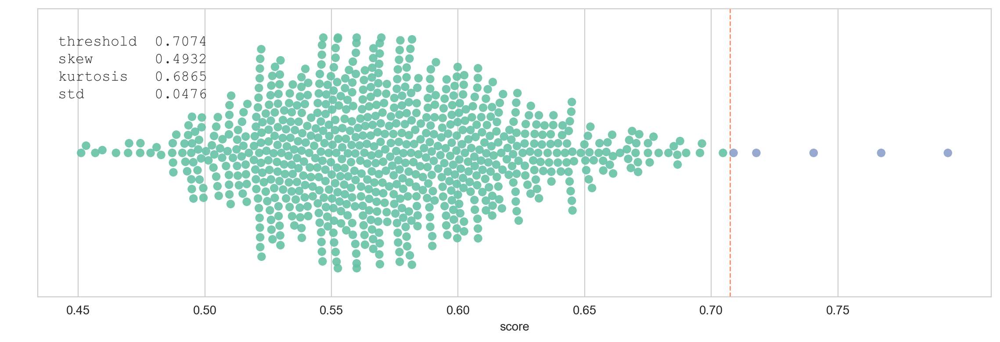

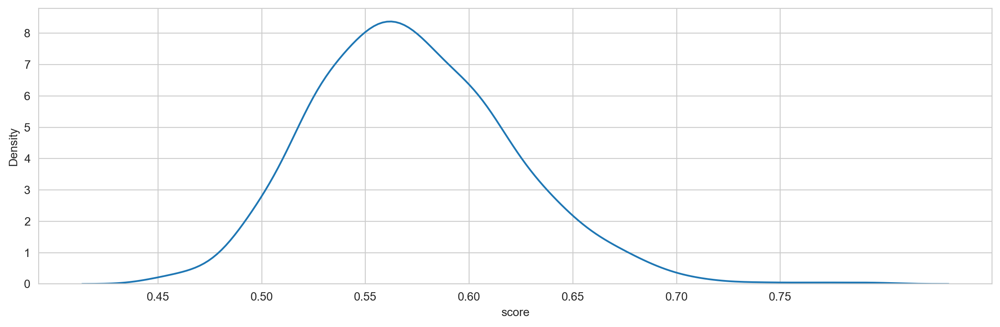

**Article 4**

EV Competition Has Arrived: Does Tesla Have The Answer?

Summary

1. Tesla set the standard when it comes to electric vehicles.
2. Now, Tesla is starting to face competition as legacy automakers and startups like Lucid Motors are bringing their electric vehicles to market.
3. Tesla trades at a high 20x P/S and is overvalued.
4. Tesla is taking the best approach when it comes to developing AI thanks to the significant amount of data it's collecting.
5. I'm neutral on Tesla.
6. This idea was discussed in more depth with members of my private investing community, Beating the Market. 

Investment Thesis

When Tesla (NASDAQ:TSLA) IPOd in 2010, EV cars weren’t as popular as they are today, and Tesla, with a visionary leader in Elon Musk, became the global EV giant that’s set the standard for high-quality EVS. However, Tesla’s stock price is up 700% over the past 18 months and it’s no longer a speculative play like it was a few years ago. Now that the EV market is heating up, Tesla faces more

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,763,Xpeng,XPEV,Consumer Durables,Motor Vehicles,"Xpeng or Xiaopeng Motors (Chinese: 小鹏汽车), also known as XMotors.ai, is a Chinese electric vehicle manufacturer. The company is headquartered in Guangzhou, with offices in Mountain View, California in the US and is publicly traded on the New York Stock Exchange.",0.793534
1,502,NIO,NIO,Consumer Durables,Motor Vehicles,"NIO (Chinese: 蔚来; pinyin: Wèilái) is a Chinese multinational automobile manufacturer headquartered in Shanghai, specializing in designing and developing electric vehicles. The company is also involved in the FIA Formula E Championship, although NIO has ended funding the team after selling to Lisheng Racing.",0.752659
2,676,Tesla,TSLA,Consumer Durables,Motor Vehicles,"Tesla, Inc. is an American electric vehicle, clean energy, and technology company based in Palo Alto, California, United States. Tesla designs and manufactures electric cars, battery energy storage from home to grid-scale, solar panels and solar roof tiles, and related products and services. In 2020, Tesla had the most sales of battery electric vehicles and plug-in electric vehicles, capturing 16% of the plug-in market (which includes plug-in hybrids) and 23% of the battery-electric (purely electric) market. Through its subsidiary Tesla Energy, the company develops and is a major installer of photovoltaic systems in the United States. Tesla Energy is also one of the largest global suppliers of battery energy storage systems, with 3 gigawatt-hours (GWh) installed in 2020.",0.744778
3,688,Toyota,TM,Consumer Durables,Motor Vehicles,"Toyota Motor Corporation (Japanese: トヨタ自動車株式会社, Hepburn: Toyota Jidōsha kabushiki gaisha, IPA: [toꜜjota], English: /tɔɪˈoʊtə/, commonly known as simply Toyota) is a Japanese multinational automotive manufacturer headquartered in Toyota City, Aichi, Japan. It was founded by Kiichiro Toyoda and incorporated on August 28, 1937. Toyota is one of the largest automobile manufacturers in the world, producing about 10 million vehicles per year.",0.736576
4,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.733216
5,346,Himax Technologies,HIMX,Electronic Technology,Semiconductors,"Himax Technologies, Inc. (Nasdaq: HIMX) is a leading supplier and fabless semiconductor manufacturer headquartered in Tainan City, Taiwan founded on 12 June 2001. The company is publicly traded and listed on the Nasdaq Stock Market under the symbol HIMX. The Himax Technologies Limited functions as a holding under the Cayman Islands Companies Law.",0.729247
6,226,DiDi Global Inc.,DIDI,Technology Services,Packaged Software,"Didi Chuxing Technology Co., (stylized DiDi, Chinese: 滴滴出行; pinyin: Dīdī Chūxíng, pronounced [tɨ́tɨ́ ʈʂʰúɕɪ̌ŋ]), formerly named Didi Dache (嘀嘀打车) and Didi Kuaidi (Chinese: 滴滴快的), is a Chinese vehicle for hire company headquartered in Beijing with over 550 million users and tens of millions of drivers. The company provides app-based transportation services, including taxi hailing, private car hailing, social ride-sharing, and bike sharing; on-demand delivery services; and automobile services, including sales, leasing, financing, maintenance, fleet operation, electric vehicle charging, and co-development of vehicles with automakers. The company is a subsidiary of Xiaoju Kuaizhi Inc.",0.725754


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
34,298,Ford,F,Consumer Durables,Motor Vehicles,"Ford Motor Company (commonly known as Ford) is an American multinational automobile manufacturer headquartered in Dearborn, Michigan, United States. It was founded by Henry Ford and incorporated on June 16, 1903. The company sells automobiles and commercial vehicles under the Ford brand, and luxury cars under its Lincoln luxury brand. Ford also owns Brazilian SUV manufacturer Troller, an 8% stake in Aston Martin of the United Kingdom and a 32% stake in Jiangling Motors. It also has joint-ventures in China (Changan Ford), Taiwan (Ford Lio Ho), Thailand (AutoAlliance Thailand), Turkey (Ford Otosan), and Russia (Ford Sollers). The company is listed on the New York Stock Exchange and is controlled by the Ford family; they have minority ownership but the majority of the voting power.",0.691432
45,311,General Motors,GM,Consumer Durables,Motor Vehicles,"General Motors Company (GM) is an American automotive multinational corporation headquartered in Detroit, Michigan, United States. It was founded by William C. Durant on September 16, 1908, as a holding company, and the present entity was established in 2009 after its restructuring. The company is the largest American automobile manufacturer and one of the world's largest automobile manufacturers.",0.683537
81,559,Plug Power,PLUG,Electronic Technology,Electronic Components,"Plug Power Inc. is an American company engaged in the development of hydrogen fuel cell systems that replace conventional batteries in equipment and vehicles powered by electricity. The company is headquartered in Latham, New York, and has facilities in Spokane, Washington, and Rochester, New York.",0.669574


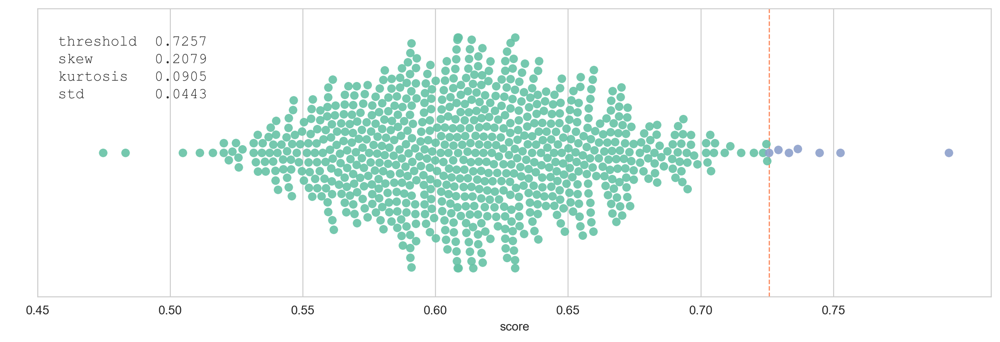

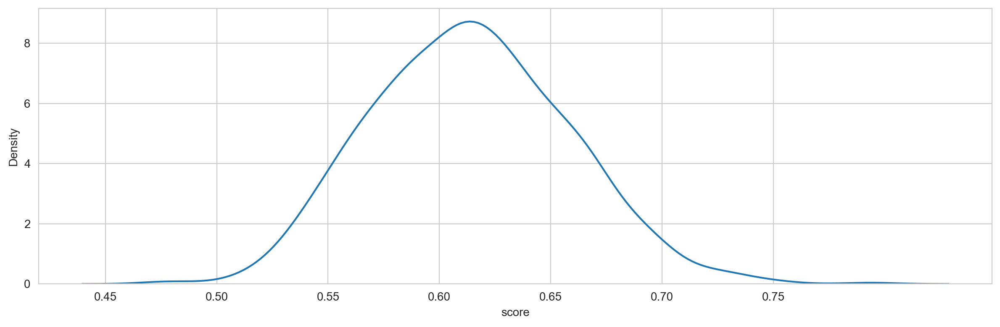

**Article 5**

Better Beer Stock: Ambev or Boston Beer Company?

ABEV – Even though beer consumption dipped last year, the reopening of restaurants this year has been pushing up beer company sales. That is why we think it could be wise now to evaluate established beer companies Ambev (ABEV) and Boston Beer (SAM) to identify which one is a better buy now? Read more to find out. 

Based in Sao Paulo, Brazil, Ambev S.A. (ABEV - Get Rating) produces, distributes, sells beer, draft beer, carbonated soft drinks, other non-alcoholic beverages, malt, and food products. Its segments include Brazil, Central America and the Caribbean, Latin America South, and Canada. In comparison, The Boston Beer Company, Inc. (SAM - Get Rating) produces and sells alcoholic beverages primarily in the United States. In addition to its flagship beer—Samuel Adams Boston Lager—it also offers hard ciders and hard seltzers under the Twisted Tea, Angry Orchard, Dogfish Head, and Concrete Beach brand names.

The beer industry suffered

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,51,Anheuser Busch Inbev NV,BUD,Consumer Non-Durables,Beverages: Alcoholic,"Anheuser-Busch InBev SA/NV, commonly known as AB InBev, is a multinational drink and brewing company based in Leuven, Belgium. AB InBev has a global functional management office in New York City, and regional headquarters in São Paulo, London, St. Louis, Mexico City, Bremen, Johannesburg and others. It has approximately 630 beer brands in 150 countries. AB InBev was formed through InBev (itself a merger between Interbrew from Belgium and AmBev from Brazil) acquiring Anheuser-Busch from the United States.",0.738957
1,34,Ambev,ABEV,Consumer Non-Durables,Beverages: Alcoholic,"Ambev, formally Companhia de Bebidas das Américas (""Americas' Beverage Company"" in English, hence the ""Ambev"" abbreviation), is a Brazilian brewing company now merged into Anheuser-Busch InBev. It was created on July 1, 1999, with the merger of two breweries, Brahma and Antarctica. The merger was approved by the board of directors of the Brazilian Administrative Council for Economic Defense (CADE) on March 30, 2000. The headquarters are in São Paulo, Brazil. It is one of the largest companies by market capitalization in Brazil and in the Southern hemisphere.",0.724106
2,406,Keurig Dr Pepper,KDP,Consumer Non-Durables,Beverages: Non-Alcoholic,"Dr Pepper Snapple Group (also called Dr. Pepper/7up Inc.) was an American multinational soft drink company based in Plano, Texas, and as of July 2018 it is a business unit of the publicly traded conglomerate Keurig Dr Pepper. Formerly Cadbury Schweppes Americas Beverages, part of Cadbury Schweppes, on May 5, 2008 it was spun off from Cadbury Schweppes as Dr Pepper Snapple Group, with trading in its shares starting on May 7, 2008 on the NYSE as ""DPS"". The remainder of Cadbury Schweppes become Cadbury, a confectionery group, on May 5, 2008.",0.712538
3,416,Kraft Heinz,KHC,Consumer Non-Durables,Food: Major Diversified,"The Kraft Heinz Company (KHC), commonly known as Kraft Heinz, is an American food company formed by the merger of Kraft Foods and Heinz. Co-headquartered in Chicago, Illinois, and Pittsburgh, Pennsylvania. Kraft Heinz is the third-largest food and beverage company in North America and the fifth-largest in the world with over $26.0 billion in annual sales as of 2020.",0.709230
4,195,Constellation Brands,STZ,Consumer Non-Durables,Beverages: Alcoholic,"Constellation Brands, Inc., a Fortune 500 company, is an American producer and marketer of beer, wine, and spirits. Constellation is the largest beer import company in the US, measured by sales, and has the third-largest market share (7.4 percent) of all major beer suppliers. It also has investments in medical and recreational cannabis. Based in Victor, New York, Constellation has about 40 facilities and approximately 9,000 employees.",0.699007


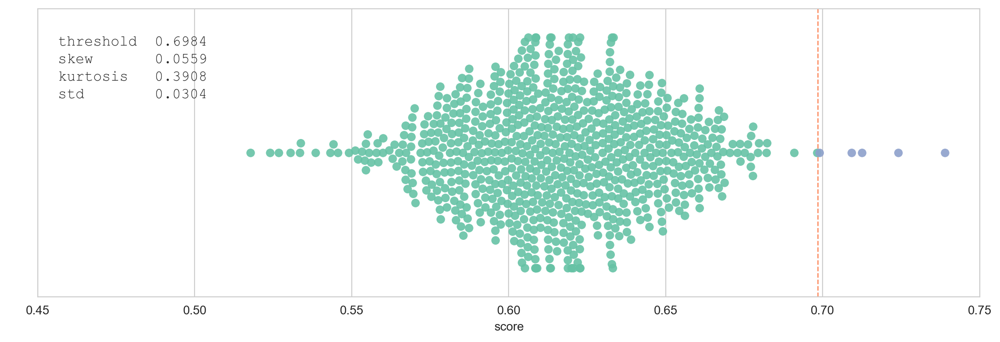

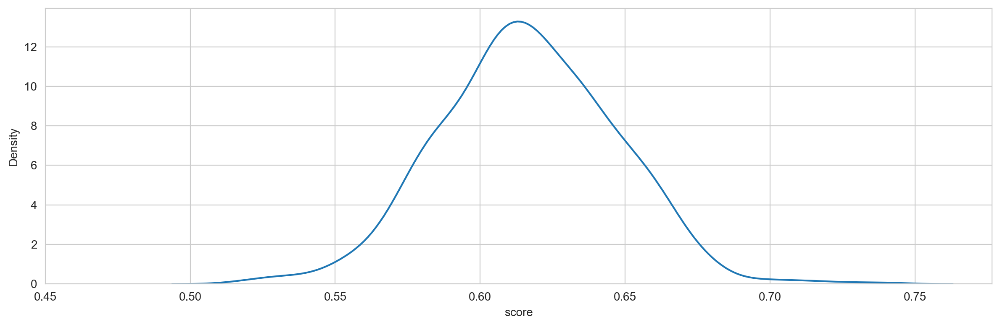

**Article 6**

Carnival says cruise bookings for 2022 second half above pre-pandemic levels

KEY POINTS
1. Carnival Corp said on Friday cruise bookings for the second half of 2022 were ahead of pre-pandemic levels.
2. Carnival said its voyages for the third quarter were cash flow positive, adding that it expects the trend to continue.
3. The company, which reported a third-quarter adjusted loss of $1.99 billion, said its monthly average cash burn rate was $510 million during the reported quarter.

Carnival Corp said on Friday cruise bookings for the second half of 2022 were ahead of pre-pandemic levels, in a sign the cruise operator expects a rebound in business as it restarts voyages globally.

The cruise sector has been among those most affected by the pandemic as many ships docked at ports and anchored offshore for months without passengers, forcing operators to raise billions of dollars in debt to stay afloat.

Some cruise enthusiasts are looking forward to the resumption of more voyages from U.S

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,600,Royal Caribbean Cruises,RCL,Consumer Services,Hotels/Resorts/Cruise lines,"Royal Caribbean Group, formerly known as Royal Caribbean Cruises Ltd., is an American global cruise holding company incorporated in Liberia and based in Miami, Florida, US. It is the world's second-largest cruise line operator, after Carnival Corporation & plc. As of January 2021, Royal Caribbean Group fully owns three cruise lines: Royal Caribbean International, Celebrity Cruises, and Silversea Cruises. They also hold a 50% stake in TUI Cruises and the now-defunct Pullmantur Cruises and CDF Croisières de France. Previously Royal Caribbean Group also fully owned Azamara Cruises selling the cruise line to Sycamore Partners in January 2021, and 50% of Island Cruises, selling their stake to TUI Travel PLC in October 2008.",0.740355
1,509,Norwegian Cruise Line Holdings,NCLH,Consumer Services,Hotels/Resorts/Cruise lines,"Norwegian Cruise Line (NCL), also known in short as Norwegian, is an American cruise line founded in 1966, incorporated in Bermuda and headquartered in Miami. It is the third-largest cruise line in the world by passengers, controlling about 8.7% of the total worldwide share of the cruise market by passengers as of 2018. It is wholly owned by parent company Norwegian Cruise Line Holdings.",0.724384
2,137,Carnival,CCL,Consumer Services,Hotels/Resorts/Cruise lines,"Carnival Corporation & plc is a British-American cruise operator, currently the world's largest travel leisure company, with a combined fleet of over 100 vessels across 10 cruise line brands. A dual-listed company, Carnival is composed of two companies – Panama-incorporated, US-headquartered Carnival Corporation, and UK-based Carnival plc – which function as one entity. Carnival Corporation is listed on the New York Stock Exchange, whereas Carnival plc is listed on the London Stock Exchange, with ADRs representing Carnival plc shares available on the New York Stock Exchange. Carnival is listed in both the S&P 500 and FTSE 250 indices.",0.702069
3,34,Ambev,ABEV,Consumer Non-Durables,Beverages: Alcoholic,"Ambev, formally Companhia de Bebidas das Américas (""Americas' Beverage Company"" in English, hence the ""Ambev"" abbreviation), is a Brazilian brewing company now merged into Anheuser-Busch InBev. It was created on July 1, 1999, with the merger of two breweries, Brahma and Antarctica. The merger was approved by the board of directors of the Brazilian Administrative Council for Economic Defense (CADE) on March 30, 2000. The headquarters are in São Paulo, Brazil. It is one of the largest companies by market capitalization in Brazil and in the Southern hemisphere.",0.692042


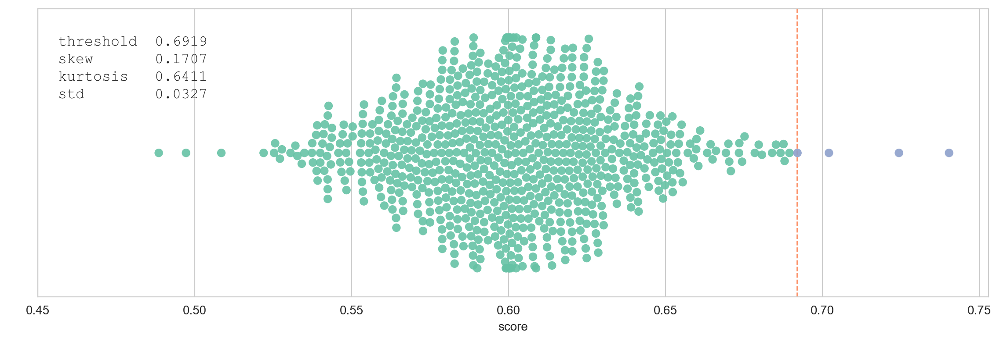

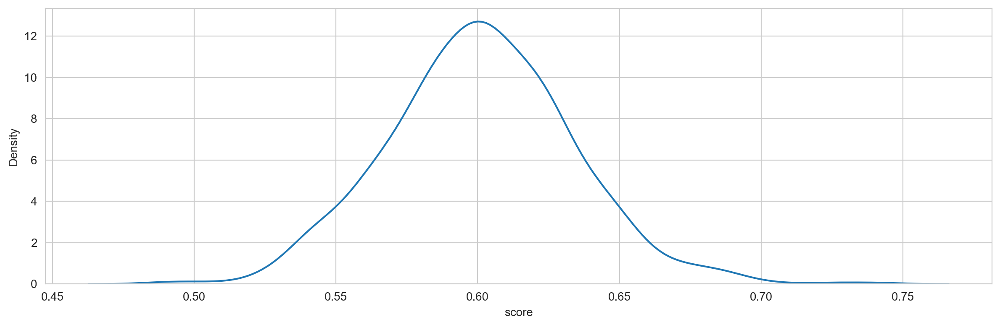

**Article 7**

Norwegian Cruise Line Officially Returns to New York

Norwegian Cruise Line is continuing to ramp up operations, this time from The Big Apple. 

On Sunday, Sept. 26, Norwegian Breakaway made its post-COVID debut back in New York City, the start of a season of week-long sailings to Bermuda for the ship.

The ship will welcome guests from the Manhattan Cruise Terminal through the end of October, sailings that include overnight calls to the Royal Naval Dockyard. 

It will then reposition to New Orleans following a 14-day journey to the Caribbean with calls to Puerto Plata, Dominican Republic; Willemstad, Curacao; Oranjestad, Aruba; Colón, Panama; Puerto Limón, Costa Rica; George Town, Grand Cayman; and Cozumel, Mexico.

In a statement, Norwegian president and CEO Harry Sommer called the news “a significant milestone in our Great Cruise Comeback from the U.S.”

"We have a 30-year history of cruising from New York and were the first to sail from the destination year-round. Our return feels 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,509,Norwegian Cruise Line Holdings,NCLH,Consumer Services,Hotels/Resorts/Cruise lines,"Norwegian Cruise Line (NCL), also known in short as Norwegian, is an American cruise line founded in 1966, incorporated in Bermuda and headquartered in Miami. It is the third-largest cruise line in the world by passengers, controlling about 8.7% of the total worldwide share of the cruise market by passengers as of 2018. It is wholly owned by parent company Norwegian Cruise Line Holdings.",0.701530
1,600,Royal Caribbean Cruises,RCL,Consumer Services,Hotels/Resorts/Cruise lines,"Royal Caribbean Group, formerly known as Royal Caribbean Cruises Ltd., is an American global cruise holding company incorporated in Liberia and based in Miami, Florida, US. It is the world's second-largest cruise line operator, after Carnival Corporation & plc. As of January 2021, Royal Caribbean Group fully owns three cruise lines: Royal Caribbean International, Celebrity Cruises, and Silversea Cruises. They also hold a 50% stake in TUI Cruises and the now-defunct Pullmantur Cruises and CDF Croisières de France. Previously Royal Caribbean Group also fully owned Azamara Cruises selling the cruise line to Sycamore Partners in January 2021, and 50% of Island Cruises, selling their stake to TUI Travel PLC in October 2008.",0.696182
2,137,Carnival,CCL,Consumer Services,Hotels/Resorts/Cruise lines,"Carnival Corporation & plc is a British-American cruise operator, currently the world's largest travel leisure company, with a combined fleet of over 100 vessels across 10 cruise line brands. A dual-listed company, Carnival is composed of two companies – Panama-incorporated, US-headquartered Carnival Corporation, and UK-based Carnival plc – which function as one entity. Carnival Corporation is listed on the New York Stock Exchange, whereas Carnival plc is listed on the London Stock Exchange, with ADRs representing Carnival plc shares available on the New York Stock Exchange. Carnival is listed in both the S&P 500 and FTSE 250 indices.",0.687107
3,635,Spirit Airlines,SAVE,Transportation,Airlines,"Spirit Airlines, Inc. (stylized as spirit) is an American ultra-low-cost carrier headquartered in Miramar, Florida in the Miami metropolitan area. Spirit operates scheduled flights throughout the United States and in the Caribbean and Latin America.",0.676797
4,363,Hyatt Hotels,H,Consumer Services,Hotels/Resorts/Cruise lines,"Hyatt Hotels Corporation, commonly known as Hyatt Hotels & Resorts, is an American multinational hospitality company headquartered in the Riverside Plaza area of Chicago that manages and franchises luxury and business hotels, resorts, and vacation properties.",0.661600
5,446,Marriott,MAR,Consumer Services,Hotels/Resorts/Cruise lines,"Marriott International, Inc. is an American multinational company that operates, franchises, and licenses lodging including hotel, residential, and timeshare properties. It is headquartered in Bethesda, Maryland. The company was founded by J. Willard Marriott and his wife Alice Marriott; the executive chairman of the company is now their son, Bill Marriott and the Marriott family retains majority ownership of the company. Marriott is the largest hotel chain in the world by the number of available rooms. It has 30 brands with 7,642 properties containing 1,423,044 rooms in 131 countries and territories. Of these 7,642 properties, 2,149 are operated by Marriott, and 5,493 are operated by others pursuant to franchise agreements. The company also operates 20 hotel reservation centers.",0.651896
6,398,JetBlue Airways,JBLU,Transportation,Airlines,"JetBlue Airways (stylized as jetBlue) is a major American low cost airline, and the seventh largest airline in North America by passengers carried. JetBlue Airways is headquartered in the Long Island City neighborhood of the New York City borough of Queens; it also maintains corporate offices in Utah and Florida.",0.650404


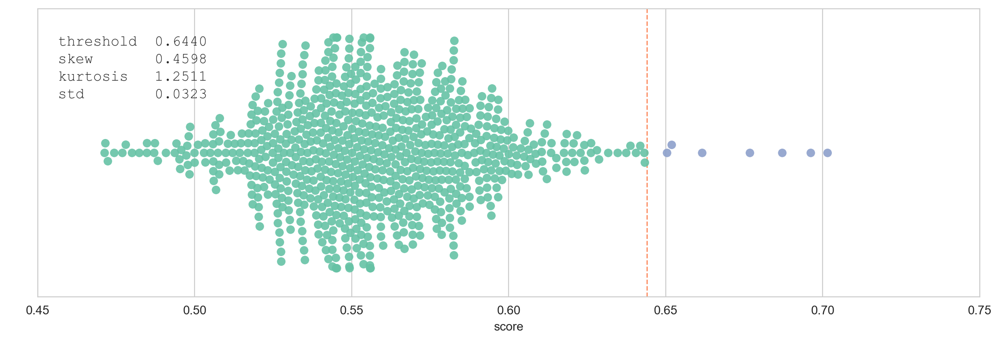

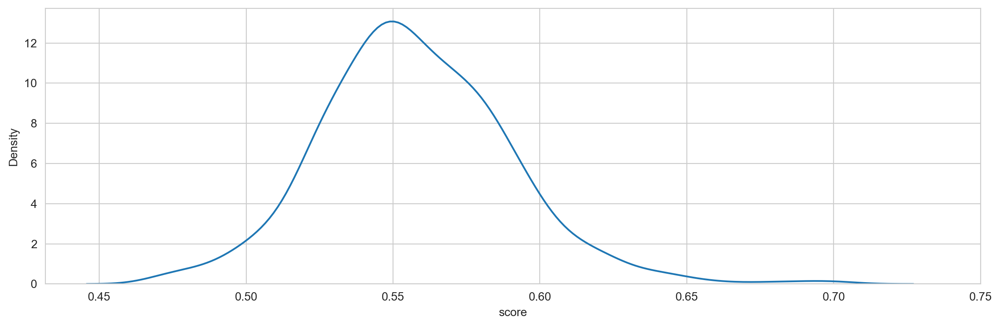

**Article 8**

AMC takes advantage of pandemic to expand presence in one notable city: Tinseltown

One of the casualties of the pandemic was the permanent closing of the ArcLight Cinemas and Pacific Theatres chains. ArcLight Cinemas had 11 locations, including a half-dozen in the Los Angeles area, as well as San Diego; two in Chicago; the Washington, D.C., area; and Boston. Pacific Theatres had six cinemas, all in the L.A. area.

The move flooded the Los Angeles market with more than 400,000 square feet of movie theater real estate — "an opportunity major chains such as Regal, AMC and Cinemark will likely capitalize on as the three make up nearly 70% of the regional cinema market," CBRE Group Inc. noted in a recent report.

Leawood-based AMC Entertainment Holdings Inc. (NYSE: AMC) became one of the first movers when it took over Pacific Theatres' flagship theaters, signing long-term leases for the 30,000-square-foot Grove and 43,412-square-foot Americana at Brand cinemas at the Los Angeles and Glenda

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,35,AMC,AMC,Consumer Services,Movies/Entertainment,"AMC Entertainment Holdings, Inc. (d/b/a AMC Theatres, originally an abbreviation for American Multi-Cinema; often referred to simply as AMC and known in some countries as AMC Cinemas or AMC Multi-Cinemas) is an American movie theater chain headquartered in Leawood, Kansas, and the largest movie theater chain in the world. Founded in 1920, AMC has the largest share of the U.S. theater market ahead of Regal and Cinemark Theatres.",0.720366


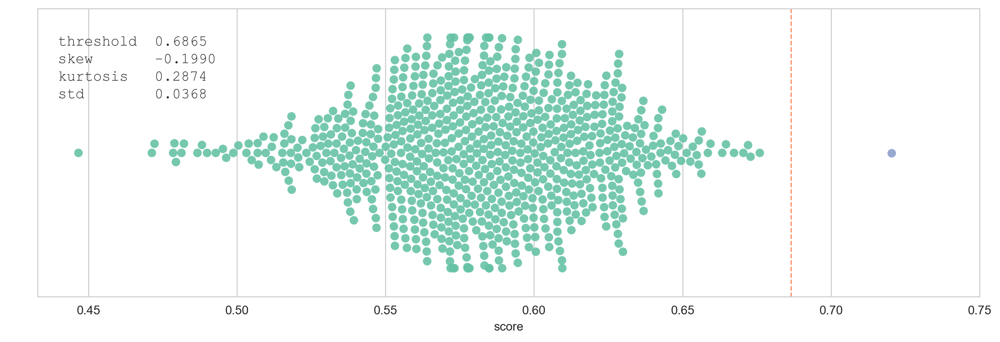

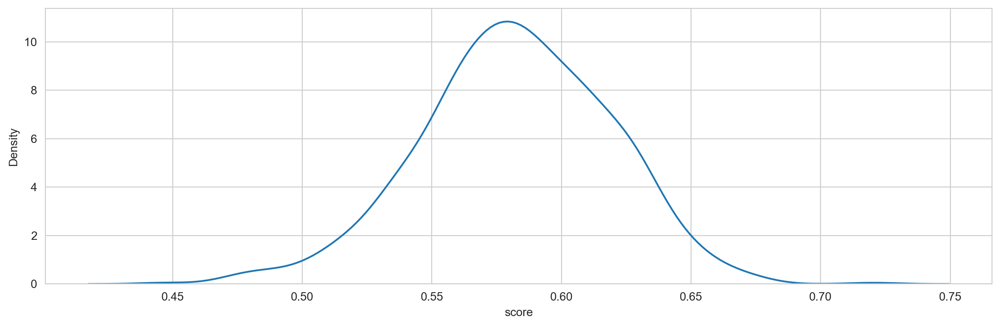

**Article 9**

China: New Oriental closes K-12 subsidiary

New Oriental in China has decided to close down DFUB, its subsidiary focusing on K-12 online education.

Founded in 2016, DFUB is described as New Oriental’s most successful online education service, with over 2 million students registered in its 282 branches. It enabled students in less developed areas to be taught by experienced teachers in Beijing via online platforms.

The company estimates that it will finish issuing refunds and redundancy packages before October, according to a social media post by CEO of DFUB Yu Zhu.

“It’s heartbreaking that I have to leave but nobody can do anything about it,” a former teacher at DFUB told the PIE.

“But I’m glad about the compensation I received.” The teacher had worked at DFUB for a year and she received compensation that equals to two months of her salary.

The announcement comes in the wake of China’s recent national reforms to the tutoring industry, turning existing businesses into nonprofit ent

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,492,New Oriental Education & Tech Group,EDU,Consumer Services,Other Consumer Services,"New Oriental Education & Technology Group Inc. (Chinese: 新东方教育科技集团, NYSE: EDU), more commonly New Oriental (Chinese: 新东方), is a provider of private educational services in China. The headquarters of New Oriental is located in the Haidian district of Beijing. It is currently the largest comprehensive private educational company in China based on the number of program offerings, total student enrollments, and geographic presence. The business of New Oriental includes pre-school education, general courses for students of various age levels, online education, overseas study consulting, and textbook publishing. New Oriental was the first Chinese educational institution to enter the New York Stock Exchange in the United States, holding its IPO in 2006. As of 2016, New Oriental has built 67 short",0.745073
1,674,Tencent Music Entertainment Group,TME,Technology Services,Internet Software/Services,"Tencent Music Entertainment Group (TME; Chinese: 腾讯音乐娱乐集团; pinyin: Téngxùn Yīnyuè Yúlè Jítuán) is a company that develops music streaming services for the Chinese market. Tencent Music's apps include QQ Music, Kugou, , and WeSing; which have more than 800 million active users and 120 million paying subscribers. As of July 2016, Tencent Music's three services held an estimated 56% market share of music streaming services in China.",0.695501
2,662,Tal Education Group,TAL,Consumer Services,Other Consumer Services,"TAL Education Group (Chinese: 好未来) is a Chinese holding company that offers after-school education for students in primary and secondary school. The headquarter is located in Beijing, China. The company was founded in August 2003 by Zhang Bangxin and Cao Yundong. The company offered help to kids who couldn’t go to school during the COVID-19 Pandemic and taught them about mathematics, Chinese, English, Coding and many more subjects.",0.681918


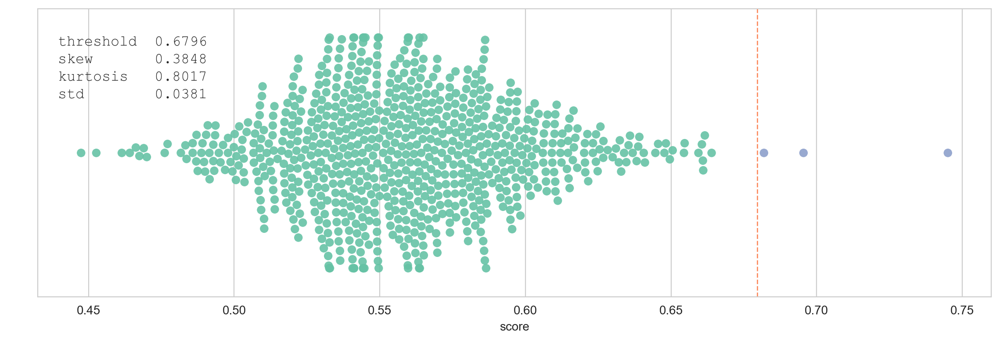

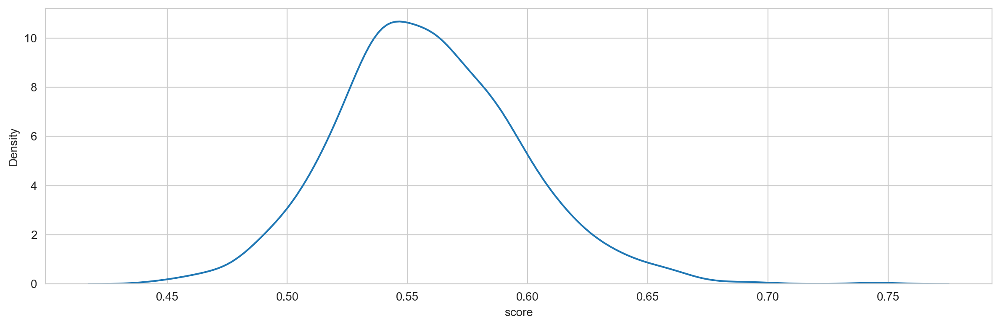

**Article 10**

Fresno County Will Soon Be Home to the Largest Green Hydrogen Plant on the West Coast

A leader in fuel cell solutions, Plug Power recently announced it will build the largest green hydrogen production plant on the West Coast. The state-of-the-art production facility in Fresno County in the Central Valley of California will be powered by renewable energy. Once completed, it will produce 30 metric tons of green hydrogen daily and serve customers up and down the West Coast.

The project also includes the construction of a new wastewater treatment facility that will supply the water needed by the plant and provide recycled water to Mendota, an increasingly water-stressed agricultural hub in Fresno County. 

The California facility will expand Plug Power’s network of plants that already includes sites in New York, Tennessee and Georgia. Combined, they will supply 500 tons of liquid green hydrogen daily by 2025, preventing 4.3 million metric tons of carbon dioxide emissions from entering th

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,566,Proterra,PTRA,Finance,Financial Conglomerates,"Proterra is an American automotive and energy storage company based in Burlingame, California. The company designs and manufactures electric transit buses and electric charging systems. Proterra's Catalyst series includes transit buses ranging from 35 feet (11 m) to 40 feet (12 m) in length and various battery configurations. Buses are charged through an overhead charging station that is placed at maintenance facilities as well as route terminals. Founded in 2004, it became a public company in June 2021 through a business transaction with a Nasdaq-listed special-purpose acquisition company.",0.727933
1,303,FuelCell Energy,FCEL,Electronic Technology,Electronic Equipment/Instruments,"FuelCell Energy, Inc. is an American fuel cell power company. It designs, manufactures, operates and services Direct Fuel Cell power plants (a type of molten carbonate fuel cell) that run on natural gas and biogas. Their power plants are not considered ""hydrogen fuel cells"" because their feedstock is not pure hydrogen and the byproducts of electric generation include carbon dioxide. As one of the biggest publicly traded fuel cell manufacturers in the U.S., the company operates over 50 plants all over the world. It operates the world’s largest fuel cell park, Gyeonggi Green Energy Fuel cell park, which is located in South Korea. The park consists of 21 power plants providing 59 Megawatt of electricity plus district heating to a number of customers in South Korea. It also operates the larges",0.722388
2,631,Southern Company,SO,Utilities,Electric Utilities,"Southern Company is an American gas and electric utility holding company based in the southern United States. It is headquartered in Atlanta, Georgia, with executive offices also located in Birmingham, Alabama. The company is currently the second largest utility company in the U.S. in terms of customer base. Through its subsidiaries it serves 9 million gas and electric utility customers in 6 states. Southern Company's regulated regional electric utilities serve a 120,000-square-mile (310,000 km2) territory with 27,000 miles (43,000 km) of distribution lines.",0.718296
3,513,NRG Energy,NRG,Utilities,Electric Utilities,"NRG Energy, Inc. is a large American energy company, headquartered in Houston, Texas. It was formerly the wholesale arm of Northern States Power Company (NSP), which became Xcel Energy, but became independent in 2000. NRG Energy is involved in energy generation and retail electricity. Their portfolio includes natural gas generation, coal generation, oil generation, nuclear generation, wind generation, utility scale generation, and distributed solar generation. NRG serves 2.9 million retail customers in Texas, Connecticut, Delaware, Illinois, Maryland, Massachusetts, New Jersey, New York, Pennsylvania, Ohio, and the District of Columbia.",0.713760
4,586,Republic Services,RSG,Industrial Services,Environmental Services,"Republic Services, Inc is the second largest provider of non-hazardous solid waste collection, transfer, disposal, recycling, and energy services in the United States, as measured by revenue.",0.707574
5,502,NIO,NIO,Consumer Durables,Motor Vehicles,"NIO (Chinese: 蔚来; pinyin: Wèilái) is a Chinese multinational automobile manufacturer headquartered in Shanghai, specializing in designing and developing electric vehicles. The company is also involved in the FIA Formula E Championship, although NIO has ended funding the team after selling to Lisheng Racing.",0.704572
6,611,Sempra Energy,SRE,Utilities,Gas Distributors,"Sempra is a North American energy infrastructure company based in San Diego, California. Sempra's focus is on electric and natural gas infrastructure. Its operating companies include: Southern California Gas Company (SoCalGas) and San Diego Gas & Electric (SDG&E) in Southern California; Oncor Electric Delivery Company (Oncor) in Texas; Sempra LNG; a

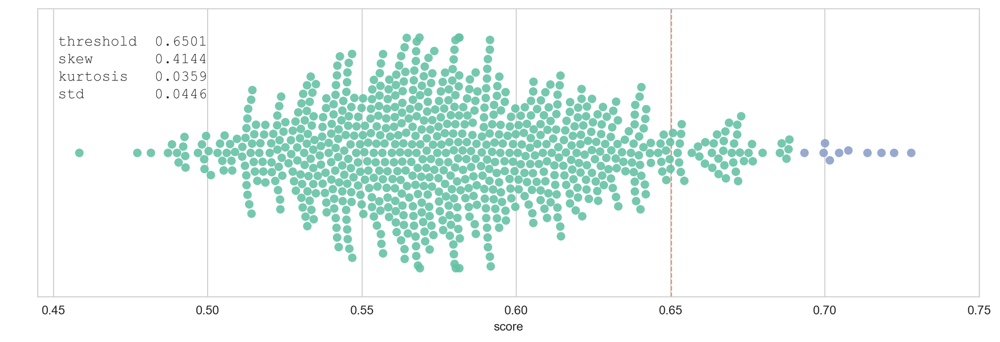

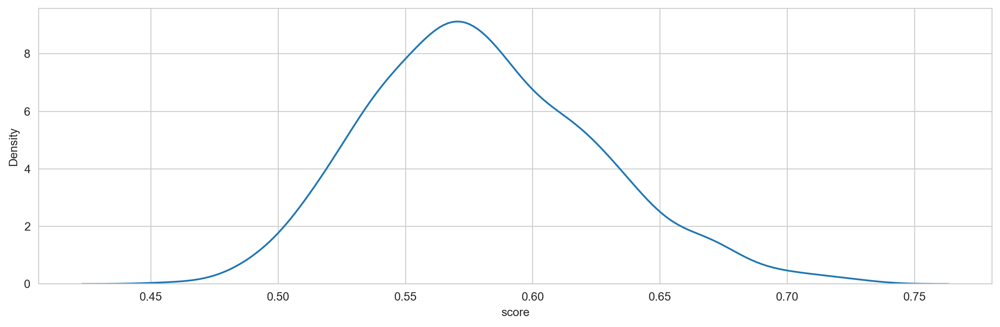

**Article 11**

AMD CEO Sees Chip Shortage Easing in 2022

The semiconductor shortage will begin to ease in 2022, Advanced Micro Devices CEO Lisa Su said at a session Monday at the Code Conference in Beverly Hills.

In an on-stage interview with Code Conference producer Kara Swisher and CNBC tech reporter Jon Fortt, the AMD (ticker: AMD) chief said that the semiconductor industry is investing aggressively in new capacity, with 20 new factories coming online this year and a similar number expected to come online in 2022. 

But Su also noted that the pandemic has “taken demand to a new level,” with every industry seeking more components. “Nobody expected this much demand,” she says.

Su dodged a question about whether AMD was threatened by a shift by some electronics companies to chips designed in house. 

Su also said the company continues to expect to close its pending acquisition of Xilinx (XLNX) by year end. She also said that consolidation in the chip industry is “inevitable.”

Asked about the use 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,11,Advanced Micro Devices,AMD,Electronic Technology,Semiconductors,"Advanced Micro Devices, Inc. (AMD) is an American multinational semiconductor company based in Santa Clara, California, that develops computer processors and related technologies for business and consumer markets. While it initially manufactured its own processors, the company later outsourced its manufacturing, a practice known as going fabless, after GlobalFoundries was spun off in 2009. AMD's main products include microprocessors, motherboard chipsets, embedded processors and graphics processors for servers, workstations, personal computers and embedded system applications.",0.693045
1,430,Li Auto Inc.,LI,Producer Manufacturing,Auto Parts: OEM,"Li Auto Inc., also known as Li Xiang, is a Chinese electric vehicle manufacturer headquartered in Beijing, with manufacturing facilities in Changzhou.",0.688008
2,778,Zscaler,ZS,Technology Services,Packaged Software,"Zscaler (/ˈziːˌskeɪlər/) is an American cloud-based information security company headquartered in San Jose, California. As of August, 2020 the company has a market capitalization of over US$16 billion. The company has more than 150 data centers with customers in 185 countries. A majority of the customers are located in the United States, with most customers having greater than 10,000 employees.",0.676172
3,769,YY,YY,Technology Services,Internet Software/Services,"YY is a major Chinese video-based social network, a subsidiary of . It has over 300 million users. It features a virtual currency which users earn through activities such as karaoke or creating tutorial videos and which is later converted to real cash. Launched in 2005 as duowan.com (Nasdaq: YY), it originally targeted gamers, before broadening to include video streaming and chat features for uses such as concerts, fashion and sports. Users exchange ""virtual roses"" as a form of currency, with top users said to earn as much as $20,000 per month. In November 2012, YY was listed on the NASDAQ.",0.675251
4,610,Seagate Technology,STX,Electronic Technology,Computer Peripherals,"Seagate Technology Holdings plc, an Irish public limited company (commonly referred to as Seagate), is an American data storage company. It was incorporated in 1978 as Shugart Technology and commenced business in 1979. Since 2010, the company has been incorporated in Dublin, Ireland, with operational headquarters in Fremont, California, United States.",0.673174
5,214,Daqo New Energy Corp,DQ,Process Industries,Chemicals: Specialty,"Daqo New Energy Corp. is a Chinese company engaged in the manufacture of monocrystalline silicon (mono-Si) and polysilicon (poly-Si), primarily for use in solar photovoltaic systems. The company operates a mono-Si and poly-Si manufacturing facility located in Shihezi, Xinjiang Province, China. Daqo formerly manufactured silicon wafers at a facility in Chongqing, China (discontinued in 2018) and photovoltaic modules at a facility in Nanjing, China (discontinued in 2012). The company is reportedly tied to the use of forced labor in Xinjiang.",0.671857
6,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.664996
7,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design co

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
11,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processors found in most personal computers (PCs). Incorporated in Delaware, Intel ranked No. 45 in the 2020 Fortune 500 list of the largest United States corporations by total revenue during nearly a decade, from 2007 to 2016 fiscal years.",0.651588
12,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.650746
31,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.631310
181,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.591947


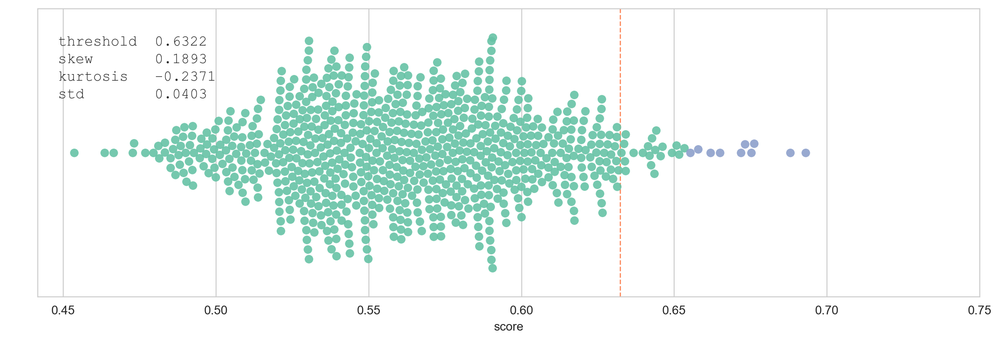

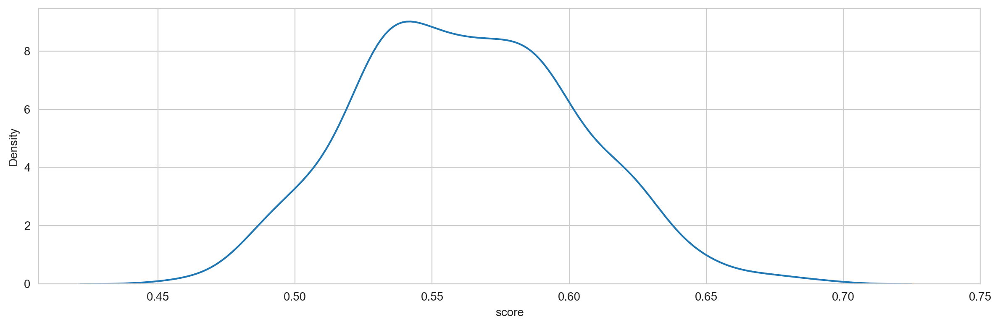

**Article 12**

New Benchmark Leak Reveals Impressive Performance Of Intel's 12900K, 12700K And 12600K Alder Lake Processors

Benchmarks have leaked supposedly revealing the performance of Intel's Core i9-12900K, Core i7-12700K and Core i5-12600K Alder Lake CPUs, courtesy of www.cpu-monkey.com.

The new results show both single-threaded and multi-threaded scores in Cinebench R20 and give Intel a clear lead over all of AMD's current mainstream desktop CPUs.

Below you can see my own recent benchmark results from my reviews of Intel's 111th Gen CPUs such as the Core i9-11900K in Cinebench R20 along with the leaked results for the Core i5-12600K, Core i7-12700K and Core i9-12900K Alder Lake CPUs. 

[Figure detailing a few of Intel CPUs specifications]

[Figure detailing Intel CPUs and competing CPUs performances on Cinebench R20 Single-threaded benchmark]

The Core i9-12900K's result of 817 in the single-threaded testis miles ahead of AMD's Ryzen 9 5950X - it's best result, and the latter is even bettere

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.752162
1,11,Advanced Micro Devices,AMD,Electronic Technology,Semiconductors,"Advanced Micro Devices, Inc. (AMD) is an American multinational semiconductor company based in Santa Clara, California, that develops computer processors and related technologies for business and consumer markets. While it initially manufactured its own processors, the company later outsourced its manufacturing, a practice known as going fabless, after GlobalFoundries was spun off in 2009. AMD's main products include microprocessors, motherboard chipsets, embedded processors and graphics processors for servers, workstations, personal computers and embedded system applications.",0.742016
2,610,Seagate Technology,STX,Electronic Technology,Computer Peripherals,"Seagate Technology Holdings plc, an Irish public limited company (commonly referred to as Seagate), is an American data storage company. It was incorporated in 1978 as Shugart Technology and commenced business in 1979. Since 2010, the company has been incorporated in Dublin, Ireland, with operational headquarters in Fremont, California, United States.",0.705008
3,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processors found in most personal computers (PCs). Incorporated in Delaware, Intel ranked No. 45 in the 2020 Fortune 500 list of the largest United States corporations by total revenue during nearly a decade, from 2007 to 2016 fiscal years.",0.701949
4,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.693007
5,322,GoPro,GPRO,Consumer Durables,Electronics/Appliances,"GoPro, Inc. (marketed as GoPro and sometimes stylized as GoPRO) is an American technology company founded in 2002 by Nick Woodman. It manufactures action cameras and develops its own mobile apps and video-editing software. Founded as Woodman Labs, Inc, the company eventually focused on the connected sports genre, developing its line of action cameras and, later, video editing software. It is based in San Mateo, California.",0.687383
6,66,Arista Networks,ANET,Electronic Technology,Computer Communications,"Arista Networks (formerly Arastra) is an American computer networking company headquartered in Santa Clara, California. The company designs and sells multilayer network switches to deliver software-defined networking (SDN) solutions for large datacenter, cloud computing, high-performa

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
13,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.666523
21,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.660652
104,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.607551


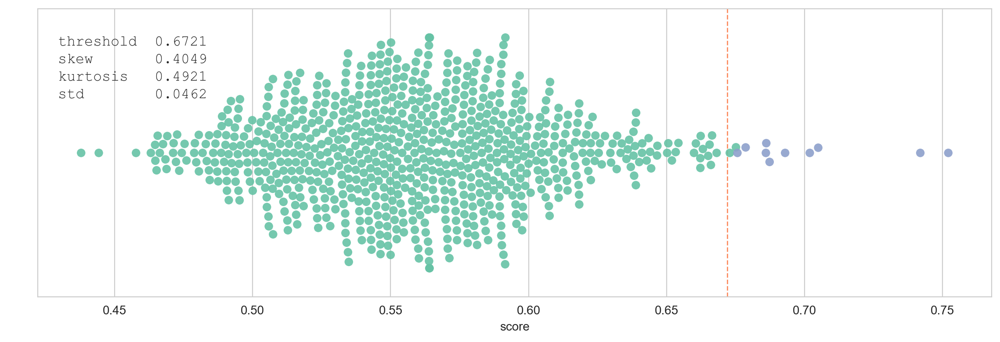

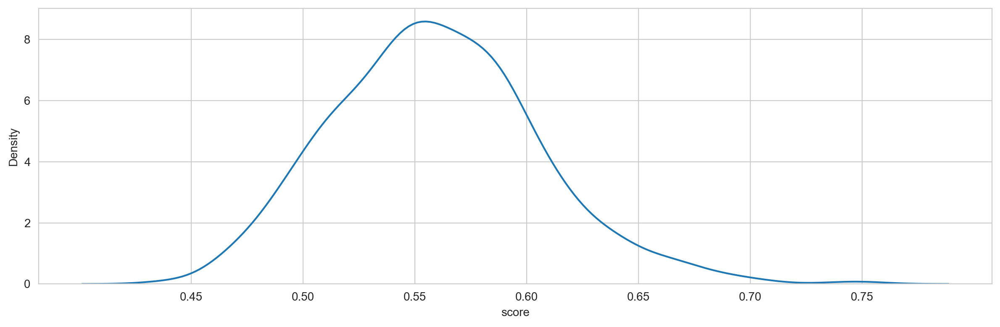

**Article 13**

Micron Correction Slowly Coming to an End

Micron Technology Inc. (MU) reports Q4 2021 earnings after Tuesday’s closing bell, with analysts looking for a profit of $2.34 per-share on $8.21 billion in revenue. If met, earnings-per-share (EPS) will more than double the profit posted in the same quarter last year. The stock sold off 5.7% after beating Q3 estimates and raising Q4 EPS guidance in late June and fell another 14% into August before bouncing a few points into this week. It’s booked a negative 1% 2021 return-to-date after gaining nearly 40% last year.

Headwinds Could Persist into 2022

The company has been plagued by supply disruptions, like other semiconductor manufacturers, compounded by weakness in DRAM memory pricing. Well-known hedge funds have taken notice during the quarter, reducing or closing positions at funds run by George Soros, Stanley Druckenmiller, and David Tepper. Worse yet, Micron continues to underperform other chip stocks by a country mile, dropping 14% in t

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,273,Evercore,EVR,Finance,Investment Banks/Brokers,"Evercore Inc., formerly known as Evercore Partners, is a global independent investment banking advisory firm founded in 1995 by Roger Altman, David Offensend, and Austin Beutner. Evercore's Investment Banking business advises its clients on mergers and acquisitions, divestitures, restructurings, financings, public offerings, private placements and other strategic transactions and also provides institutional investors with macro and fundamental equity research, sales and trading execution. Evercore's Investment Management business comprises wealth management, institutional asset management and private equity investing. Evercore serves clients from 28 offices in North America, Europe, South America and Asia. Since 1995, the firm has advised on more than $3 trillion of merger, acquisition, re",0.690929
1,385,Invesco,IVZ,Finance,Investment Managers,"Invesco Ltd. is an American independent investment management company that is headquartered in Atlanta, Georgia, United States, and has branch offices in 20 countries. Its common stock is a constituent of the S&P 500 and trades on the New York stock exchange. Invesco operates under the Invesco, , Invesco Perpetual, WL Ross & Co and Powershares brand names.",0.687399
2,413,KKR & Co,KKR,Finance,Investment Managers,"KKR & Co. Inc. (formerly known as Kohlberg Kravis Roberts & Co. and KKR & Co. L.P.) is an American global investment company that manages multiple alternative asset classes, including private equity, energy, infrastructure, real estate, credit, and, through its strategic partners, hedge funds. The firm has completed more than 280 private equity investments in portfolio companies with approximately $545 billion of total enterprise value as of June 30, 2017. As of September 30, 2017, Assets Under Management (""AUM"") and Fee Paying Assets Under Management (""FPAUM"") were $153 billion and $114 billion, respectively.",0.676624
3,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.675531
4,430,Li Auto Inc.,LI,Producer Manufacturing,Auto Parts: OEM,"Li Auto Inc., also known as Li Xiang, is a Chinese electric vehicle manufacturer headquartered in Beijing, with manufacturing facilities in Changzhou.",0.674100
5,610,Seagate Technology,STX,Electronic Technology,Computer Peripherals,"Seagate Technology Holdings plc, an Irish public limited company (commonly referred to as Seagate), is an American data storage company. It was incorporated in 1978 as Shugart Technology and commenced business in 1979. Since 2010, the company has been incorporated in Dublin, Ireland, with operational headquarters in Fremont, California, United States.",0.673845
6,53,Ansys,ANSS,Technology Services,Packaged Software,"Ansys, Inc. is an American company based in Canonsburg, Pennsylvania. It develops and markets CAD/CAM and multiphysics engineering simulation software for product design, testing and operation and offers its products and services to customers worldwide. Ansys was founded in 1970 by John Swanson who sold his interest in the company to venture capitalists in 1993. Ansys went public on NASDAQ in 1996. In the 2000s, the company acquired numerous other engineering design companies, obtaining additional technology for fluid dynamics, electronics design, and physics analysis. Ansys became a component of the NASDAQ-100 index on December 23, 2019.",0.673210
7,747,Western Digital,WDC,Electronic Technology,Computer Peripherals,"Western Digital Corporation (WDC, commonly known as

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
39,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.646491
71,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processors found in most personal computers (PCs). Incorporated in Delaware, Intel ranked No. 45 in the 2020 Fortune 500 list of the largest United States corporations by total revenue during nearly a decade, from 2007 to 2016 fiscal years.",0.637686
106,11,Advanced Micro Devices,AMD,Electronic Technology,Semiconductors,"Advanced Micro Devices, Inc. (AMD) is an American multinational semiconductor company based in Santa Clara, California, that develops computer processors and related technologies for business and consumer markets. While it initially manufactured its own processors, the company later outsourced its manufacturing, a practice known as going fabless, after GlobalFoundries was spun off in 2009. AMD's main products include microprocessors, motherboard chipsets, embedded processors and graphics processors for servers, workstations, personal computers and embedded system applications.",0.630047
324,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.599532


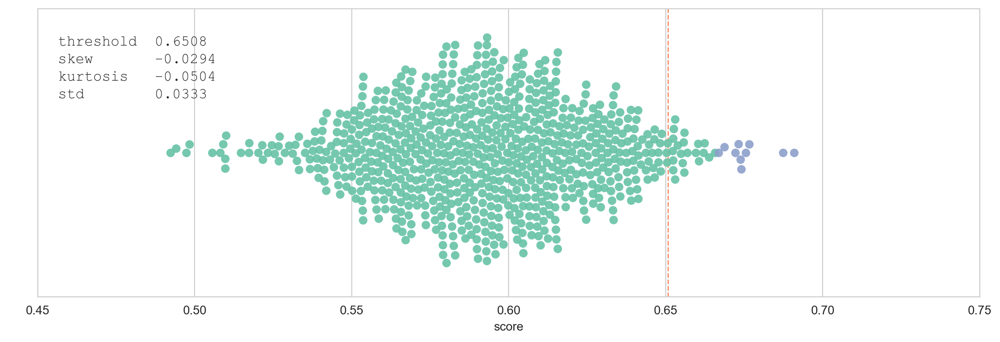

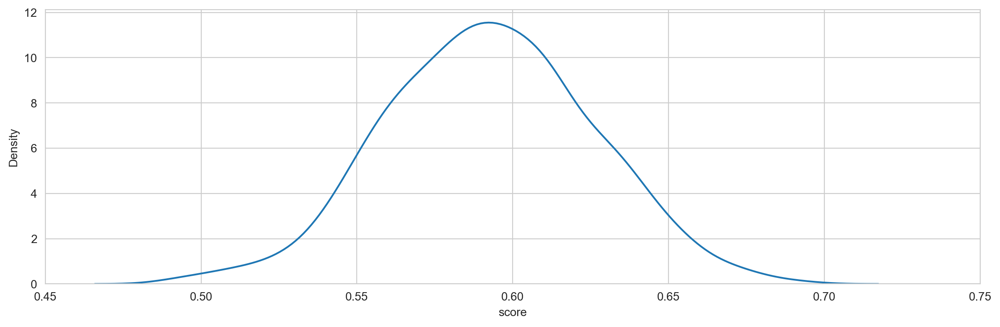

**Article 14**

Why Nvidia Investors Are Nervous Today

What happened

Product shortages are generally bad for business -- unless you're in the business of making the product that's in short supply. It's for this reason that shares of semiconductor manufacturer Nvidia (NASDAQ:NVDA) -- a supplier of chips for everything from playing video games to mining cryptocurrency to performing artificial intelligence tasks -- have benefited so much from the global semiconductor shortage over the past couple of years, more than doubling in 2020 and gaining another 65% so far this year. But all good things must come to an end. As of 11:29 a.m. EDT today, shares were down 2.22%.

And Elon Musk says this semiconductor shortage will end as well.

So what

As Reuters reports, the CEO of electric car company Tesla (NASDAQ:TSLA) characterized the shortage that's been strangling production of automobiles this year as "short term I think," when speaking on a panel Friday during Italian Tech Week.  

Chipmakers are building

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.719653
1,11,Advanced Micro Devices,AMD,Electronic Technology,Semiconductors,"Advanced Micro Devices, Inc. (AMD) is an American multinational semiconductor company based in Santa Clara, California, that develops computer processors and related technologies for business and consumer markets. While it initially manufactured its own processors, the company later outsourced its manufacturing, a practice known as going fabless, after GlobalFoundries was spun off in 2009. AMD's main products include microprocessors, motherboard chipsets, embedded processors and graphics processors for servers, workstations, personal computers and embedded system applications.",0.697524
2,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.692596
3,778,Zscaler,ZS,Technology Services,Packaged Software,"Zscaler (/ˈziːˌskeɪlər/) is an American cloud-based information security company headquartered in San Jose, California. As of August, 2020 the company has a market capitalization of over US$16 billion. The company has more than 150 data centers with customers in 185 countries. A majority of the customers are located in the United States, with most customers having greater than 10,000 employees.",0.674621
4,763,Xpeng,XPEV,Consumer Durables,Motor Vehicles,"Xpeng or Xiaopeng Motors (Chinese: 小鹏汽车), also known as XMotors.ai, is a Chinese electric vehicle manufacturer. The company is headquartered in Guangzhou, with offices in Mountain View, California in the US and is publicly traded on the New York Stock Exchange.",0.674568
5,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.672291
6,465,Microchip Technology,MCHP,Electronic Technology,Semiconductors,"Microchip Technology Inc. is a publicly-listed American corporation that manufactures microcontroller, mixed-signal, analog and Flash-IP integrated circuits. Its products include microcontrollers (PIC, dsPIC, AVR and SAM), Serial EEPROM devices, Serial SRAM devices, embedded security devices, radio frequency (RF) devices, thermal, power and battery management analog dev

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
8,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processors found in most personal computers (PCs). Incorporated in Delaware, Intel ranked No. 45 in the 2020 Fortune 500 list of the largest United States corporations by total revenue during nearly a decade, from 2007 to 2016 fiscal years.",0.666380
9,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.665728
34,676,Tesla,TSLA,Consumer Durables,Motor Vehicles,"Tesla, Inc. is an American electric vehicle, clean energy, and technology company based in Palo Alto, California, United States. Tesla designs and manufactures electric cars, battery energy storage from home to grid-scale, solar panels and solar roof tiles, and related products and services. In 2020, Tesla had the most sales of battery electric vehicles and plug-in electric vehicles, capturing 16% of the plug-in market (which includes plug-in hybrids) and 23% of the battery-electric (purely electric) market. Through its subsidiary Tesla Energy, the company develops and is a major installer of photovoltaic systems in the United States. Tesla Energy is also one of the largest global suppliers of battery energy storage systems, with 3 gigawatt-hours (GWh) installed in 2020.",0.648456
190,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.609389


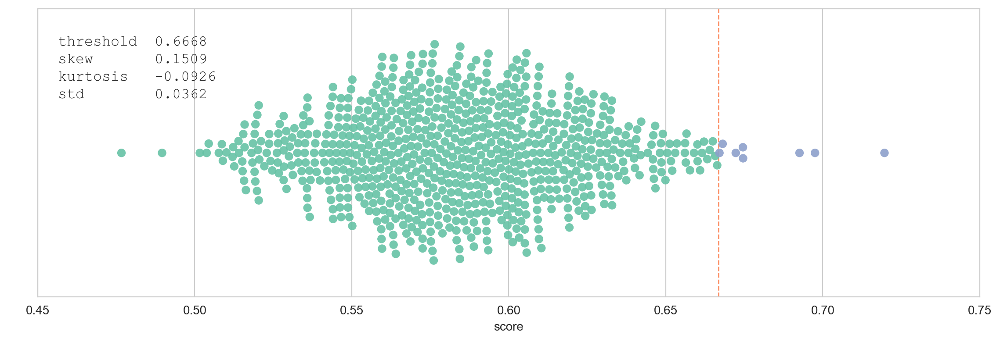

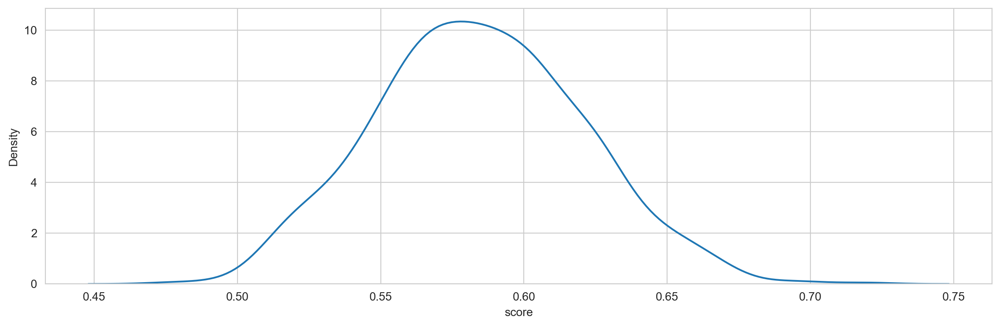

**Article 15**

Can India’s proposed semiconductor deal with Taiwan be a gamechanger?

The whole process is likely to take years before it starts functioning

Moore's Law states that the number of transistors on a microchip will double every two years, even while costs go down. Mister Moore, God bless him, surely may not have accounted for COVID-19, developments in artificial intelligence and the perfect storm of it all coming together, leading to a global shortage of semiconductors threatening industries from automobiles to smartphones and consumer electronics.

Moore's Law will also be put to test as India doubles down on closing a reported deal with Taiwan, the big daddy in the semiconductor scene. The deal, worth Rs 55,000 crore in today's dollar value, envisages a big-scale chip production facility with Taiwanese technology in the sub continent. The larger trade deal (that will, of course, make big bro Beijing see red) in the offing could see duty cuts on components and other raw materials. A meg

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.716129
1,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.712628
2,747,Western Digital,WDC,Electronic Technology,Computer Peripherals,"Western Digital Corporation (WDC, commonly known as Western Digital or WD) is an American computer hard disk drive manufacturer and data storage company, headquartered in San Jose, California. It designs, manufactures and sells data technology products, including storage devices, data center systems and cloud storage services.",0.691618
3,652,SunPower,SPWR,Producer Manufacturing,Electrical Products,SunPower Corporation (NASDAQ:SPWR) is an American company specializing in solar power generation and energy storage.,0.689248
4,465,Microchip Technology,MCHP,Electronic Technology,Semiconductors,"Microchip Technology Inc. is a publicly-listed American corporation that manufactures microcontroller, mixed-signal, analog and Flash-IP integrated circuits. Its products include microcontrollers (PIC, dsPIC, AVR and SAM), Serial EEPROM devices, Serial SRAM devices, embedded security devices, radio frequency (RF) devices, thermal, power and battery management analog devices, as well as linear, interface and wireless products.",0.686847
5,678,Texas Instruments,TXN,Electronic Technology,Semiconductors,"Texas Instruments Incorporated (TI) is an American technology company headquartered in Dallas, Texas, that designs and manufactures semiconductors and various integrated circuits, which it sells to electronics designers and manufacturers globally. It is one of the top 10 semiconductor companies worldwide based on sales volume. The company's focus is on developing analog chips and embedded processors, which account for more than 80% of its revenue. TI also produces TI digital light processing technology and education technology products including calculators, microcontrollers and multi-core processors. The company holds 45,000 patents worldwide as of 2016.",0.686836
6,128,Cadence Design Systems,CDNS,Technology Services,Packaged Software,"Cadence Design Systems, Inc. (stylized as cādence), headquartered in San Jose, California, is an American multinational computational software company, founded in 1988 by the merger of SDA Systems and ECAD, Inc. The company produces software, hardware and silicon structures for designing integrated circuits, systems on chips (SoCs) and printed circuit boards.",0.684435
7,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processors found in most personal computers (PCs). Incorporated in Delaware, Intel ranked No. 45 in the 2020 Fortune 500 list of the largest

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
38,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.651878
50,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.644090
78,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.634286


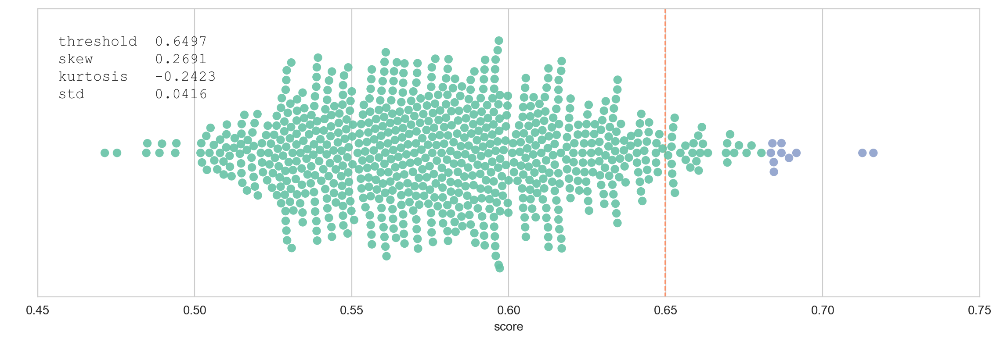

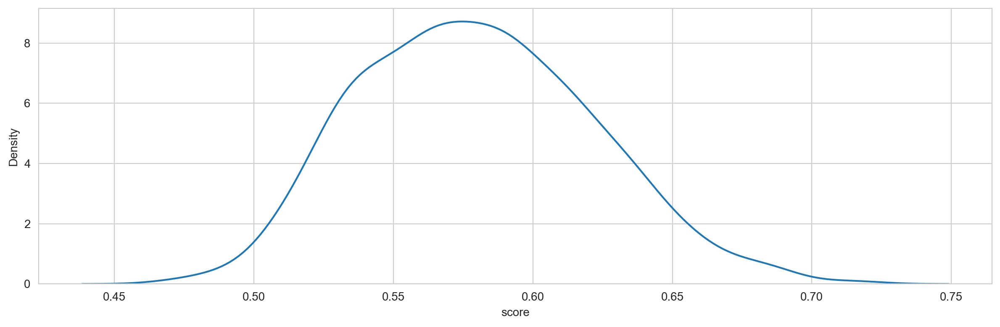

**Article 16**

Taiwan Semiconductor Is A Chip Manufacturing Giant That Should Be On Investors' Radar

Summary
1. Taiwan Semiconductor is the world's biggest chip foundry, manufacturing semiconductors that are used in a wide range of devices.
2. The company currently has a technological advantage, but there is a risk that competitors like Samsung and Intel could catch up.
3. Shares are no longer cheap, with the market apparently re-rating the company from a cyclical company to a growth company.

Taiwan Semiconductor (TSM) is the world's biggest chip foundry, manufacturing semiconductors that are used in a wide range of devices. As its name implies, the company is based out of Taiwan, and it is a significant component of many emerging market ETFs such as the iShares Core MSCI Emerging Markets ETF (IEMG) and the iShares MSCI Emerging Markets ETF (EEM).

Looking at the past few years both the share price and revenues have increased significantly.

[TSM stock chart]

This has led to a re-rating of the com

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.749277
1,747,Western Digital,WDC,Electronic Technology,Computer Peripherals,"Western Digital Corporation (WDC, commonly known as Western Digital or WD) is an American computer hard disk drive manufacturer and data storage company, headquartered in San Jose, California. It designs, manufactures and sells data technology products, including storage devices, data center systems and cloud storage services.",0.745151
2,11,Advanced Micro Devices,AMD,Electronic Technology,Semiconductors,"Advanced Micro Devices, Inc. (AMD) is an American multinational semiconductor company based in Santa Clara, California, that develops computer processors and related technologies for business and consumer markets. While it initially manufactured its own processors, the company later outsourced its manufacturing, a practice known as going fabless, after GlobalFoundries was spun off in 2009. AMD's main products include microprocessors, motherboard chipsets, embedded processors and graphics processors for servers, workstations, personal computers and embedded system applications.",0.741810
3,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.739192
4,610,Seagate Technology,STX,Electronic Technology,Computer Peripherals,"Seagate Technology Holdings plc, an Irish public limited company (commonly referred to as Seagate), is an American data storage company. It was incorporated in 1978 as Shugart Technology and commenced business in 1979. Since 2010, the company has been incorporated in Dublin, Ireland, with operational headquarters in Fremont, California, United States.",0.733944
5,465,Microchip Technology,MCHP,Electronic Technology,Semiconductors,"Microchip Technology Inc. is a publicly-listed American corporation that manufactures microcontroller, mixed-signal, analog and Flash-IP integrated circuits. Its products include microcontrollers (PIC, dsPIC, AVR and SAM), Serial EEPROM devices, Serial SRAM devices, embedded security devices, radio frequency (RF) devices, thermal, power and battery management analog devices, as well as linear, interface and wireless products.",0.730171
6,448,Marvell Technology,MRVL,Electronic Technology,Semiconductors,None,0.718364
7,763,Xpeng,XPEV,Consumer Durables,Motor Vehicles,"Xpeng or Xiaopeng Motors (Chinese: 小鹏汽车), also known as XMotors.ai, is a Chinese electric vehicle manufacturer. The company is headquartered in Guangzhou, with offices in Mountain View, California in the US and is publicly traded on the New York Stock Exchange.",0.717368
8,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processor

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
19,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.700590
32,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.684946
120,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.656707


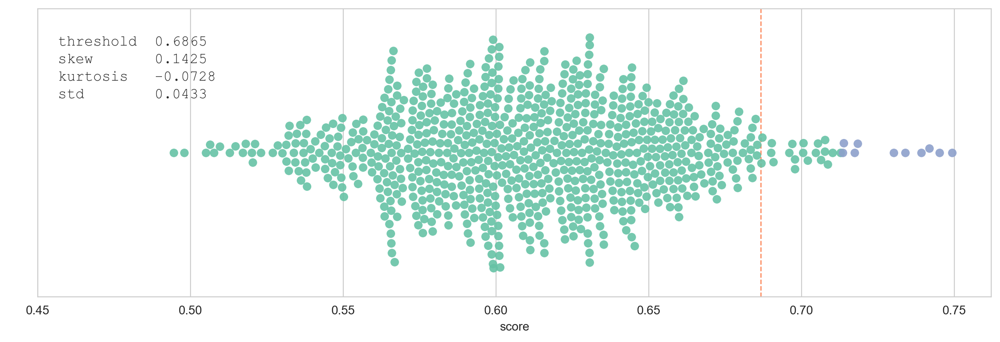

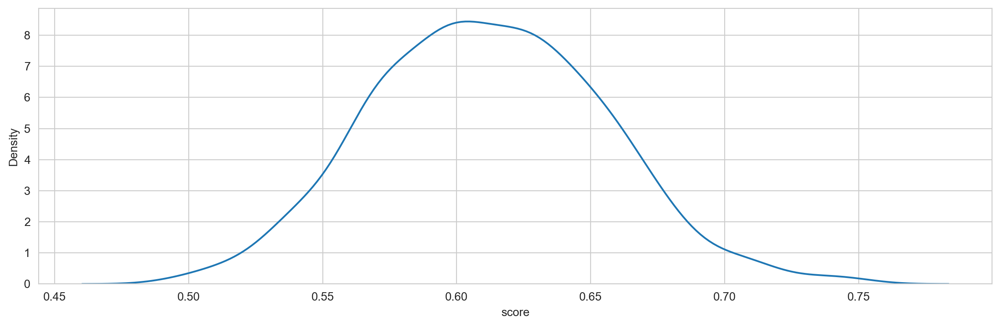

**Article 17**

In a huge blow, judge rules Apple can't force developers to exclusively use its App Store payment system

(CNN Business) Apple can no longer prohibit app developers from directing users to payment options outside its App Store, a judge ruled on Friday. The decision, which followed a contentious court battle with the maker of the hugely popular Fortnite video game, is a major blow to Apple — but the company also scored a partial victory as the judge stopped short of calling it a monopoly.

Judge Yvonne Gonzalez Rogers of the US District Court in the Northern District of California ruled on Friday that Apple (AAPL) had violated California's Unfair Competition Law by forcing Fortnite and its maker Epic Games to use Apple's payment systems on the App Store, with the iPhone maker extracting a 30% commission on every in-app purchase in the process. She issued an injunction saying Apple can no longer prohibit developers from adding links within their apps to outside payment options; for examp

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,779,Zynga,ZNGA,Technology Services,Internet Software/Services,"Zynga Inc. /ˈzɪŋɡə/ is an American social game developer running social video game services and founded in April 2007 with headquarters in San Francisco, California, United States. The company primarily focuses on mobile and social networking platforms. Zynga states its mission as ""connecting the world through games."" In June 2020, Zynga announced that it will buy Turkish developer Peak for $1.8 billion in its biggest ever acquisition. As of February 2021, Zynga is currently working on a free game for mobile devices and Nintendo Switch titled Star Wars Hunters.",0.699213
1,572,Qualcomm,QCOM,Electronic Technology,Telecommunications Equipment,"Qualcomm (/ˈkwɒlkɒm/) is an American multinational corporation headquartered in San Diego, California, and incorporated in Delaware. It creates semiconductors, software, and services related to wireless technology. It owns patents critical to the 5G, 4G, CDMA2000, TD-SCDMA and WCDMA mobile communications standards. Over the years, Qualcomm has expanded into selling semiconductor products in a predominantly fabless manufacturing model. It also developed semiconductor components or software for vehicles, watches, laptops, wi-fi, smartphones, and other devices.",0.697957
2,8,Activision Blizzard,ATVI,Consumer Durables,Recreational Products,"Activision Blizzard, Inc. is an American video game holding company based in Santa Monica, California. The company was founded in July 2008 through the merger of Activision, Inc. (the publicly traded parent company of Activision Publishing) and Vivendi Games. The company is traded on the NASDAQ stock exchange under the ticker symbol ATVI, and since 2015 has been one of the stocks that make up the S&P 500. Activision Blizzard currently includes five business units: Activision Publishing, Blizzard Entertainment, King, Major League Gaming, and Activision Blizzard Studios.",0.692776
3,280,Facebook,FB,Technology Services,Internet Software/Services,"Facebook, Inc., is an American multinational technology company based in Menlo Park, California. It was founded in 2004 as TheFacebook by Mark Zuckerberg, Eduardo Saverin, Andrew McCollum, Dustin Moskovitz, and Chris Hughes, roommates and students at Harvard College. The namesake social networking service eventually became Facebook, amassing 2.9 billion monthly users by 2021. The company acquired Instagram in 2012, then WhatsApp and Oculus in 2014. It is one of the world's most valuable companies and is considered one of the Big Five companies in U.S. information technology, alongside Google, Apple, Microsoft and Amazon. The company generates substantially all of its revenue by selling advertisement placements to marketers.",0.691665
4,637,Spotify,SPOT,Technology Services,Internet Software/Services,"Spotify (/ˈspɒtɪfaɪ/; Swedish: [ˈspɔ̂tːɪfaj]) is a Swedish audio streaming and media services provider founded on 23 April 2006 by Daniel Ek and Martin Lorentzon. It is the world's largest music streaming service provider, with over 365 million monthly active users, including 165 million paying subscribers, as of June 2021. Spotify is listed (through a Luxembourg City-domiciled holding company, Spotify Technology S.A.) on the New York Stock Exchange in the form of American depositary receipts.",0.690026
5,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.6

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
10,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.678329
24,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processors found in most personal computers (PCs). Incorporated in Delaware, Intel ranked No. 45 in the 2020 Fortune 500 list of the largest United States corporations by total revenue during nearly a decade, from 2007 to 2016 fiscal years.",0.661587
47,11,Advanced Micro Devices,AMD,Electronic Technology,Semiconductors,"Advanced Micro Devices, Inc. (AMD) is an American multinational semiconductor company based in Santa Clara, California, that develops computer processors and related technologies for business and consumer markets. While it initially manufactured its own processors, the company later outsourced its manufacturing, a practice known as going fabless, after GlobalFoundries was spun off in 2009. AMD's main products include microprocessors, motherboard chipsets, embedded processors and graphics processors for servers, workstations, personal computers and embedded system applications.",0.643101
102,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.620719
120,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.615681


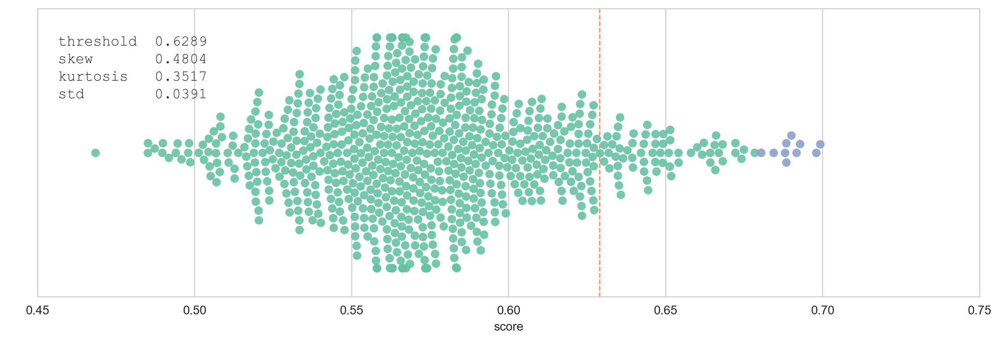

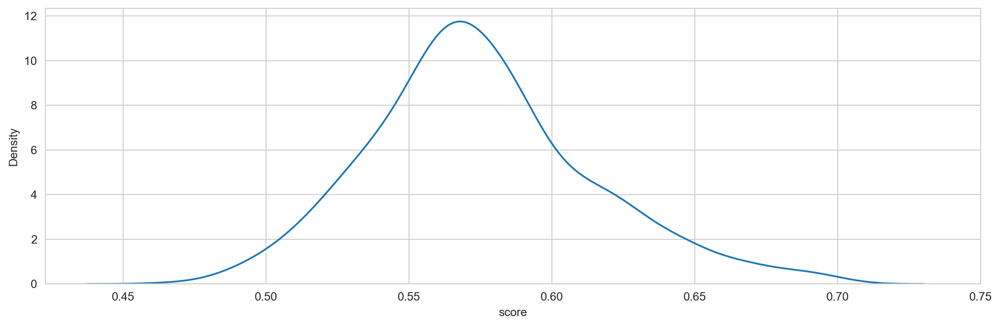

**Article 18**

Brits line up for gas as BP closes some service stations

London (CNN Business) - British drivers are being urged not to panic buy gasoline after a shortage of truck drivers forced BP to temporarily close some of its UK service stations.

The Automobile Association (AA) appealed for calm on Friday as drivers in some parts of the United Kingdom flocked to gas stations.

"There is no shortage of fuel and thousands of [stations] are operating normally with just a few suffering temporary supply chain problems," AA President Edmund King told CNN Business. He warned drivers against filling up "outside their normal routines" as "even if the occasional petrol station is temporarily closed, others just down the road will be open."

Yet some Brits paid little heed as the weekend approached, with Shell warning of long lines at stations.

"We are seeing an increased demand today for fuel at some of our stations, which may in some instances result in larger queues. We are adapting our delivery sche

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,717,Valero,VLO,Energy Minerals,Oil Refining/Marketing,"Valero Energy Corporation is a Fortune 500 international manufacturer and marketer of transportation fuels, other petrochemical products, and power. It is headquartered in San Antonio, Texas, United States. Throughout the United States and Canada, the company owns and operates 15 refineries, and one in Wales, with a combined throughput capacity of approximately 3 million barrels (480,000 m3) per day, 11 ethanol plants with a combined production capacity of 1.2 billion US gallons (4,500,000 m3) per year, and a 50-megawatt wind farm. Before the 2013 spinoff of CST Brands, Valero was one of the United States' largest retail operators with approximately 6,800 retail and branded wholesale outlets in the United States, Canada, United Kingdom, and the Caribbean under the Valero, Diamond Shamrock,",0.692450
1,268,Equinor,EQNR,Energy Minerals,Integrated Oil,"Equinor ASA (formerly Statoil and StatoilHydro) is a Norwegian state-owned multinational energy company headquartered in Stavanger. It is primarily a petroleum company, operating in 36 countries with additional investments in renewable energy. In the 2020 Forbes Global 2000, Equinor was ranked as the 169th-largest public company in the world. The company has about 20,200 employees.",0.686726
2,414,Knight-Swift Transportation Holdings,KNX,Transportation,Trucking,"Knight-Swift Transportation Holdings Inc. (referred to as Knight-Swift) is a publicly traded, American, truckload motor shipping carrier based in Phoenix, Arizona. It is the fifth largest trucking company in the United States.",0.674295
3,254,Element Solutions,ESI,Process Industries,Chemicals: Major Diversified,Element Solutions Inc (formerly Platform Specialty Products Corporation) is a specialty chemicals production corporation listed on the New York Stock Exchange.,0.666645
4,483,National Oilwell Varco,NOV,Industrial Services,Oilfield Services/Equipment,"NOV Inc. is an American multinational corporation based in Houston, Texas. It is a leading worldwide provider of equipment and components used in oil and gas drilling and production operations, oilfield services, and supply chain integration services to the upstream oil and gas industry. The company conducts operations in more than 600 locations across six continents, operating through three reporting segments: Rig Technologies, Wellbore Technologies, and Completion & Production Solutions.",0.666271
5,294,FleetCor Technologies,FLT,Commercial Services,Miscellaneous Commercial Services,"FleetCor Technologies, Inc. or FLEETCOR provides fuel cards and workforce payment products and services. Their customers include businesses, commercial fleets, oil companies, petroleum marketers and government in America, Netherlands, Belgium, Germany, Slovakia and various countries. The company provides services through two segments: North American and International segments. FLEETCOR's predecessor company was founded in the United States in 1986. In March 2020, FleetCor was named one of the 2020 Top 40 Innovative Tech Companies in Georgia by The Technology Association of Georgia.",0.665474
6,444,Marathon Petroleum,MPC,Energy Minerals,Oil Refining/Marketing,"Marathon Petroleum Corporation is an American petroleum refining, marketing, and transportation company headquartered in Findlay, Ohio. The company was a wholly owned subsidiary of Marathon Oil until a corporate spin-off in 2011.",0.665094
7,115,BP plc,BP,Energy Minerals,Integrated Oil,"BP plc (official styling BP p.l.c., formerly The British Petroleum Company plc and BP Amoco plc) is a British multinational oil and gas company headquartered in London, England. It is one of the world's seven oil and gas ""supermajors"". It is a vertically integrated company operating in all areas of the oil and gas industry, including exploration and production, refining, distribution and marketing, power generation, and trading. It al

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
44,548,Petroleo Brasileiro S.A.,PBR,Energy Minerals,Integrated Oil,"Petróleo Brasileiro S.A., better known by the acronym Petrobras (Portuguese pronunciation: [ˌpɛtɾoˈbɾas ]), is a state-owned Brazilian multinational corporation in the petroleum industry headquartered in Rio de Janeiro, Brazil. The company's name translates to Brazilian Petroleum Corporation — Petrobras.The company was ranked #120 in the most recent Fortune Global 500 list. In the 2020 Forbes Global 2000, Petrobras was ranked as the 70th -largest public company in the world.",0.636226
58,158,Chevron,CVX,Energy Minerals,Integrated Oil,"Chevron Corporation is an American multinational energy corporation. It was founded in 1984 and is the third largest oil company in America. One of the successor companies of Standard Oil, it is headquartered in San Ramon, California, and active in more than 180 countries. Chevron is engaged in every aspect of the oil and natural gas industries, including hydrocarbon exploration and production; refining, marketing and transport; chemicals manufacturing and sales; and power generation. Chevron is one of the world's largest companies; as of March 2020, it ranked fifteenth in the Fortune 500 with a yearly revenue of $146.5 billion and market valuation of $136 billion. In the 2020 Forbes Global 2000, Chevron was ranked as the 61st-largest public company in the world. It was also one of the Sev",0.630517
168,278,Exxon Mobil,XOM,Energy Minerals,Integrated Oil,"Exxon Mobil Corporation, stylized as ExxonMobil, is an American multinational oil and gas corporation headquartered in Irving, Texas. It is the largest direct descendant of John D. Rockefeller's Standard Oil, and was formed on November 30, 1999, by the merger of Exxon (formerly the Standard Oil Company of New Jersey) and Mobil (formerly the Standard Oil Company of New York). ExxonMobil's primary brands are Exxon, Mobil, Esso, and ExxonMobil Chemical. ExxonMobil is incorporated in New Jersey.",0.602738
357,521,Occidental,OXY,Energy Minerals,Oil & Gas Production,"Occidental Petroleum Corporation (often abbreviated Oxy in reference to its ticker symbol and logo) is an American company engaged in hydrocarbon exploration in the United States, the Middle East, and Colombia as well as petrochemical manufacturing in the United States, Canada, and Chile. It is organized in Delaware and headquartered in Houston. The company is ranked 167th on the Fortune 500 and 669th on the Forbes Global 2000. Arthur Andersen was Oxy's auditors.",0.575647


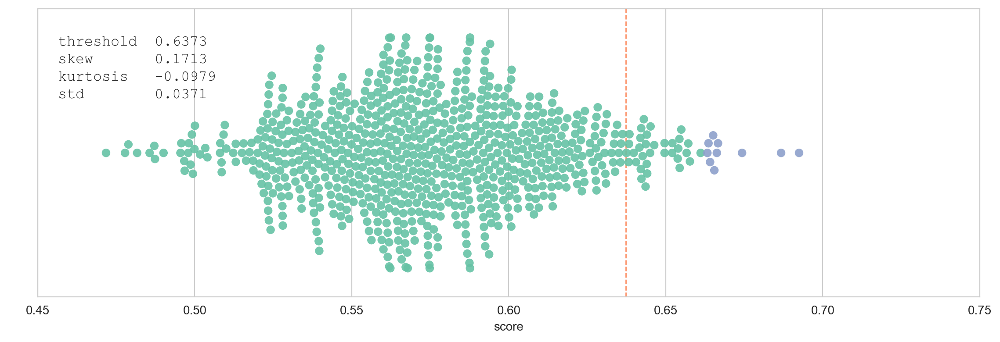

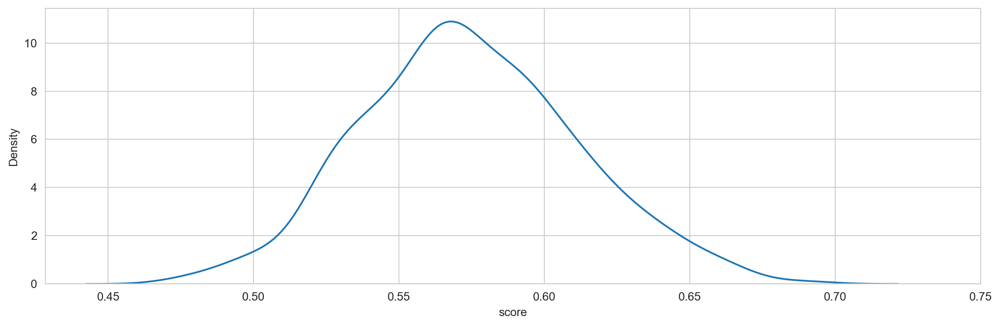

**Article 19**

Why Chevron And Exxon Shun Solar And Wind

The world's largest oil companies are under growing pressure from shareholders and society to reduce emissions and show efforts to fight the worst effects of climate change.  

Everyone in the Big Oil club has announced various plans to cut emissions and invest in low-carbon energy over the past 18 months. Yet, there are stark differences in the ways the largest international oil companies are approaching the emissions problem. 

Europe's top oil and gas firms have all committed to becoming net-zero energy businesses by 2050 or sooner. Most of them say their oil production has either peaked already or is about to peak by the middle of this decade. And all of them bet on investments in renewable electricity generation—along with hydrogen, carbon capture and storage, biofuels, and electric vehicle charging networks—to deserve being called 'energy companies' instead of oil companies. 

Unlike their European peers, the two supermajors in the Unite

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,513,NRG Energy,NRG,Utilities,Electric Utilities,"NRG Energy, Inc. is a large American energy company, headquartered in Houston, Texas. It was formerly the wholesale arm of Northern States Power Company (NSP), which became Xcel Energy, but became independent in 2000. NRG Energy is involved in energy generation and retail electricity. Their portfolio includes natural gas generation, coal generation, oil generation, nuclear generation, wind generation, utility scale generation, and distributed solar generation. NRG serves 2.9 million retail customers in Texas, Connecticut, Delaware, Illinois, Maryland, Massachusetts, New Jersey, New York, Pennsylvania, Ohio, and the District of Columbia.",0.747857
1,303,FuelCell Energy,FCEL,Electronic Technology,Electronic Equipment/Instruments,"FuelCell Energy, Inc. is an American fuel cell power company. It designs, manufactures, operates and services Direct Fuel Cell power plants (a type of molten carbonate fuel cell) that run on natural gas and biogas. Their power plants are not considered ""hydrogen fuel cells"" because their feedstock is not pure hydrogen and the byproducts of electric generation include carbon dioxide. As one of the biggest publicly traded fuel cell manufacturers in the U.S., the company operates over 50 plants all over the world. It operates the world’s largest fuel cell park, Gyeonggi Green Energy Fuel cell park, which is located in South Korea. The park consists of 21 power plants providing 59 Megawatt of electricity plus district heating to a number of customers in South Korea. It also operates the larges",0.740914
2,268,Equinor,EQNR,Energy Minerals,Integrated Oil,"Equinor ASA (formerly Statoil and StatoilHydro) is a Norwegian state-owned multinational energy company headquartered in Stavanger. It is primarily a petroleum company, operating in 36 countries with additional investments in renewable energy. In the 2020 Forbes Global 2000, Equinor was ranked as the 169th-largest public company in the world. The company has about 20,200 employees.",0.724927
3,717,Valero,VLO,Energy Minerals,Oil Refining/Marketing,"Valero Energy Corporation is a Fortune 500 international manufacturer and marketer of transportation fuels, other petrochemical products, and power. It is headquartered in San Antonio, Texas, United States. Throughout the United States and Canada, the company owns and operates 15 refineries, and one in Wales, with a combined throughput capacity of approximately 3 million barrels (480,000 m3) per day, 11 ethanol plants with a combined production capacity of 1.2 billion US gallons (4,500,000 m3) per year, and a 50-megawatt wind farm. Before the 2013 spinoff of CST Brands, Valero was one of the United States' largest retail operators with approximately 6,800 retail and branded wholesale outlets in the United States, Canada, United Kingdom, and the Caribbean under the Valero, Diamond Shamrock,",0.716426
4,225,Diamondback Energy Inc,FANG,Energy Minerals,Oil & Gas Production,"Diamondback Energy is a company engaged in hydrocarbon exploration and headquartered in Midland, Texas. As of December 31, 2020, the company had 1,316 million barrels of oil equivalent (8.05×109 GJ) of estimated proved reserves, of which 58% was petroleum, 20% was natural gas, and 22% was natural gas liquids. The company's reserves are all in the Permian Basin.",0.712190
5,172,Cloudera,CLDR,Technology Services,Packaged Software,"Cloudera, Inc. is a US-based company that provides an enterprise data cloud. Built on open source technology, Cloudera’s platform uses analytics and machine learning to yield insights from data through a secure connection. Cloudera’s platform works across hybrid, multi-cloud and on-premises architectures and provides multi-function analytics throughout the edge to AI data lifecycle.",0.711780
6,122,Brookfield Renewable Partners,BEP,Utilities,Electric Utilities,"Brookfield Renewable Partners L.P. is a publicly tr

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
84,278,Exxon Mobil,XOM,Energy Minerals,Integrated Oil,"Exxon Mobil Corporation, stylized as ExxonMobil, is an American multinational oil and gas corporation headquartered in Irving, Texas. It is the largest direct descendant of John D. Rockefeller's Standard Oil, and was formed on November 30, 1999, by the merger of Exxon (formerly the Standard Oil Company of New Jersey) and Mobil (formerly the Standard Oil Company of New York). ExxonMobil's primary brands are Exxon, Mobil, Esso, and ExxonMobil Chemical. ExxonMobil is incorporated in New Jersey.",0.658885
90,158,Chevron,CVX,Energy Minerals,Integrated Oil,"Chevron Corporation is an American multinational energy corporation. It was founded in 1984 and is the third largest oil company in America. One of the successor companies of Standard Oil, it is headquartered in San Ramon, California, and active in more than 180 countries. Chevron is engaged in every aspect of the oil and natural gas industries, including hydrocarbon exploration and production; refining, marketing and transport; chemicals manufacturing and sales; and power generation. Chevron is one of the world's largest companies; as of March 2020, it ranked fifteenth in the Fortune 500 with a yearly revenue of $146.5 billion and market valuation of $136 billion. In the 2020 Forbes Global 2000, Chevron was ranked as the 61st-largest public company in the world. It was also one of the Sev",0.655101


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
12,548,Petroleo Brasileiro S.A.,PBR,Energy Minerals,Integrated Oil,"Petróleo Brasileiro S.A., better known by the acronym Petrobras (Portuguese pronunciation: [ˌpɛtɾoˈbɾas ]), is a state-owned Brazilian multinational corporation in the petroleum industry headquartered in Rio de Janeiro, Brazil. The company's name translates to Brazilian Petroleum Corporation — Petrobras.The company was ranked #120 in the most recent Fortune Global 500 list. In the 2020 Forbes Global 2000, Petrobras was ranked as the 70th -largest public company in the world.",0.697633
67,115,BP plc,BP,Energy Minerals,Integrated Oil,"BP plc (official styling BP p.l.c., formerly The British Petroleum Company plc and BP Amoco plc) is a British multinational oil and gas company headquartered in London, England. It is one of the world's seven oil and gas ""supermajors"". It is a vertically integrated company operating in all areas of the oil and gas industry, including exploration and production, refining, distribution and marketing, power generation, and trading. It also has renewable energy interests in biofuels, wind power, smart grid, and solar technology.",0.664361
133,521,Occidental,OXY,Energy Minerals,Oil & Gas Production,"Occidental Petroleum Corporation (often abbreviated Oxy in reference to its ticker symbol and logo) is an American company engaged in hydrocarbon exploration in the United States, the Middle East, and Colombia as well as petrochemical manufacturing in the United States, Canada, and Chile. It is organized in Delaware and headquartered in Houston. The company is ranked 167th on the Fortune 500 and 669th on the Forbes Global 2000. Arthur Andersen was Oxy's auditors.",0.646402


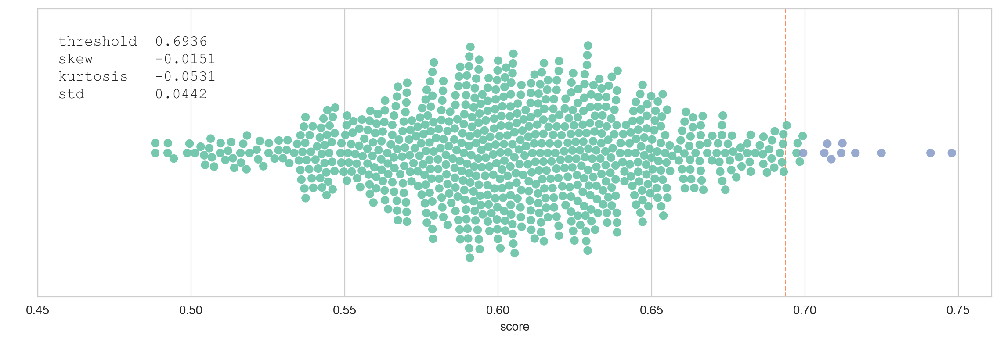

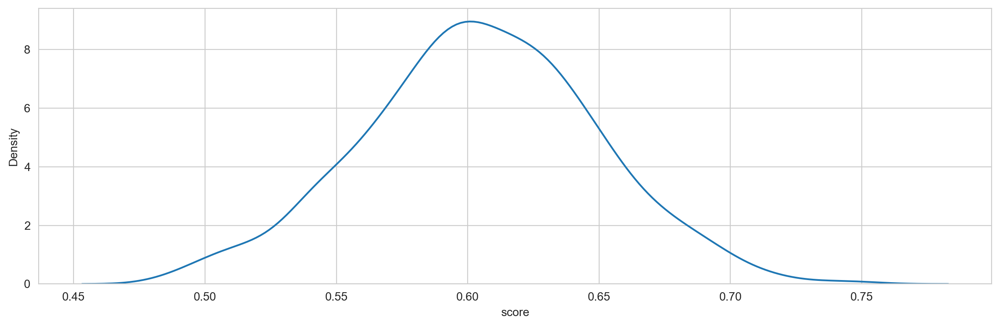

**Article 20**

Petrobras (PBR) Aims to Obtain Net-Zero Emission From Operations

Petróleo Brasileiro S.A. or Petrobras (PBR) announced its commitment to achieve net-zero emissions from operations and work with its partners in non-operated areas to help them lower emissions.

With the rise of Environmental, Social and Governance investing and the broad-based transition toward clean energy; a number of oil/gas companies have decided voluntarily to become carbon neutral over the next three decades.

Petrobras’ decision is part of the strategy of the Oil and Gas Climate Initiative (OGCI) member companies, of which Petrobras is a member since 2018. The other OGCI members are BP plc (BP) , Chevron Corporation (CVX) , Royal Dutch Shell plc (RDS.A) , Aramco, Eni, CNPC, ExxonMobil, Equinor, TotalEnergies, Repsol and Occidental.

Petrobras' net-zero target revolves around scopes 1 and 2 emissions, which involve greenhouse-gas emissions from its operations and indirect emissions associated with energy purchases

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,548,Petroleo Brasileiro S.A.,PBR,Energy Minerals,Integrated Oil,"Petróleo Brasileiro S.A., better known by the acronym Petrobras (Portuguese pronunciation: [ˌpɛtɾoˈbɾas ]), is a state-owned Brazilian multinational corporation in the petroleum industry headquartered in Rio de Janeiro, Brazil. The company's name translates to Brazilian Petroleum Corporation — Petrobras.The company was ranked #120 in the most recent Fortune Global 500 list. In the 2020 Forbes Global 2000, Petrobras was ranked as the 70th -largest public company in the world.",0.775638
1,268,Equinor,EQNR,Energy Minerals,Integrated Oil,"Equinor ASA (formerly Statoil and StatoilHydro) is a Norwegian state-owned multinational energy company headquartered in Stavanger. It is primarily a petroleum company, operating in 36 countries with additional investments in renewable energy. In the 2020 Forbes Global 2000, Equinor was ranked as the 169th-largest public company in the world. The company has about 20,200 employees.",0.773962
2,632,Southern Copper,SCCO,Non-Energy Minerals,Other Metals/Minerals,"Southern Copper Corporation is a mining company that was founded in 1952. The current incarnation of Southern Copper can be traced to the 2005 acquisition of Southern Peru Copper Corporation by the Mexican copper producer Minera México. The company is a major producer and refiner of copper, molybdenum, zinc, silver, lead, and gold, and operates mines and smelters in Mexico and in Peru, in the Andes mountains southeast of Lima.",0.773771
3,544,PBF Energy,PBF,Energy Minerals,Oil Refining/Marketing,"PBF Energy Inc. is a petroleum refiner and supplier of unbranded transportation fuels, heating oils, lubricants, petrochemical feedstocks, and other petroleum products. Headquartered in Parsippany, New Jersey, the company's refineries include facilities in Chalmette, Louisiana, Toledo, Ohio, Port of Paulsboro in Gibbstown, New Jersey, the Delaware City Refinery in Delaware City, the former ExxonMobil refinery in Torrance, California, and the former Shell refinery in Martinez, California. PBF produces a range of products including gasoline, ultra-low-sulfur diesel (ULSD), heating oil, jet fuel, lubricants, petrochemicals and asphalt.",0.748783
4,716,Vale,VALE,Non-Energy Minerals,Steel,"Vale S.A. (Portuguese pronunciation: [ˈvali]) is a Brazilian multinational corporation engaged in metals and mining and one of the largest logistics operators in Brazil. Vale, formerly Companhia Vale do Rio Doce (the Sweet River Valley Company, referring to the Doce River), is the largest producer of iron ore and nickel in the world. Vale also produces manganese, ferroalloys, copper, bauxite, potash, kaolin, and cobalt, currently operating nine hydroelectricity plants, and a large network of railroads, ships, and ports used to transport its products.",0.747508
5,188,Companhia Siderurgica Nacional,SID,Non-Energy Minerals,Steel,"Companhia Siderúrgica Nacional (CSN) (en: National Siderurgy Company) is the largest fully integrated steel producer in Brazil and one of the largest in Latin America in terms of crude steel production. Its main plant is located in the city of Volta Redonda, in the state of Rio de Janeiro. Its current CEO is Benjamin Steinbruch.",0.743777
6,193,ConocoPhillips,COP,Energy Minerals,Oil & Gas Production,"ConocoPhillips is an American multinational corporation engaged in hydrocarbon exploration. It is based in the Energy Corridor district of Houston, Texas. The company has operations in 17 countries and has production in the United States (49% of 2019 production), Norway (10% of 2019 production), Canada (5% of 2019 production), Australia (12% of 2019 production), Timor-Leste, Indonesia (4% of 2019 production), Malaysia (4% of 2019 production), Libya (3% of 2019 production), China (3% of 2019 production), and Qatar (6% of 2019 production). The company's production in the United States included production in Alaska, the Eagle

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
22,115,BP plc,BP,Energy Minerals,Integrated Oil,"BP plc (official styling BP p.l.c., formerly The British Petroleum Company plc and BP Amoco plc) is a British multinational oil and gas company headquartered in London, England. It is one of the world's seven oil and gas ""supermajors"". It is a vertically integrated company operating in all areas of the oil and gas industry, including exploration and production, refining, distribution and marketing, power generation, and trading. It also has renewable energy interests in biofuels, wind power, smart grid, and solar technology.",0.720537
24,158,Chevron,CVX,Energy Minerals,Integrated Oil,"Chevron Corporation is an American multinational energy corporation. It was founded in 1984 and is the third largest oil company in America. One of the successor companies of Standard Oil, it is headquartered in San Ramon, California, and active in more than 180 countries. Chevron is engaged in every aspect of the oil and natural gas industries, including hydrocarbon exploration and production; refining, marketing and transport; chemicals manufacturing and sales; and power generation. Chevron is one of the world's largest companies; as of March 2020, it ranked fifteenth in the Fortune 500 with a yearly revenue of $146.5 billion and market valuation of $136 billion. In the 2020 Forbes Global 2000, Chevron was ranked as the 61st-largest public company in the world. It was also one of the Sev",0.719492
25,521,Occidental,OXY,Energy Minerals,Oil & Gas Production,"Occidental Petroleum Corporation (often abbreviated Oxy in reference to its ticker symbol and logo) is an American company engaged in hydrocarbon exploration in the United States, the Middle East, and Colombia as well as petrochemical manufacturing in the United States, Canada, and Chile. It is organized in Delaware and headquartered in Houston. The company is ranked 167th on the Fortune 500 and 669th on the Forbes Global 2000. Arthur Andersen was Oxy's auditors.",0.719210
60,278,Exxon Mobil,XOM,Energy Minerals,Integrated Oil,"Exxon Mobil Corporation, stylized as ExxonMobil, is an American multinational oil and gas corporation headquartered in Irving, Texas. It is the largest direct descendant of John D. Rockefeller's Standard Oil, and was formed on November 30, 1999, by the merger of Exxon (formerly the Standard Oil Company of New Jersey) and Mobil (formerly the Standard Oil Company of New York). ExxonMobil's primary brands are Exxon, Mobil, Esso, and ExxonMobil Chemical. ExxonMobil is incorporated in New Jersey.",0.690008


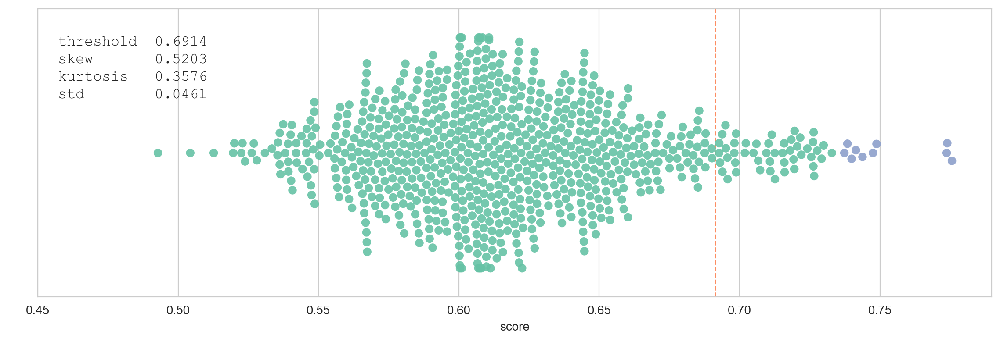

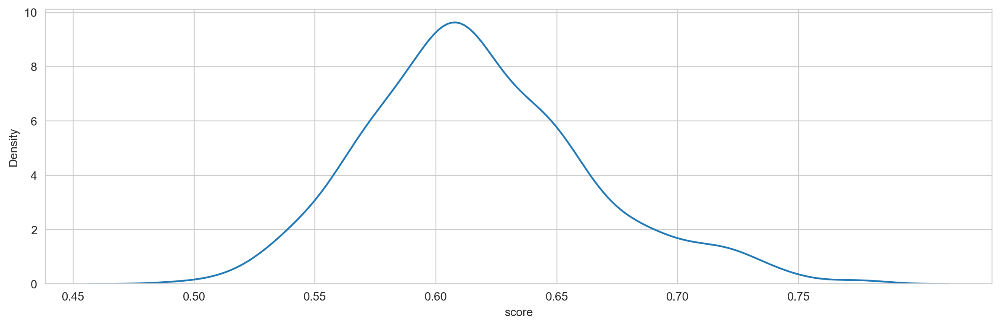

**Article 21**

Has Occidental Petroleum (OXY) Outpaced Other Oils-Energy Stocks This Year?

Investors focused on the Oils-Energy space have likely heard of Occidental Petroleum (OXY), but is the stock performing well in comparison to the rest of its sector peers? By taking a look at the stock's year-to-date performance in comparison to its Oils-Energy peers, we might be able to answer that question.

Occidental Petroleum is one of 253 companies in the Oils-Energy group. The Oils-Energy group currently sits at #6 within the Zacks Sector Rank. The Zacks Sector Rank gauges the strength of our 16 individual sector groups by measuring the average Zacks Rank of the individual stocks within the groups.

The Zacks Rank emphasizes earnings estimates and estimate revisions to find stocks with improving earnings outlooks. This system has a long record of success, and these stocks tend to be on track to beat the market over the next one to three months. OXY is currently sporting a Zacks Rank of #2 (Buy).

Within

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,706,Union Pacific,UNP,Transportation,Railroads,"The Union Pacific Corporation (Union Pacific) is a publicly traded railroad holding company. It was incorporated in Utah in 1969 and is headquartered in Omaha, Nebraska. It is the parent company of the current, Delaware-registered, form of the Union Pacific Railroad.",0.667766
1,50,AngloGold Ashanti,AU,Non-Energy Minerals,Precious Metals,"AngloGold Ashanti Limited is a global gold mining company. It was formed in 2004 by the merger of AngloGold and the Ashanti Goldfields Corporation. It is now a global gold producer with 21 operations on four continents. The company is listed on the New York, Johannesburg, Accra, London and Australian stock exchanges, as well as the Paris and Brussels bourses.",0.666942
2,752,White Mountains Insurance Group,WTM,Finance,Multi-Line Insurance,"White Mountains Insurance Group (NYSE: WTM) is a diversified insurance and related financial services holding company based in Hamilton, Bermuda. Redomiciled from Delaware, United States, on October 25, 1999, the company conducts most of its business through its insurance subsidiaries and other affiliates. The company owned the automobile insurer Esurance before selling it to Allstate for $1 billion.",0.666033
3,476,Moody’s,MCO,Commercial Services,Financial Publishing/Services,"Moody's Corporation, often referred to as Moody's, is an American business and financial services company. It is the holding company for Moody's Investors Service (MIS), an American credit rating agency, and Moody's Analytics (MA), an American provider of financial analysis software and services.",0.664702
4,252,Eldorado Gold Corporation,EGO,Non-Energy Minerals,Precious Metals,"Eldorado Gold Corporation is a Canadian company that owns and operates gold mines in Turkey, Greece and Canada. Since its merger with European Goldfields in 2011 the company has been pursuing the development of the Skouries mine, Olympias mine and Stratoni mine in Greece. The company previously developed and operated gold mines in China, Brazil and Mexico. Headquartered in Vancouver and listed on the Toronto and New York Stock Exchanges, Eldorado Gold has developed and operated assets from several merged companies HRC Developments Corporation, Afcan Mining Corporation, Sino Gold Mining, Brazauro Resources, Integra Gold, as well as European Goldfields.",0.660123
5,175,CME Group (Class A),CME,Finance,Investment Banks/Brokers,"CME Group Inc. (Chicago Mercantile Exchange, Chicago Board of Trade, New York Mercantile Exchange, The Commodity Exchange) is an American global markets company. It is the world's largest financial derivatives exchange, and trades in asset classes that include agricultural products, currencies, energy, interest rates, metals, stock indexes and cryptocurrencies futures. The company offers futures contracts and options on futures using its CME Globex trading platforms, fixed income trading via BrokerTec and foreign exchange trading on the EBS platform. In addition, it operates a central counterparty clearing provider, CME Clearing. With a range of pre- and post-trade products and services underpinning the entire lifecycle of a trade, CME Group also offers optimization and reconciliation serv",0.658095
6,392,J.B. Hunt,JBHT,Transportation,Trucking,"J.B. Hunt Transport Services, Inc. is an American transportation and logistics company based in Lowell, Arkansas. It was founded by Johnnie Bryan Hunt and Johnelle Hunt in Arkansas on August 10, 1961. By 1983, J.B. Hunt had grown into the 80th largest trucking firm in the U.S. and earned $623.47 million in revenue. At that time J.B. Hunt was operating 550 tractors, 1,049 trailers, and had roughly 1,050 employees. J.B. Hunt primarily operates large semi-trailer trucks and provides transportation services throughout the continental U.S., Canada and Mexico. The company currently employs over 24,000 and operates more than 12,000 trucks. The com

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
76,521,Occidental,OXY,Energy Minerals,Oil & Gas Production,"Occidental Petroleum Corporation (often abbreviated Oxy in reference to its ticker symbol and logo) is an American company engaged in hydrocarbon exploration in the United States, the Middle East, and Colombia as well as petrochemical manufacturing in the United States, Canada, and Chile. It is organized in Delaware and headquartered in Houston. The company is ranked 167th on the Fortune 500 and 669th on the Forbes Global 2000. Arthur Andersen was Oxy's auditors.",0.621407


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
15,548,Petroleo Brasileiro S.A.,PBR,Energy Minerals,Integrated Oil,"Petróleo Brasileiro S.A., better known by the acronym Petrobras (Portuguese pronunciation: [ˌpɛtɾoˈbɾas ]), is a state-owned Brazilian multinational corporation in the petroleum industry headquartered in Rio de Janeiro, Brazil. The company's name translates to Brazilian Petroleum Corporation — Petrobras.The company was ranked #120 in the most recent Fortune Global 500 list. In the 2020 Forbes Global 2000, Petrobras was ranked as the 70th -largest public company in the world.",0.646666
315,278,Exxon Mobil,XOM,Energy Minerals,Integrated Oil,"Exxon Mobil Corporation, stylized as ExxonMobil, is an American multinational oil and gas corporation headquartered in Irving, Texas. It is the largest direct descendant of John D. Rockefeller's Standard Oil, and was formed on November 30, 1999, by the merger of Exxon (formerly the Standard Oil Company of New Jersey) and Mobil (formerly the Standard Oil Company of New York). ExxonMobil's primary brands are Exxon, Mobil, Esso, and ExxonMobil Chemical. ExxonMobil is incorporated in New Jersey.",0.587391
383,115,BP plc,BP,Energy Minerals,Integrated Oil,"BP plc (official styling BP p.l.c., formerly The British Petroleum Company plc and BP Amoco plc) is a British multinational oil and gas company headquartered in London, England. It is one of the world's seven oil and gas ""supermajors"". It is a vertically integrated company operating in all areas of the oil and gas industry, including exploration and production, refining, distribution and marketing, power generation, and trading. It also has renewable energy interests in biofuels, wind power, smart grid, and solar technology.",0.580277
503,158,Chevron,CVX,Energy Minerals,Integrated Oil,"Chevron Corporation is an American multinational energy corporation. It was founded in 1984 and is the third largest oil company in America. One of the successor companies of Standard Oil, it is headquartered in San Ramon, California, and active in more than 180 countries. Chevron is engaged in every aspect of the oil and natural gas industries, including hydrocarbon exploration and production; refining, marketing and transport; chemicals manufacturing and sales; and power generation. Chevron is one of the world's largest companies; as of March 2020, it ranked fifteenth in the Fortune 500 with a yearly revenue of $146.5 billion and market valuation of $136 billion. In the 2020 Forbes Global 2000, Chevron was ranked as the 61st-largest public company in the world. It was also one of the Sev",0.567238


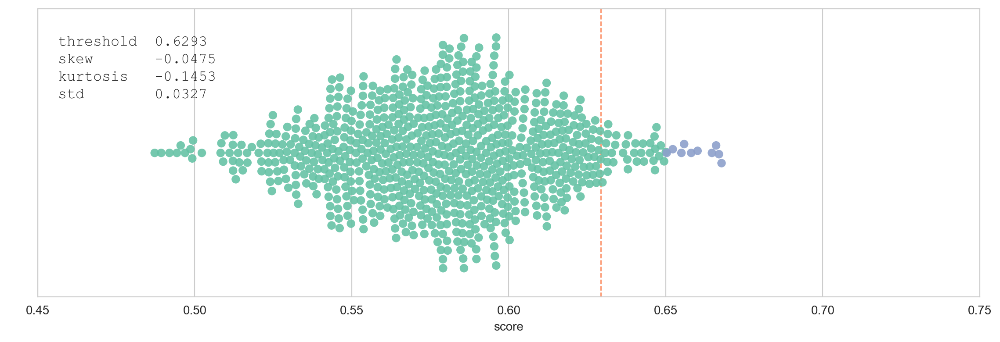

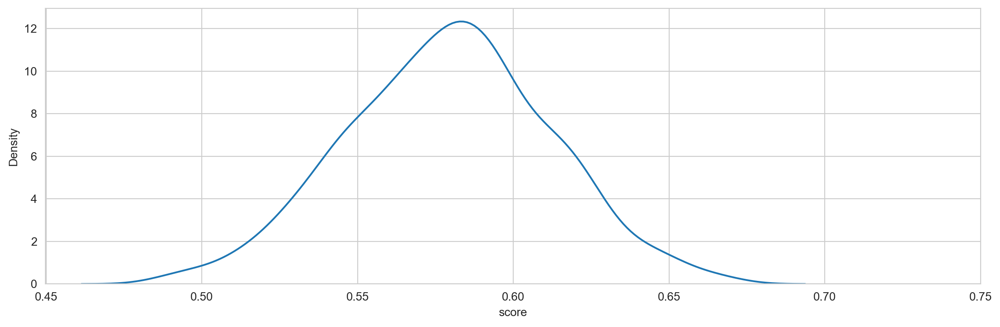

**Article 22**

Will SoFi Technologies Be the Next Fintech Disruptor?

The company just entered the public markets through a SPAC, and is going after a gigantic market opportunity.

Key Points
1. SoFi is an all-in-one personal finance app.
2. It made a great acquisition of the technology platform Galileo last year.
3. It still heavily trails competitors Square and PayPal in app store downloads.

Stocks in the financial technology (fintech) sector have been great performers over the past five years. Square is up more than 2,100%, PayPal has gained almost 600%, and Visa is up nearly 170% in the last five years, with all three beating the returns of the broad S&P 500 index. Clearly there are some great opportunities within the fintech sector for investors to take advantage of.

One new fintech stock to enter the public markets is SoFi Technologies (NASDAQ:SOFI), which officially started trading this year. Is SoFi the next fintech disruptor set to crush the market?

What is SoFi?

SoFi started out a decad

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,627,SoFi Technologies,SOFI,Finance,Finance/Rental/Leasing,"Social Finance, Inc. (commonly known as SoFi) is an American online personal finance company. A mobile-first service based in San Francisco, SoFi provides a suite of financial products that includes student loan refinancing, mortgages, personal loans, credit card, investing and banking through both their mobile app and desktop interfaces.",0.723705
1,474,MongoDB,MDB,Technology Services,Packaged Software,"MongoDB, Inc. is an American software company that develops and provides commercial support for the source-available database MongoDB, a NoSQL database that stores data in JSON-like documents with flexible schemas.",0.712195
2,86,Banco Santander (Brasil),BSBR,Finance,Regional Banks,"Banco Santander (Brasil) S.A. is the Brazilian subsidiary of the Spanish Santander Group, headquartered in São Paulo, Brazil. It is the fifth largest banking institution in Brazil, as well as the fifth largest in Latin America, and the largest division of the group outside Europe, accounting for around 30% of its financial results globally by 2019. The bank is listed at the B3 in São Paulo, and at NYSE though ADRs.",0.702378
3,641,SS&C Technologies Holdings,SSNC,Technology Services,Information Technology Services,"SS&C Technologies Holdings, Inc. (known as SS&C) is an American multinational financial technology company headquartered in Windsor, Connecticut, that sells software and software as a service to the financial services industry. The company has offices in the Americas, Europe, Asia, Africa and Australia.",0.699369
4,12,Affirm Holdings,AFRM,Technology Services,Internet Software/Services,"Affirm is a publicly traded financial technology company headquartered in San Francisco, United States. Founded in 2012, the company operates as a financial lender of installment loans for consumers to use at the point of sale to finance a purchase.",0.692452
5,459,MercadoLibre,MELI,Technology Services,Internet Software/Services,"Mercado Libre, Inc. (literally ""free market"" in Spanish, and known as Mercado Livre in Portuguese) is an Argentine company headquartered in Buenos Aires, incorporated in the United States that operates online marketplaces dedicated to e-commerce and online auctions, including mercadolibre.com. As of 2016, Mercado Libre had 174.2 million users in Latin America, making it the region's most popular e-commerce site by number of visitors. The company has operations in Argentina, Bolivia, Brazil, Chile, Colombia, Costa Rica, Dominican Republic, Mexico, Spain, Ecuador, Guatemala, Honduras, Peru, Panama, Uruguay, and Venezuela.",0.692230
6,701,UiPath,PATH,Technology Services,Packaged Software,"UiPath is a global software company for robotic process automation (RPA) founded in Romania by Daniel Dines and Marius Tîrcă and headquartered in New York City. The company's software monitors user activity to automate repetitive front and back office tasks, including those performed using other business software such as customer relationship management or enterprise resource planning (ERP) software. In December 2020, the company filed confidentially for an initial public offering, and became public on April 21, 2021.",0.690410
7,114,Box,BOX,Technology Services,Information Technology Services,"Box, Inc. (formerly Box.net), is an American internet company based in Redwood City, California. The company focuses on cloud content management and file sharing service for businesses. Official clients and apps are available for Windows, macOS, and several mobile platforms. Box was founded in 2005.",0.690270
8,696,Twilio,TWLO,Technology Services,Packaged Software,"Twilio (/ˈtwɪlioʊ/) is an American cloud communications platform as a service (CPaaS) company based in San Francisco, California. Twilio allows software developers to programmatically make and receive phone calls, send and receive text messages, and perform other communication 

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
27,84,Banco Bradesco S.A. – Preferred Shares,BBD,Finance,Major Banks,"Banco Bradesco S.A. is a Brazilian financial services company headquartered in Osasco, in the state of São Paulo, Brazil. It is the third largest banking institution in Brazil, as well as the third largest in Latin America, and the seventy-ninth largest bank in the world. It is also one of fifty most valuable banks in the world. The bank is listed at the B3 in São Paulo, where it is part of the Índice Bovespa, in the New York Stock Exchange and in the Madrid Stock Exchange.",0.668497
58,391,Itaú Unibanco,ITUB,Finance,Major Banks,"Banco Itaú Unibanco S.A. is a Brazilian financial services company headquartered in São Paulo, Brazil. Itaú Unibanco was formed through the merger of Banco Itaú and Unibanco in 2008. It is the largest banking institution in Brazil, as well as the largest in Latin America and in the Southern Hemisphere, and the seventy-first largest bank in the world. It is also one of twenty most valuable banks in the world. The bank is listed at the B3 in São Paulo and in NYSE in New York.",0.657069
258,87,Bank of America,BAC,Finance,Major Banks,"The Bank of America Corporation (simply referred to as Bank of America, often abbreviated as BofA or BoA) is an American multinational investment bank and financial services holding company headquartered in Charlotte, North Carolina. Founded in San Francisco, Bank of America was formed through NationsBank's acquisition of BankAmerica in 1998. It is the second largest banking institution in the United States, after JPMorgan Chase, and the eighth largest bank in the world. Bank of America is one of the Big Four banking institutions of the United States. It serves approximately 10.73% of all American bank deposits, in direct competition with JPMorgan Chase, Citigroup and Wells Fargo. Its primary financial services revolve around commercial banking, wealth management, and investment banking.",0.612029


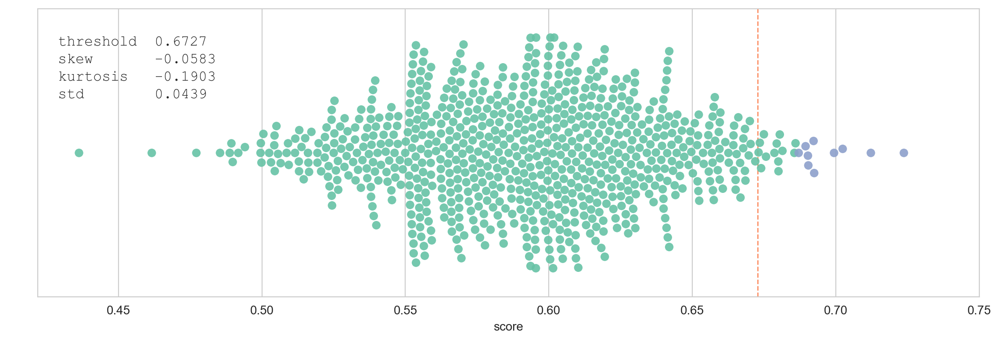

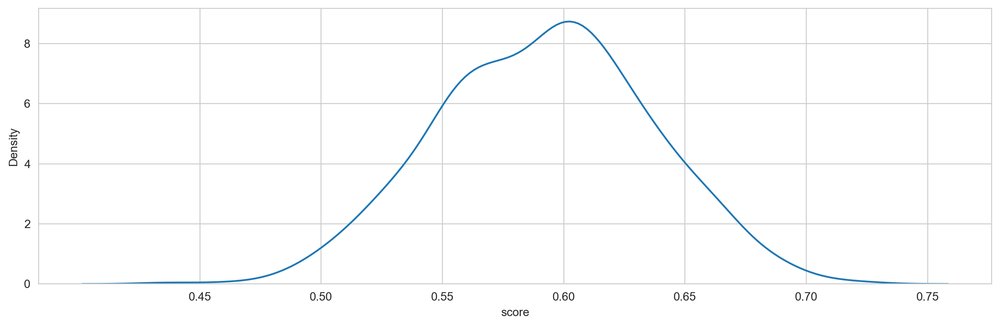

**Article 23**

Citigroup floats $236.6 million in MBS backing single-family home investors

The Citigroup Mortgage Loan Trust 2021-INV3 is preparing to issue about $236.6 million in mortgage-backed securities, collateralized by conforming, fixed-rate loans made to investors, some of whom are carrying multiple mortgages.

DBRS Morningstar noted that the mortgages are made largely on conforming single-family homes, 65.3%, with another quarter of the mortgages made to two- to four-family homes.

Citigroup Global Markets is the initial note purchaser on the deal, for which Citigroup’s realty corporation is the loan seller and deal sponsor. PennyMac Corp. is acting as the initial seller, originator and servicer, according to DBRS.
The transaction is based on a senior-subordinate, shifting-interest capital structure.

While mortgage payment forbearance plans were common during the COVID-19 induced recession, none of the borrowers in Citigroup Mortgage 2021-INV3’s collateral pool availed themselves of that 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,387,Invitation Homes,INVH,Finance,Real Estate Investment Trusts,"Invitation Homes Inc. is the largest owner of single-family rental homes in the United States, owning approximately 80,000 homes in 16 markets.",0.717226
1,168,Citigroup,C,Finance,Financial Conglomerates,"Citigroup Inc. or Citi (stylized as citi) is an American multinational investment bank and financial services corporation headquartered in New York City. The company was formed by the merger of banking giant Citicorp and financial conglomerate Travelers Group in 1998; Travelers was subsequently spun off from the company in 2002. Citigroup owns Citicorp, the holding company for Citibank, as well as several international subsidiaries. Citigroup is incorporated in Delaware. In 2020 it has over $23.6 trillion dollars in assets under custody (AUC)",0.699528
2,627,SoFi Technologies,SOFI,Finance,Finance/Rental/Leasing,"Social Finance, Inc. (commonly known as SoFi) is an American online personal finance company. A mobile-first service based in San Francisco, SoFi provides a suite of financial products that includes student loan refinancing, mortgages, personal loans, credit card, investing and banking through both their mobile app and desktop interfaces.",0.682086
3,27,Ally Financial,ALLY,Finance,Regional Banks,"Ally Financial is a bank holding company organized in Delaware and headquartered in Detroit, Michigan. The company provides financial services including car finance, online banking via a direct bank, corporate lending, vehicle insurance, mortgage loans, and an electronic trading platform to trade financial assets. The company was known as GMAC, an acronym for General Motors Acceptance Corporation, until 2010.",0.676079
4,476,Moody’s,MCO,Commercial Services,Financial Publishing/Services,"Moody's Corporation, often referred to as Moody's, is an American business and financial services company. It is the holding company for Moody's Investors Service (MIS), an American credit rating agency, and Moody's Analytics (MA), an American provider of financial analysis software and services.",0.675675
5,461,Metlife,MET,Finance,Life/Health Insurance,"MetLife, Inc. is the holding corporation for the Metropolitan Life Insurance Company (MLIC), better known as MetLife, and its affiliates. MetLife is among the largest global providers of insurance, annuities, and employee benefit programs, with 90 million customers in over 60 countries. The firm was founded on March 24, 1868. MetLife ranked No. 43 in the 2018 Fortune 500 list of the largest United States corporations by total revenue.",0.671407
6,425,Lennar,LEN,Consumer Durables,Homebuilding,"Lennar Corporation is a home construction and real estate company based in Fontainebleau, Florida, with a Miami postal address. In 2017, the company was the largest home construction company in the United States after its purchase of CalAtlantic Homes. The company is ranked 154th on the Fortune 500 as of 2019. The company operates in 21 states and owns Rialto Capital Management, the sponsor of six private equity funds that invest in real estate and an originator commercial mortgage loans for securitization. The company also developed and retains ownership interests in 53 apartment communities. The name Lennar is a portmanteau of the first names of two of the company's founders, Leonard Miller and Arnold Rosen.",0.670334
7,229,Discover Financial Services,DFS,Finance,Finance/Rental/Leasing,"Discover Financial Services is an American financial services company that owns and operates Discover Bank, which offers checking and savings accounts, personal loans, home equity loans, student loans and credit cards. It also owns and operates the Discover and Pulse networks, and owns Diners Club International. Discover Card is the third largest credit card brand in the United States, when measured by cards in force, with nearly 50 million cardholders. Discover is currently headquartered in th

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
32,87,Bank of America,BAC,Finance,Major Banks,"The Bank of America Corporation (simply referred to as Bank of America, often abbreviated as BofA or BoA) is an American multinational investment bank and financial services holding company headquartered in Charlotte, North Carolina. Founded in San Francisco, Bank of America was formed through NationsBank's acquisition of BankAmerica in 1998. It is the second largest banking institution in the United States, after JPMorgan Chase, and the eighth largest bank in the world. Bank of America is one of the Big Four banking institutions of the United States. It serves approximately 10.73% of all American bank deposits, in direct competition with JPMorgan Chase, Citigroup and Wells Fargo. Its primary financial services revolve around commercial banking, wealth management, and investment banking.",0.648131
133,84,Banco Bradesco S.A. – Preferred Shares,BBD,Finance,Major Banks,"Banco Bradesco S.A. is a Brazilian financial services company headquartered in Osasco, in the state of São Paulo, Brazil. It is the third largest banking institution in Brazil, as well as the third largest in Latin America, and the seventy-ninth largest bank in the world. It is also one of fifty most valuable banks in the world. The bank is listed at the B3 in São Paulo, where it is part of the Índice Bovespa, in the New York Stock Exchange and in the Madrid Stock Exchange.",0.620432
168,391,Itaú Unibanco,ITUB,Finance,Major Banks,"Banco Itaú Unibanco S.A. is a Brazilian financial services company headquartered in São Paulo, Brazil. Itaú Unibanco was formed through the merger of Banco Itaú and Unibanco in 2008. It is the largest banking institution in Brazil, as well as the largest in Latin America and in the Southern Hemisphere, and the seventy-first largest bank in the world. It is also one of twenty most valuable banks in the world. The bank is listed at the B3 in São Paulo and in NYSE in New York.",0.614346


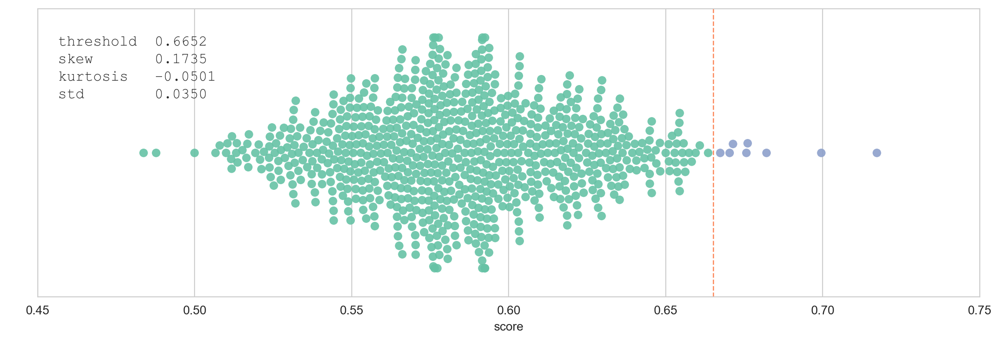

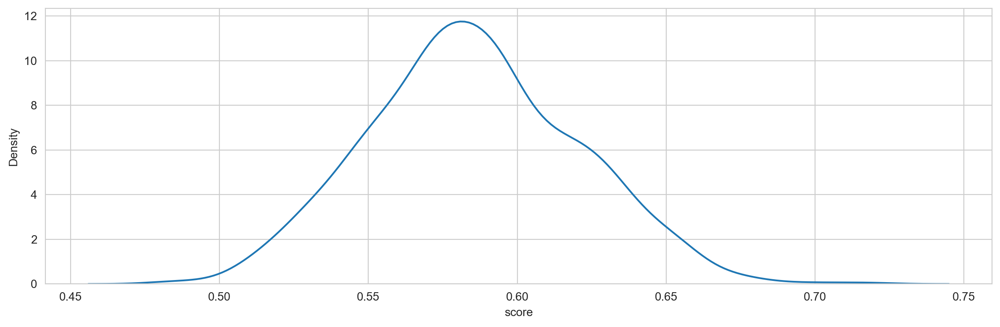

**Article 24**

Banco Bradesco S.A. Plans Monthly Dividend of $0.00 (NYSE:BBD)

Banco Bradesco S.A. (NYSE:BBD) declared a monthly dividend on Wednesday, September 22nd, Wall Street Journal reports. Shareholders of record on Tuesday, October 5th will be given a dividend of 0.0035 per share by the bank on Monday, November 8th. This represents a $0.04 dividend on an annualized basis and a yield of 1.13%. The ex-dividend date of this dividend is Monday, October 4th.

Banco Bradesco has decreased its dividend by 64.8% over the last three years. Banco Bradesco has a payout ratio of 1.9% indicating that its dividend is sufficiently covered by earnings. Equities analysts expect Banco Bradesco to earn $0.55 per share next year, which means the company should continue to be able to cover its $0.01 annual dividend with an expected future payout ratio of 1.8%.

BBD stock traded up $0.06 during mid-day trading on Wednesday, reaching $3.77. 33,229,949 shares of the company traded hands, compared to its average volu

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,86,Banco Santander (Brasil),BSBR,Finance,Regional Banks,"Banco Santander (Brasil) S.A. is the Brazilian subsidiary of the Spanish Santander Group, headquartered in São Paulo, Brazil. It is the fifth largest banking institution in Brazil, as well as the fifth largest in Latin America, and the largest division of the group outside Europe, accounting for around 30% of its financial results globally by 2019. The bank is listed at the B3 in São Paulo, and at NYSE though ADRs.",0.765489
1,85,Banco Macro,BMA,Finance,Regional Banks,"Banco Macro is the second largest domestically-owned private bank in Argentina, and the sixth-largest by deposits and lending.",0.762004
2,391,Itaú Unibanco,ITUB,Finance,Major Banks,"Banco Itaú Unibanco S.A. is a Brazilian financial services company headquartered in São Paulo, Brazil. Itaú Unibanco was formed through the merger of Banco Itaú and Unibanco in 2008. It is the largest banking institution in Brazil, as well as the largest in Latin America and in the Southern Hemisphere, and the seventy-first largest bank in the world. It is also one of twenty most valuable banks in the world. The bank is listed at the B3 in São Paulo and in NYSE in New York.",0.724393
3,327,Grupo Financiero Galicia,GGAL,Finance,Regional Banks,"Grupo Financiero Galicia is a financial services holding company based in Buenos Aires, and its banking operations are the fifth largest in Argentina, as well as the largest among all domestically-owned private banks in the country.",0.721772
4,482,Nasdaq OMX Group,NDAQ,Finance,Investment Banks/Brokers,"Nasdaq, Inc. is an American multinational financial services corporation that owns and operates three stock exchanges in the United States: the namesake Nasdaq stock exchange, the Philadelphia Stock Exchange, and the Boston Stock Exchange, and seven European stock exchanges: Nasdaq Copenhagen, Nasdaq Helsinki, Nasdaq Iceland, Nasdaq Riga, Nasdaq Stockholm, Nasdaq Tallinn, and Nasdaq Vilnius. It is headquartered in New York City, and its president and chief executive officer is Adena Friedman.",0.717427


**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
7,84,Banco Bradesco S.A. – Preferred Shares,BBD,Finance,Major Banks,"Banco Bradesco S.A. is a Brazilian financial services company headquartered in Osasco, in the state of São Paulo, Brazil. It is the third largest banking institution in Brazil, as well as the third largest in Latin America, and the seventy-ninth largest bank in the world. It is also one of fifty most valuable banks in the world. The bank is listed at the B3 in São Paulo, where it is part of the Índice Bovespa, in the New York Stock Exchange and in the Madrid Stock Exchange.",0.705657


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
326,87,Bank of America,BAC,Finance,Major Banks,"The Bank of America Corporation (simply referred to as Bank of America, often abbreviated as BofA or BoA) is an American multinational investment bank and financial services holding company headquartered in Charlotte, North Carolina. Founded in San Francisco, Bank of America was formed through NationsBank's acquisition of BankAmerica in 1998. It is the second largest banking institution in the United States, after JPMorgan Chase, and the eighth largest bank in the world. Bank of America is one of the Big Four banking institutions of the United States. It serves approximately 10.73% of all American bank deposits, in direct competition with JPMorgan Chase, Citigroup and Wells Fargo. Its primary financial services revolve around commercial banking, wealth management, and investment banking.",0.614283


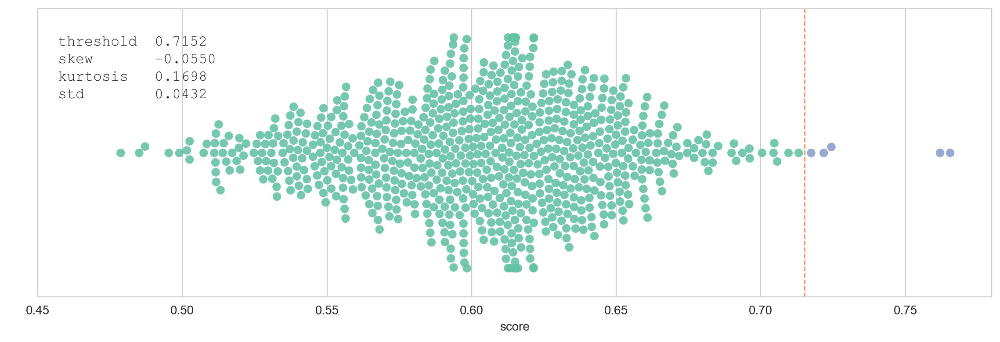

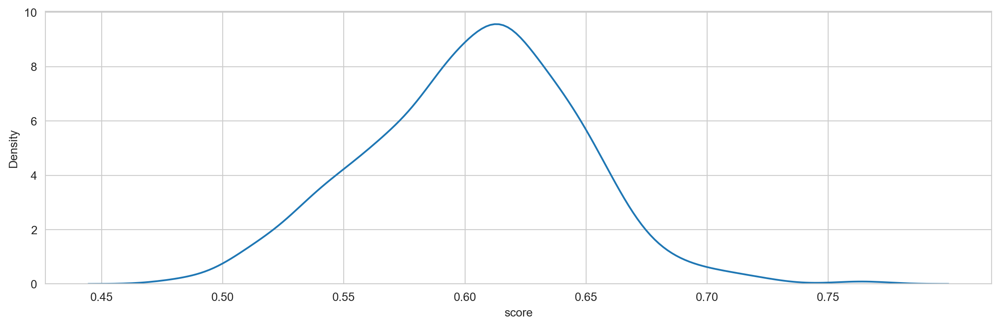

**Article 25**

Why Bank of America and Citigroup Are Trading Higher Today

What happened

Shares of Bank of America (NYSE:BAC) and Citigroup (NYSE:C) were trading nearly 4% higher in the final hour of trading Thursday as the broader market rallied from what has been a difficult few weeks.

So what

Like a lot of the market, bank stocks got hit hard on the news about China Evergrande Group (OTC:EGRN.F), and on fears over what the property developer's situation could mean for the Chinese real estate market, which has gotten quite frothy.

The news sent longer-term Treasury yields lower, and bank profits are closely tied to those yields. For that reason, bank stocks have struggled in recent days. However, a recent Bloomberg article revealed that the major U.S. banks do not have any direct lending exposure to Evergrande.

Bank stocks rebounded Thursday as the yield on the 10-year U.S. Treasury bill bounced to 1.41%, the highest it has been since July. Citigroup and Bank of America were slightly outpacing

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,480,MUFJ Financial Group,MUFG,Finance,Major Banks,"Mitsubishi UFJ Financial Group, Inc. (MUFG; 株式会社三菱UFJフィナンシャル・グループ, Kabushiki gaisha Mitsubishi Yūefujei Finansharu Gurūpu) is a Japanese bank holding and financial services company headquartered in Chiyoda, Tokyo, Japan.",0.675425
1,106,BlackRock,BLK,Finance,Investment Managers,"BlackRock, Inc. is an American multinational investment management corporation based in New York City. Founded in 1988, initially as a risk management and fixed income institutional asset manager, BlackRock is by far the world's largest asset manager, with just over $9 trillion in assets under management as of July 2021. BlackRock operates globally with 70 offices in 30 countries and clients in 100 countries.",0.655829
2,142,CBOE Holdings,CBOE,Finance,Investment Banks/Brokers,Cboe Global Markets is an American company that owns the Chicago Board Options Exchange and the stock exchange operator BATS Global Markets.,0.640315
3,690,Tradeweb Markets,TW,Technology Services,Internet Software/Services,"Tradeweb Markets Inc. (Tradeweb) is an international financial services company that builds and operates electronic over-the-counter (OTC) marketplaces for trading fixed income products, ETFs, and derivatives. The company was co-founded in 1996 by Lee Olesky and Jim Toffey. Its customers include banks, asset managers, central banks, pension funds and insurance companies. It is known for having used technology to move the bond-trading market towards greater efficiency and transparency for institutions that trade fixed income and derivatives products.",0.638205
4,52,Annaly Capital Management,NLY,Finance,Real Estate Investment Trusts,"Annaly Capital Management is one of the largest mortgage real estate investment trusts. It is organized in Maryland with its principal office in New York City. The company borrows money, primarily via short term repurchase agreements, and reinvests the proceeds in asset-backed securities. As of December 31, 2019, 93% of the company's assets were mortgage-backed securities issued by either Fannie Mae or Freddie Mac. The company generates profits from the net interest spread between the interest earned from its assets and its borrowing costs, which is amplified from the use of leverage. As of December 31, 2019, the company had a debt-to-equity ratio of 7.2.",0.637501
5,627,SoFi Technologies,SOFI,Finance,Finance/Rental/Leasing,"Social Finance, Inc. (commonly known as SoFi) is an American online personal finance company. A mobile-first service based in San Francisco, SoFi provides a suite of financial products that includes student loan refinancing, mortgages, personal loans, credit card, investing and banking through both their mobile app and desktop interfaces.",0.637252
6,86,Banco Santander (Brasil),BSBR,Finance,Regional Banks,"Banco Santander (Brasil) S.A. is the Brazilian subsidiary of the Spanish Santander Group, headquartered in São Paulo, Brazil. It is the fifth largest banking institution in Brazil, as well as the fifth largest in Latin America, and the largest division of the group outside Europe, accounting for around 30% of its financial results globally by 2019. The bank is listed at the B3 in São Paulo, and at NYSE though ADRs.",0.636615
7,221,Deutsche Bank AG,DB,Finance,Major Banks,"Deutsche Bank AG (German pronunciation: [ˈdɔʏtʃə ˈbaŋk ʔaːˈɡeː]) is a German multinational investment bank and financial services company headquartered in Frankfurt, Germany, and dual-listed on the Frankfurt Stock Exchange and the New York Stock Exchange. The company is a universal bank with four major divisions: Investment Bank, Corporate Bank, Private Bank and Asset Management (DWS). Its investment banking operations often command substantial deal flow.",0.635751
8,477,Morgan Stanley,MS,Finance,Investment Banks/Brokers,"Morgan Stanley is an American multinational investment bank and financial services company headquartered at 158

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
14,168,Citigroup,C,Finance,Financial Conglomerates,"Citigroup Inc. or Citi (stylized as citi) is an American multinational investment bank and financial services corporation headquartered in New York City. The company was formed by the merger of banking giant Citicorp and financial conglomerate Travelers Group in 1998; Travelers was subsequently spun off from the company in 2002. Citigroup owns Citicorp, the holding company for Citibank, as well as several international subsidiaries. Citigroup is incorporated in Delaware. In 2020 it has over $23.6 trillion dollars in assets under custody (AUC)",0.627733
83,87,Bank of America,BAC,Finance,Major Banks,"The Bank of America Corporation (simply referred to as Bank of America, often abbreviated as BofA or BoA) is an American multinational investment bank and financial services holding company headquartered in Charlotte, North Carolina. Founded in San Francisco, Bank of America was formed through NationsBank's acquisition of BankAmerica in 1998. It is the second largest banking institution in the United States, after JPMorgan Chase, and the eighth largest bank in the world. Bank of America is one of the Big Four banking institutions of the United States. It serves approximately 10.73% of all American bank deposits, in direct competition with JPMorgan Chase, Citigroup and Wells Fargo. Its primary financial services revolve around commercial banking, wealth management, and investment banking.",0.594103


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
35,391,Itaú Unibanco,ITUB,Finance,Major Banks,"Banco Itaú Unibanco S.A. is a Brazilian financial services company headquartered in São Paulo, Brazil. Itaú Unibanco was formed through the merger of Banco Itaú and Unibanco in 2008. It is the largest banking institution in Brazil, as well as the largest in Latin America and in the Southern Hemisphere, and the seventy-first largest bank in the world. It is also one of twenty most valuable banks in the world. The bank is listed at the B3 in São Paulo and in NYSE in New York.",0.612031
54,84,Banco Bradesco S.A. – Preferred Shares,BBD,Finance,Major Banks,"Banco Bradesco S.A. is a Brazilian financial services company headquartered in Osasco, in the state of São Paulo, Brazil. It is the third largest banking institution in Brazil, as well as the third largest in Latin America, and the seventy-ninth largest bank in the world. It is also one of fifty most valuable banks in the world. The bank is listed at the B3 in São Paulo, where it is part of the Índice Bovespa, in the New York Stock Exchange and in the Madrid Stock Exchange.",0.604950


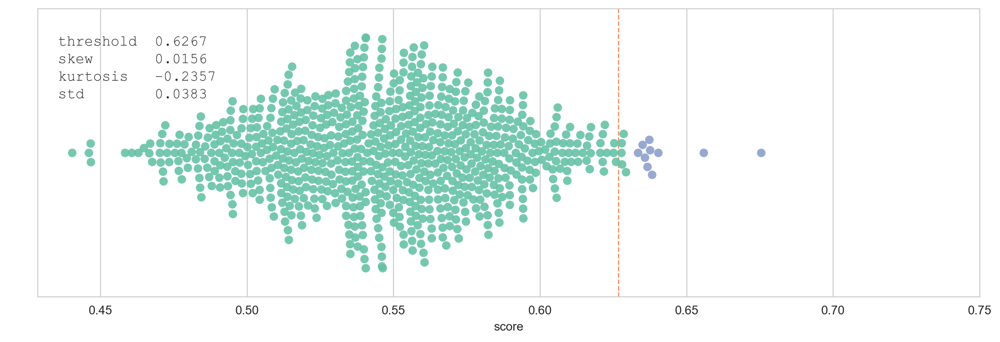

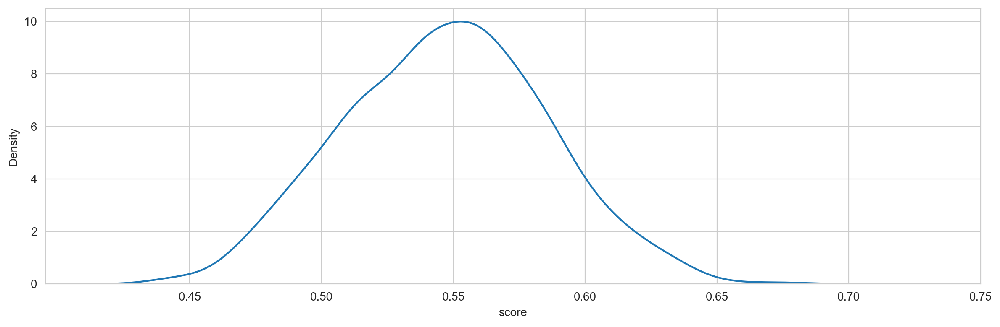

**Article 26**

Itaú Unibanco Holding S.A. (NYSE:ITUB) Short Interest Down 19.6% in August

Itaú Unibanco Holding S.A. (NYSE:ITUB) saw a significant decline in short interest in the month of August. As of August 31st, there was short interest totalling 20,100,000 shares, a decline of 19.6% from the August 15th total of 25,000,000 shares. Based on an average trading volume of 35,920,000 shares, the days-to-cover ratio is currently 0.6 days. Approximately 0.4% of the shares of the company are short sold.

Hedge funds have recently made changes to their positions in the company. Sageworth Trust Co acquired a new position in shares of Itaú Unibanco during the 1st quarter worth approximately $36,000. SRS Capital Advisors Inc. purchased a new stake in Itaú Unibanco in the 2nd quarter valued at $46,000. Platinum Investment Management Ltd. grew its holdings in Itaú Unibanco by 44.5% in the 1st quarter. Platinum Investment Management Ltd. now owns 9,805 shares of the bank's stock valued at $49,000 after buying

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,86,Banco Santander (Brasil),BSBR,Finance,Regional Banks,"Banco Santander (Brasil) S.A. is the Brazilian subsidiary of the Spanish Santander Group, headquartered in São Paulo, Brazil. It is the fifth largest banking institution in Brazil, as well as the fifth largest in Latin America, and the largest division of the group outside Europe, accounting for around 30% of its financial results globally by 2019. The bank is listed at the B3 in São Paulo, and at NYSE though ADRs.",0.774585
1,482,Nasdaq OMX Group,NDAQ,Finance,Investment Banks/Brokers,"Nasdaq, Inc. is an American multinational financial services corporation that owns and operates three stock exchanges in the United States: the namesake Nasdaq stock exchange, the Philadelphia Stock Exchange, and the Boston Stock Exchange, and seven European stock exchanges: Nasdaq Copenhagen, Nasdaq Helsinki, Nasdaq Iceland, Nasdaq Riga, Nasdaq Stockholm, Nasdaq Tallinn, and Nasdaq Vilnius. It is headquartered in New York City, and its president and chief executive officer is Adena Friedman.",0.756666
2,690,Tradeweb Markets,TW,Technology Services,Internet Software/Services,"Tradeweb Markets Inc. (Tradeweb) is an international financial services company that builds and operates electronic over-the-counter (OTC) marketplaces for trading fixed income products, ETFs, and derivatives. The company was co-founded in 1996 by Lee Olesky and Jim Toffey. Its customers include banks, asset managers, central banks, pension funds and insurance companies. It is known for having used technology to move the bond-trading market towards greater efficiency and transparency for institutions that trade fixed income and derivatives products.",0.753698
3,391,Itaú Unibanco,ITUB,Finance,Major Banks,"Banco Itaú Unibanco S.A. is a Brazilian financial services company headquartered in São Paulo, Brazil. Itaú Unibanco was formed through the merger of Banco Itaú and Unibanco in 2008. It is the largest banking institution in Brazil, as well as the largest in Latin America and in the Southern Hemisphere, and the seventy-first largest bank in the world. It is also one of twenty most valuable banks in the world. The bank is listed at the B3 in São Paulo and in NYSE in New York.",0.753572
4,85,Banco Macro,BMA,Finance,Regional Banks,"Banco Macro is the second largest domestically-owned private bank in Argentina, and the sixth-largest by deposits and lending.",0.745812
5,273,Evercore,EVR,Finance,Investment Banks/Brokers,"Evercore Inc., formerly known as Evercore Partners, is a global independent investment banking advisory firm founded in 1995 by Roger Altman, David Offensend, and Austin Beutner. Evercore's Investment Banking business advises its clients on mergers and acquisitions, divestitures, restructurings, financings, public offerings, private placements and other strategic transactions and also provides institutional investors with macro and fundamental equity research, sales and trading execution. Evercore's Investment Management business comprises wealth management, institutional asset management and private equity investing. Evercore serves clients from 28 offices in North America, Europe, South America and Asia. Since 1995, the firm has advised on more than $3 trillion of merger, acquisition, re",0.745700
6,121,Brookfield Infrastructure Partners,BIP,Utilities,Alternative Power Generation,"Brookfield Infrastructure Partners L.P. is a publicly traded limited partnership with corporate headquarters in Toronto, Canada, that engages in the acquisition and management of infrastructure assets on a global basis. Until a spin-off in January 2008, Brookfield Infrastructure was an operating unit of Brookfield Asset Management, which retains a 30 percent ownership and acts as the partnership's general manager. The company's assets carried a book value of US$21.3 billion, on December 31, 2016.",0.743323
7,641,SS&C Technologies Holdings,SSNC,Technology Services,Info

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
118,84,Banco Bradesco S.A. – Preferred Shares,BBD,Finance,Major Banks,"Banco Bradesco S.A. is a Brazilian financial services company headquartered in Osasco, in the state of São Paulo, Brazil. It is the third largest banking institution in Brazil, as well as the third largest in Latin America, and the seventy-ninth largest bank in the world. It is also one of fifty most valuable banks in the world. The bank is listed at the B3 in São Paulo, where it is part of the Índice Bovespa, in the New York Stock Exchange and in the Madrid Stock Exchange.",0.688314
275,87,Bank of America,BAC,Finance,Major Banks,"The Bank of America Corporation (simply referred to as Bank of America, often abbreviated as BofA or BoA) is an American multinational investment bank and financial services holding company headquartered in Charlotte, North Carolina. Founded in San Francisco, Bank of America was formed through NationsBank's acquisition of BankAmerica in 1998. It is the second largest banking institution in the United States, after JPMorgan Chase, and the eighth largest bank in the world. Bank of America is one of the Big Four banking institutions of the United States. It serves approximately 10.73% of all American bank deposits, in direct competition with JPMorgan Chase, Citigroup and Wells Fargo. Its primary financial services revolve around commercial banking, wealth management, and investment banking.",0.665917


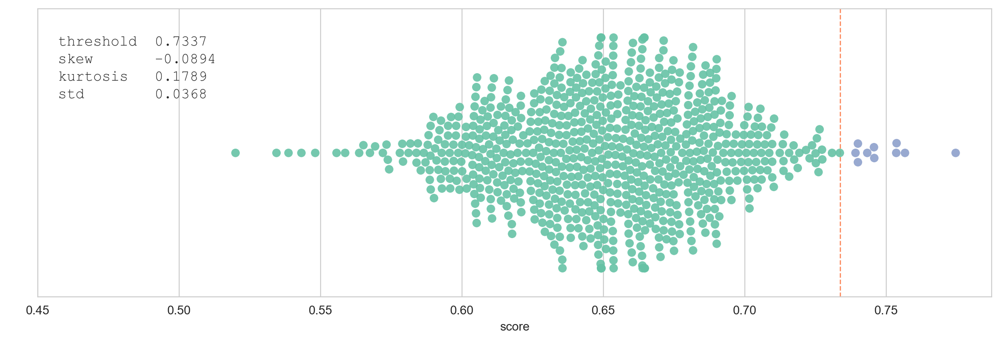

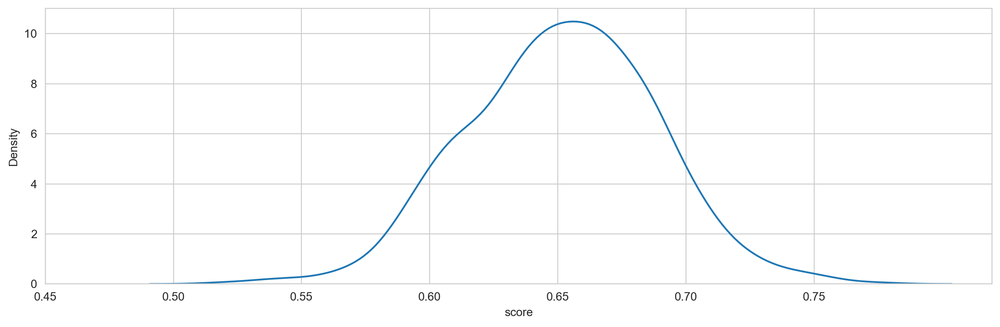

**Article 27**

Moderna CEO Predicts Pandemic Could End in 2022: Here's Why the Stock Could Plunge If He's Right

Key Points
1. Moderna's CEO predicts the pandemic could end in the second half of 2022.
2. The biotech's COVID-19 vaccine sales will likely decline significantly in a post-pandemic world.
3. Moderna only has one other pipeline program that's close to moving into late-stage testing.

When will the pandemic be over and life return to normal? Moderna (NASDAQ:MRNA) CEO Stéphane Bancel thinks it could happen in 2022. In an interview with Swiss newspaper Neue Zuercher Zeitung, Bancel expressed his view that COVID-19 vaccines could help usher in a return to normalcy in the second half of next year. 

People across the world will cheer if Bancel's prediction comes true. However, Moderna's shareholders might not join in the celebration. Here's why the vaccine stock could plunge if Bancel is right that the pandemic will be over next year.

The probability of declining sales 

Moderna expects to rake

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,470,Moderna,MRNA,Health Technology,Biotechnology,"Moderna, Inc (/məˈdɜːrnə/ mə-DUR-nə) is an American pharmaceutical and biotechnology company based in Cambridge, Massachusetts. It focuses on vaccine technologies based on messenger RNA (mRNA). Moderna's vaccine platform inserts synthetic nucleoside-modified messenger RNA (modRNA) into human cells using a coating of lipid nanoparticles. This mRNA then reprograms the cells to prompt immune responses. Moderna develops mRNA therapeutic vaccines that are delivered in lipid nanoparticles, using mRNA with pseudouridine nucleosides. Candidates are designed to have improved folding and translation efficiency via insertional mutagenesis.",0.726696
1,101,Biogen,BIIB,Health Technology,Biotechnology,"Biogen Inc. is an American multinational biotechnology company based in Cambridge, Massachusetts, specializing in the discovery, development, and delivery of therapies for the treatment of neurological diseases to patients worldwide.",0.718164
2,103,BioNTech SE,BNTX,Health Technology,Biotechnology,"BioNTech SE (/ˌbaɪ.ɒnˈtɛk/ BYE-on-TEK or /ˌbiː.ɒnˈtɛk/ BEE-on-TEK; short for Biopharmaceutical New Technologies) is a German biotechnology company based in Mainz that develops and manufactures active immunotherapies for patient-specific approaches to the treatment of diseases. It develops pharmaceutical candidates based on messenger ribonucleic acid (mRNA) for use as individualized cancer immunotherapies, as vaccines against infectious diseases and as protein replacement therapies for rare diseases, and also engineered cell therapy, novel antibodies and small molecule immunomodulators as treatment options for cancer.",0.711723
3,725,Vertex Pharmaceuticals,VRTX,Health Technology,Biotechnology,"Vertex Pharmaceuticals, Inc. is an American biopharmaceutical company based in Boston, Massachusetts. It was one of the first biotech firms to use an explicit strategy of rational drug design rather than combinatorial chemistry. It maintains headquarters in South Boston, Massachusetts, and three research facilities, in San Diego, California, and Milton Park, near Oxford, England.",0.708510
4,776,Zoetis,ZTS,Health Technology,Pharmaceuticals: Generic,"Zoetis Inc. (/zō-EH-tis/) is an American drug company, the world's largest producer of medicine and vaccinations for pets and livestock. The company was a subsidiary of Pfizer, the world's largest drug maker, but with Pfizer's spinoff of its 83% interest in the firm it is now a completely independent company. The company directly markets the products in approximately 45 countries, and sells the products in more than 100 countries. Operations outside the United States accounted for 50% of the total revenue. Contemporaneous with the spinoff in June 2013 S&P Dow Jones Indices announced that Zoetis would replace First Horizon National Corporation in the S&P 500 stock market index.",0.706593
5,374,Inovio Pharmaceuticals In,INO,Health Technology,Medical Specialties,"Inovio Pharmaceuticals is an American biotechnology company focused on the discovery, development, and commercialization of synthetic DNA products for treating cancers and infectious diseases. In April 2020, Inovio was among some 100 companies, academic centers, or research organizations developing a vaccine candidate for treating people infected with COVID-19, with more than 170 total vaccine candidates in development (June 2020).",0.701502
6,45,Amicus Therapeutics,FOLD,Health Technology,Biotechnology,"Amicus Therapeutics is a public American biopharmaceutical company based in Philadelphia, PA. The company went public in 2007 under the NASDAQ trading symbol FOLD. This followed a 2006 planned offering and subsequent withdrawal, which would have established the trading symbol as AMTX Prior to their IPO, Amicus was funded by a variety of venture capital firms including Radius Ventures, Canaan Partners and New Enterprise Associates.",0.699282
7,22,Al

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
49,549,Pfizer,PFE,Health Technology,Pharmaceuticals: Major,"Pfizer Inc. (/ˈfaɪzər/ FY-zər) is an American multinational pharmaceutical and biotechnology corporation headquartered on 42nd Street in Manhattan, New York City. The company was established in 1849 in New York by two German immigrants, Charles Pfizer (1824-1906) and his cousin Charles F. Erhart (1821-1891). Pfizer was a component of the Dow Jones Industrial Average stock market index from 2004 to August 2020. The company ranks 64th on the Fortune 500 and 49th on the Forbes Global 2000.",0.639769


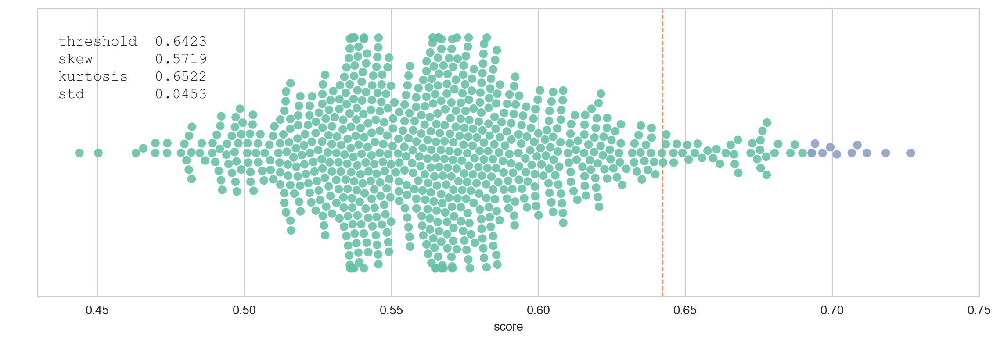

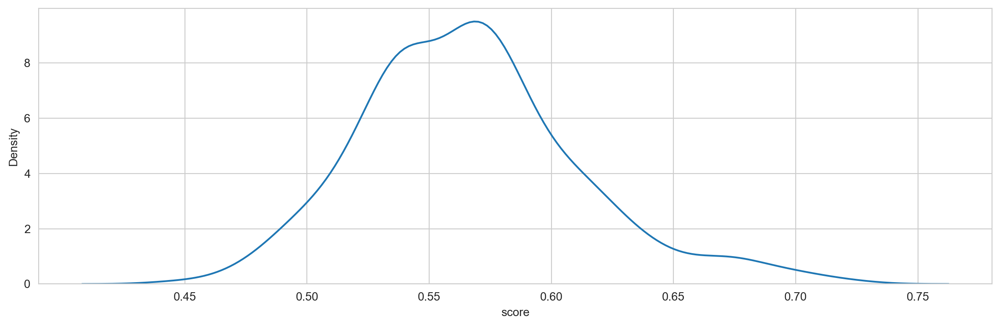

**Article 28**

US panel backs COVID-19 boosters only for seniors, high-risk

WASHINGTON (AP) — Dealing the White House a stinging setback, a government advisory panel overwhelmingly rejected a plan Friday to give Pfizer COVID-19 booster shots across the board, and instead endorsed the extra vaccine dose only for those who are 65 or older or run a high risk of severe disease.

The twin votes represented a heavy blow to the Biden administration’s sweeping effort, announced a month ago, to shore up nearly all Americans’ protection amid the spread of the highly contagious delta variant.

The nonbinding recommendation — from an influential committee of outside experts who advise the Food and Drug Administration — is not the last word. The FDA will consider the group’s advice and make its own decision, probably within days. And the Centers for Disease Control and Prevention is set to weigh in next week.

In a surprising turn, the advisory panel rejected, 16-2, boosters for almost everyone. Members cited a 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,315,Gilead Sciences,GILD,Health Technology,Biotechnology,"Gilead Sciences, Inc. /ˈɡɪliəd/, is an American biopharmaceutical company headquartered in Foster City, California, that focuses on researching and developing antiviral drugs used in the treatment of HIV, hepatitis B, hepatitis C, and influenza, including Harvoni and Sovaldi. Gilead is a member of the NASDAQ Biotechnology Index and the S&P 500.",0.705945
1,460,Merck,MRK,Health Technology,Pharmaceuticals: Major,"Merck & Co., Inc., d.b.a. Merck Sharp & Dohme (MSD) outside the United States and Canada, is an American multinational pharmaceutical company headquartered in Kenilworth, New Jersey. It is named after the Merck family, which set up Merck Group in Germany in 1668. Merck & Co. was established as an American affiliate in 1891. Merck develops and produces medicines, vaccines, biologic therapies and animal health products. It has multiple blockbuster drugs or products each with 2020 revenues including cancer immunotherapy, anti-diabetic medication and vaccines against HPV and chickenpox.",0.677914
2,103,BioNTech SE,BNTX,Health Technology,Biotechnology,"BioNTech SE (/ˌbaɪ.ɒnˈtɛk/ BYE-on-TEK or /ˌbiː.ɒnˈtɛk/ BEE-on-TEK; short for Biopharmaceutical New Technologies) is a German biotechnology company based in Mainz that develops and manufactures active immunotherapies for patient-specific approaches to the treatment of diseases. It develops pharmaceutical candidates based on messenger ribonucleic acid (mRNA) for use as individualized cancer immunotherapies, as vaccines against infectious diseases and as protein replacement therapies for rare diseases, and also engineered cell therapy, novel antibodies and small molecule immunomodulators as treatment options for cancer.",0.670237
3,374,Inovio Pharmaceuticals In,INO,Health Technology,Medical Specialties,"Inovio Pharmaceuticals is an American biotechnology company focused on the discovery, development, and commercialization of synthetic DNA products for treating cancers and infectious diseases. In April 2020, Inovio was among some 100 companies, academic centers, or research organizations developing a vaccine candidate for treating people infected with COVID-19, with more than 170 total vaccine candidates in development (June 2020).",0.666323
4,250,Edwards Lifesciences,EW,Health Technology,Medical Specialties,"Edwards Lifesciences is an American medical technology company headquartered in Irvine, California, specializing in artificial heart valves and hemodynamic monitoring. It developed the SAPIEN transcatheter aortic heart valve made of cow tissue within a balloon-expandable, cobalt-chromium frame, deployed via catheter. The company has manufacturing facilities at the Irvine headquarters, as well as in Draper, Utah; Costa Rica; the Dominican Republic; Puerto Rico; and Singapore; and is building a new facility due to be completed in 2021 in Limerick, Ireland.",0.665758
5,510,Novartis AG,NVS,Health Technology,Pharmaceuticals: Major,"Novartis International AG is a Swiss multinational pharmaceutical company based in Basel, Switzerland. It is one of the largest pharmaceutical companies in the world. Novartis manufactures the drugs clozapine (Clozaril), diclofenac (Voltaren; sold to GlaxoSmithKline in 2015 deal), carbamazepine (Tegretol), valsartan (Diovan),imatinib mesylate (Gleevec/Glivec), cyclosporine (Neoral/Sandimmune), letrozole (Femara), methylphenidate (Ritalin; production ceased 2020), terbinafine (Lamisil), deferasirox (Exjade), and others.",0.665453
6,470,Moderna,MRNA,Health Technology,Biotechnology,"Moderna, Inc (/məˈdɜːrnə/ mə-DUR-nə) is an American pharmaceutical and biotechnology company based in Cambridge, Massachusetts. It focuses on vaccine technologies based on messenger RNA (mRNA). Moderna's vaccine platform inserts synthetic nucleoside-modified messenger RNA (modRNA) into human cells using a coating of lipid nanoparticles. This mRNA then reprog

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
18,549,Pfizer,PFE,Health Technology,Pharmaceuticals: Major,"Pfizer Inc. (/ˈfaɪzər/ FY-zər) is an American multinational pharmaceutical and biotechnology corporation headquartered on 42nd Street in Manhattan, New York City. The company was established in 1849 in New York by two German immigrants, Charles Pfizer (1824-1906) and his cousin Charles F. Erhart (1821-1891). Pfizer was a component of the Dow Jones Industrial Average stock market index from 2004 to August 2020. The company ranks 64th on the Fortune 500 and 49th on the Forbes Global 2000.",0.643521


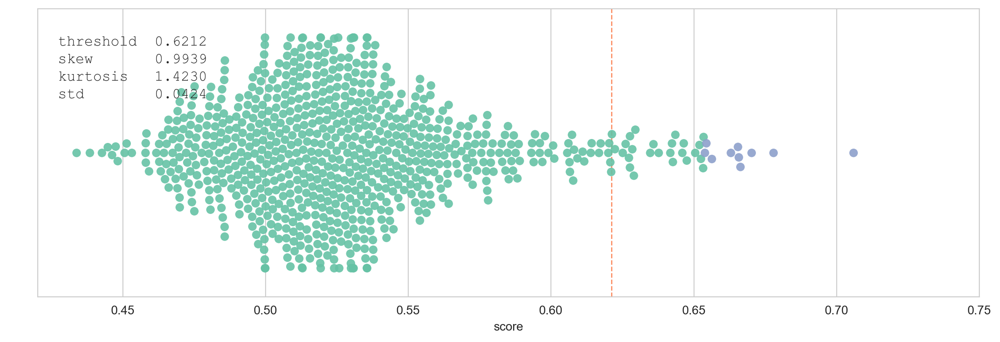

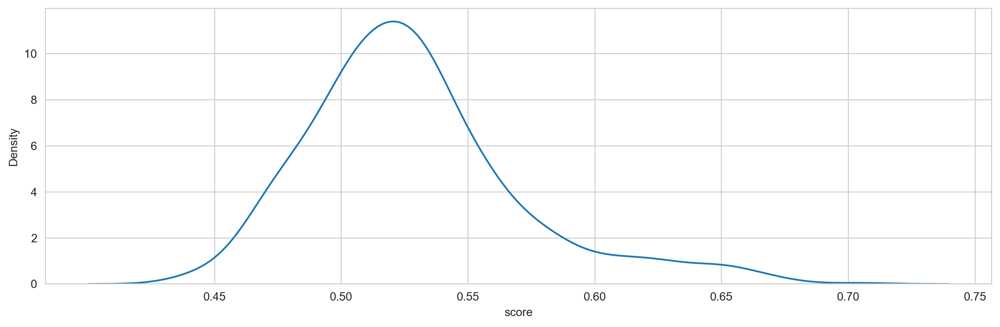

**Article 29**

Energy Transfer earnings climb as natgas pipeline revenues jump

NEW YORK, Aug 3 (Reuters) - Energy Transfer LP on Tuesday reported an increase in quarterly net income, driven by gains in its intrastate natural gas pipeline and storage business as well as natural gas liquids unit.

Energy Transfer was among the biggest winners after Winter Storm Uri knocked out power and halted distribution of natural gas in Texas in February. The company had said it expected to gain roughly $2.4 billion due to the storm.

In the second quarter, adjusted earnings in the intrastate transportation segment climbed 20% as the company gained $52 million in transportation fees due to revenues of $39 million related to Winter Storm Uri.

NGL and refined products transportation and services adjusted earnings rose 9.2%.

Energy Transfer said it began service on its Cushing to Nederland expansion project in June, which utilizes a crude oil pipeline previously servicing the Permian basin of Texas and New Mexico, 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,265,EQT Corporation,EQT,Energy Minerals,Oil & Gas Production,"EQT Corporation is an American energy company engaged in hydrocarbon exploration and pipeline transport. It is headquartered in EQT Plaza in Pittsburgh, Pennsylvania. EQT is the largest natural gas producer in the Appalachian Basin with 19.802 trillion cubic feet equivalent of proved reserves across approximately 1.8 million gross acres, including approximately 1.5 million gross acres in the Marcellus Formation, as of December 31, 2019. Of the company's total proved reserves, 88% are located in the Marcellus Formation and 95% are natural gas.",0.755546
1,54,Antero Resources Corporation,AR,Energy Minerals,Oil & Gas Production,"Antero Resources Corporation is a company engaged in hydrocarbon exploration. It is organized in Delaware and headquartered in Denver, Colorado. The company's reserves are entirely in the Appalachian Basin (92% were in the Marcellus Shale and 8% were in the Utica Shale) and are extracted using hydraulic fracturing. As of December 31, 2020, the company had 17,635 billion cubic feet (499 billion cubic meters) of estimated proved reserves, of which 61% was natural gas, 21% was ethane, 17% was natural gas liquids, and 1% was petroleum. The company is ranked 608th on the Fortune 500.",0.740705
2,544,PBF Energy,PBF,Energy Minerals,Oil Refining/Marketing,"PBF Energy Inc. is a petroleum refiner and supplier of unbranded transportation fuels, heating oils, lubricants, petrochemical feedstocks, and other petroleum products. Headquartered in Parsippany, New Jersey, the company's refineries include facilities in Chalmette, Louisiana, Toledo, Ohio, Port of Paulsboro in Gibbstown, New Jersey, the Delaware City Refinery in Delaware City, the former ExxonMobil refinery in Torrance, California, and the former Shell refinery in Martinez, California. PBF produces a range of products including gasoline, ultra-low-sulfur diesel (ULSD), heating oil, jet fuel, lubricants, petrochemicals and asphalt.",0.738691
3,259,Energy Transfer Equity,ET,Industrial Services,Oil & Gas Pipelines,"Energy Transfer LP is a company engaged in natural gas and propane pipeline transport. It is organized under Delaware state laws and headquartered in Dallas, Texas. It was founded in 1995 by Ray Davis and Kelcy Warren, who remains Chairman and CEO. It owns a 36.4% interest in Dakota Access, LLC, the company responsible for developing the controversial Dakota Access Pipeline.",0.737093
4,342,Hess Corporation,HES,Energy Minerals,Oil & Gas Production,"Hess Corporation (formerly Amerada Hess Corporation) is an American global independent energy company involved in the exploration and production of crude oil and natural gas. It was formed by the merger of Hess Oil and Chemical and Amerada Petroleum in 1968. Leon Hess served as CEO from the early 1960s through 1995, after which his son John B Hess succeeded him as chairman and CEO. Headquartered in New York City, the company ranked 394th in the 2016 annual ranking of Fortune 500 corporations. In 2020, Forbes Global 2000 ranked Hess as the 1,253rd largest public company in the world.",0.732310
5,568,Public Service Enterprise Group,PEG,Utilities,Electric Utilities,"The Public Service Enterprise Group (PSEG) is a publicly traded diversified energy company headquartered in Newark, New Jersey and was established in 1985 with a legacy dating back to 1903. The company's largest subsidiary is Public Service Electric and Gas Company (PSE&G). The Public Service Electric and Gas Company is a regulated gas and electric utility company established in 1928 serving the state of New Jersey and it is New Jersey's oldest and largest investor owned utility company; the Public Service Electric and Gas Company was established in 1928 and was originally a subsidiary of the New-Jersey-based Public Service Corporation.",0.727483
6,513,NRG Energy,NRG,Utilities,Electric Utilities,"NRG Energy, Inc. is a large 

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
15,607,Schlumberger,SLB,Industrial Services,Oilfield Services/Equipment,"Schlumberger Limited (French: [ʃlum.bɛʁˈʒe, ʃlœ̃-]) is an oilfield services company. Schlumberger employees represent more than 140 nationalities working in more than 120 countries. Schlumberger has four principal executive offices located in Paris, Houston, London, and The Hague. Schlumberger is incorporated in Willemstad, Curaçao as Schlumberger N.V. and trades on the New York Stock Exchange, Euronext Paris, the London Stock Exchange and SIX Swiss Exchange. Schlumberger is a Fortune Global 500 company, ranked 287 in 2016, and also listed in Forbes Global 2000, ranked 176 in 2016.",0.713751
37,115,BP plc,BP,Energy Minerals,Integrated Oil,"BP plc (official styling BP p.l.c., formerly The British Petroleum Company plc and BP Amoco plc) is a British multinational oil and gas company headquartered in London, England. It is one of the world's seven oil and gas ""supermajors"". It is a vertically integrated company operating in all areas of the oil and gas industry, including exploration and production, refining, distribution and marketing, power generation, and trading. It also has renewable energy interests in biofuels, wind power, smart grid, and solar technology.",0.699477
55,158,Chevron,CVX,Energy Minerals,Integrated Oil,"Chevron Corporation is an American multinational energy corporation. It was founded in 1984 and is the third largest oil company in America. One of the successor companies of Standard Oil, it is headquartered in San Ramon, California, and active in more than 180 countries. Chevron is engaged in every aspect of the oil and natural gas industries, including hydrocarbon exploration and production; refining, marketing and transport; chemicals manufacturing and sales; and power generation. Chevron is one of the world's largest companies; as of March 2020, it ranked fifteenth in the Fortune 500 with a yearly revenue of $146.5 billion and market valuation of $136 billion. In the 2020 Forbes Global 2000, Chevron was ranked as the 61st-largest public company in the world. It was also one of the Sev",0.690090
68,548,Petroleo Brasileiro S.A.,PBR,Energy Minerals,Integrated Oil,"Petróleo Brasileiro S.A., better known by the acronym Petrobras (Portuguese pronunciation: [ˌpɛtɾoˈbɾas ]), is a state-owned Brazilian multinational corporation in the petroleum industry headquartered in Rio de Janeiro, Brazil. The company's name translates to Brazilian Petroleum Corporation — Petrobras.The company was ranked #120 in the most recent Fortune Global 500 list. In the 2020 Forbes Global 2000, Petrobras was ranked as the 70th -largest public company in the world.",0.686546
119,521,Occidental,OXY,Energy Minerals,Oil & Gas Production,"Occidental Petroleum Corporation (often abbreviated Oxy in reference to its ticker symbol and logo) is an American company engaged in hydrocarbon exploration in the United States, the Middle East, and Colombia as well as petrochemical manufacturing in the United States, Canada, and Chile. It is organized in Delaware and headquartered in Houston. The company is ranked 167th on the Fortune 500 and 669th on the Forbes Global 2000. Arthur Andersen was Oxy's auditors.",0.670934
152,278,Exxon Mobil,XOM,Energy Minerals,Integrated Oil,"Exxon Mobil Corporation, stylized as ExxonMobil, is an American multinational oil and gas corporation headquartered in Irving, Texas. It is the largest direct descendant of John D. Rockefeller's Standard Oil, and was formed on November 30, 1999, by the merger of Exxon (formerly the Standard Oil Company of New Jersey) and Mobil (formerly the Standard Oil Company of New York). ExxonMobil's primary brands are Exxon, Mobil, Esso, and ExxonMobil Chemical. ExxonMobil is incorporated in New Jersey.",0.666584


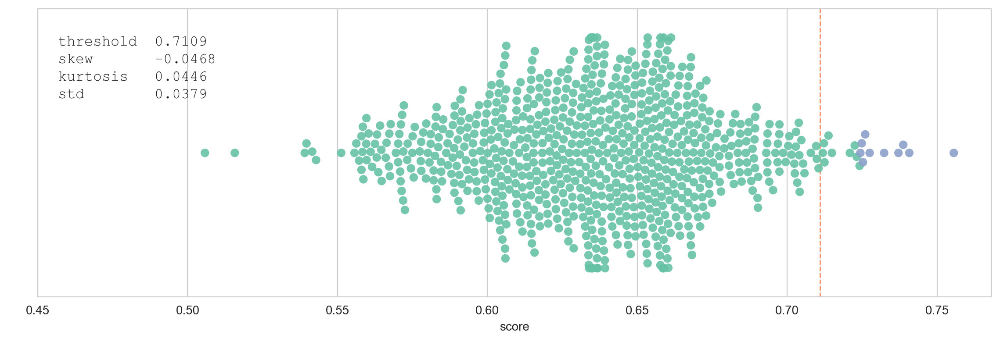

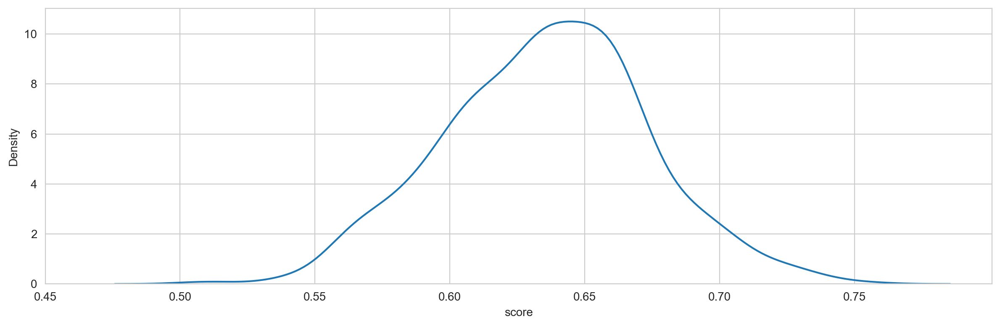

**Article 30**

Schlumberger New Energy Enters into Agreement with EnerVenue for Metal-Hydrogen Stationary Energy Storage Solutions

This strategic investment provides Schlumberger with access to the fast-growing stationary energy storage solutions market through differentiated technology

HOUSTON, September 08, 2021--(BUSINESS WIRE)--Schlumberger New Energy announced today an investment and collaboration agreement to deploy EnerVenue’s uniquely differentiated nickel-hydrogen battery technology, which is a key enabler of stationary energy storage solutions. Schlumberger New Energy and EnerVenue will work together to progress large-scale deployment of nickel-hydrogen battery technology across selected global markets.

Energy storage solutions are critical to the evolution of the energy mix as the energy transition demands greater contribution from renewable sources. The focus on expanding electrification is accelerating the need for large scale deployment of safe, cost effective, sustainable and reliab

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,172,Cloudera,CLDR,Technology Services,Packaged Software,"Cloudera, Inc. is a US-based company that provides an enterprise data cloud. Built on open source technology, Cloudera’s platform uses analytics and machine learning to yield insights from data through a secure connection. Cloudera’s platform works across hybrid, multi-cloud and on-premises architectures and provides multi-function analytics throughout the edge to AI data lifecycle.",0.751829
1,303,FuelCell Energy,FCEL,Electronic Technology,Electronic Equipment/Instruments,"FuelCell Energy, Inc. is an American fuel cell power company. It designs, manufactures, operates and services Direct Fuel Cell power plants (a type of molten carbonate fuel cell) that run on natural gas and biogas. Their power plants are not considered ""hydrogen fuel cells"" because their feedstock is not pure hydrogen and the byproducts of electric generation include carbon dioxide. As one of the biggest publicly traded fuel cell manufacturers in the U.S., the company operates over 50 plants all over the world. It operates the world’s largest fuel cell park, Gyeonggi Green Energy Fuel cell park, which is located in South Korea. The park consists of 21 power plants providing 59 Megawatt of electricity plus district heating to a number of customers in South Korea. It also operates the larges",0.744340
2,513,NRG Energy,NRG,Utilities,Electric Utilities,"NRG Energy, Inc. is a large American energy company, headquartered in Houston, Texas. It was formerly the wholesale arm of Northern States Power Company (NSP), which became Xcel Energy, but became independent in 2000. NRG Energy is involved in energy generation and retail electricity. Their portfolio includes natural gas generation, coal generation, oil generation, nuclear generation, wind generation, utility scale generation, and distributed solar generation. NRG serves 2.9 million retail customers in Texas, Connecticut, Delaware, Illinois, Maryland, Massachusetts, New Jersey, New York, Pennsylvania, Ohio, and the District of Columbia.",0.737693
3,757,Workday,WDAY,Technology Services,Information Technology Services,"Workday, Inc., is an American on‑demand (cloud-based) financial management and human capital management software vendor. Workday was founded by David Duffield, founder and former CEO of ERP company PeopleSoft, and former PeopleSoft chief strategist Aneel Bhusri following Oracle's hostile takeover of PeopleSoft in 2005. In October 2012, it launched a successful initial public offering that valued the company at $9.5 billion. Competitors include SAP Successfactors, Ceridian and Oracle.",0.725182
4,652,SunPower,SPWR,Producer Manufacturing,Electrical Products,SunPower Corporation (NASDAQ:SPWR) is an American company specializing in solar power generation and energy storage.,0.721599
5,150,ChargePoint Holdings,CHPT,Retail Trade,Specialty Stores,"ChargePoint (formerly Coulomb Technologies) is an American electric vehicle infrastructure company based in Campbell, California. ChargePoint operates the largest online network of independently owned EV charging stations operating in 14 countries and makes the technology used in it.",0.720464
6,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.720122
7,170,Citrix Systems,CTXS,Technology Services,Packaged Software,"Citrix Systems, Inc. is an American multinational software company that provides server, application and desktop virtualization, networking, software as a service (SaaS

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
56,607,Schlumberger,SLB,Industrial Services,Oilfield Services/Equipment,"Schlumberger Limited (French: [ʃlum.bɛʁˈʒe, ʃlœ̃-]) is an oilfield services company. Schlumberger employees represent more than 140 nationalities working in more than 120 countries. Schlumberger has four principal executive offices located in Paris, Houston, London, and The Hague. Schlumberger is incorporated in Willemstad, Curaçao as Schlumberger N.V. and trades on the New York Stock Exchange, Euronext Paris, the London Stock Exchange and SIX Swiss Exchange. Schlumberger is a Fortune Global 500 company, ranked 287 in 2016, and also listed in Forbes Global 2000, ranked 176 in 2016.",0.684677


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
161,158,Chevron,CVX,Energy Minerals,Integrated Oil,"Chevron Corporation is an American multinational energy corporation. It was founded in 1984 and is the third largest oil company in America. One of the successor companies of Standard Oil, it is headquartered in San Ramon, California, and active in more than 180 countries. Chevron is engaged in every aspect of the oil and natural gas industries, including hydrocarbon exploration and production; refining, marketing and transport; chemicals manufacturing and sales; and power generation. Chevron is one of the world's largest companies; as of March 2020, it ranked fifteenth in the Fortune 500 with a yearly revenue of $146.5 billion and market valuation of $136 billion. In the 2020 Forbes Global 2000, Chevron was ranked as the 61st-largest public company in the world. It was also one of the Sev",0.658140
218,259,Energy Transfer Equity,ET,Industrial Services,Oil & Gas Pipelines,"Energy Transfer LP is a company engaged in natural gas and propane pipeline transport. It is organized under Delaware state laws and headquartered in Dallas, Texas. It was founded in 1995 by Ray Davis and Kelcy Warren, who remains Chairman and CEO. It owns a 36.4% interest in Dakota Access, LLC, the company responsible for developing the controversial Dakota Access Pipeline.",0.647297
290,115,BP plc,BP,Energy Minerals,Integrated Oil,"BP plc (official styling BP p.l.c., formerly The British Petroleum Company plc and BP Amoco plc) is a British multinational oil and gas company headquartered in London, England. It is one of the world's seven oil and gas ""supermajors"". It is a vertically integrated company operating in all areas of the oil and gas industry, including exploration and production, refining, distribution and marketing, power generation, and trading. It also has renewable energy interests in biofuels, wind power, smart grid, and solar technology.",0.636919
307,548,Petroleo Brasileiro S.A.,PBR,Energy Minerals,Integrated Oil,"Petróleo Brasileiro S.A., better known by the acronym Petrobras (Portuguese pronunciation: [ˌpɛtɾoˈbɾas ]), is a state-owned Brazilian multinational corporation in the petroleum industry headquartered in Rio de Janeiro, Brazil. The company's name translates to Brazilian Petroleum Corporation — Petrobras.The company was ranked #120 in the most recent Fortune Global 500 list. In the 2020 Forbes Global 2000, Petrobras was ranked as the 70th -largest public company in the world.",0.634322
468,278,Exxon Mobil,XOM,Energy Minerals,Integrated Oil,"Exxon Mobil Corporation, stylized as ExxonMobil, is an American multinational oil and gas corporation headquartered in Irving, Texas. It is the largest direct descendant of John D. Rockefeller's Standard Oil, and was formed on November 30, 1999, by the merger of Exxon (formerly the Standard Oil Company of New Jersey) and Mobil (formerly the Standard Oil Company of New York). ExxonMobil's primary brands are Exxon, Mobil, Esso, and ExxonMobil Chemical. ExxonMobil is incorporated in New Jersey.",0.610301
553,521,Occidental,OXY,Energy Minerals,Oil & Gas Production,"Occidental Petroleum Corporation (often abbreviated Oxy in reference to its ticker symbol and logo) is an American company engaged in hydrocarbon exploration in the United States, the Middle East, and Colombia as well as petrochemical manufacturing in the United States, Canada, and Chile. It is organized in Delaware and headquartered in Houston. The company is ranked 167th on the Fortune 500 and 669th on the Forbes Global 2000. Arthur Andersen was Oxy's auditors.",0.594441


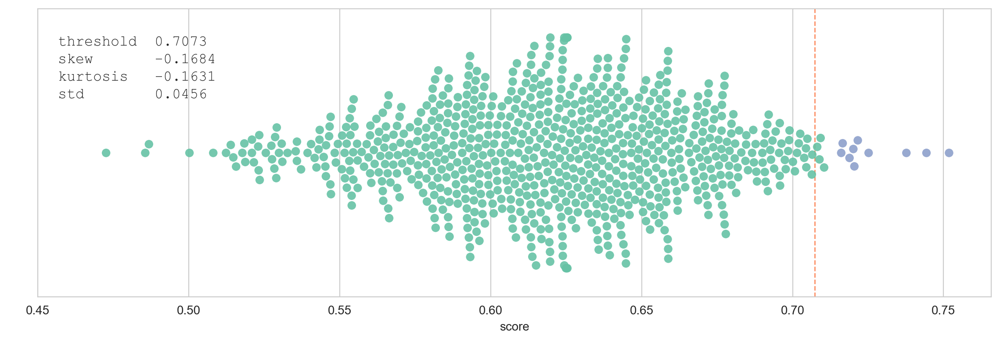

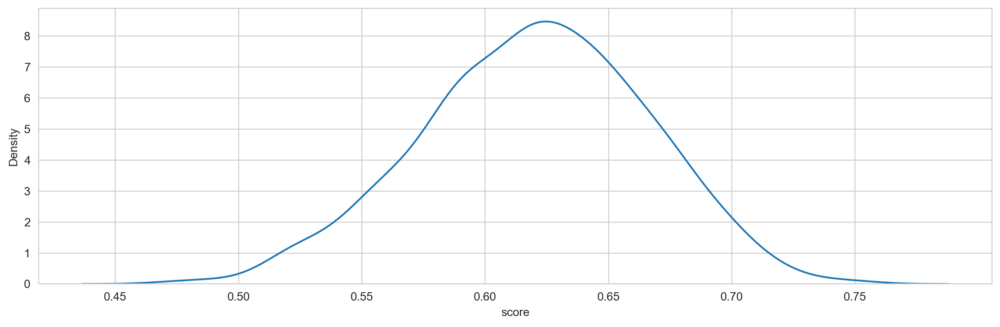

**Article 31**

Why Alcoa Stock Is Soaring This Week and May Not Stop

Alumina prices are roaring back after months, and that could significantly boost Alcoa's profits.

Key Points
1. An unfortunate incident has sent alumina prices roaring, which is excellent news for Alcoa.

What happened

Shares of aluminum giant Alcoa (NYSE:AA) are racing higher and are up 9.8% so far this week, as of early Friday.  It's a stunning recovery after the stock's steep 16.7% decline just over a week ago. What's with all the volatility?

So what

As a commodity stock, Alcoa shares ebb and flow with commodity prices. Prices of aluminum have fluctuated dramatically in recent days after a heady rally this year, and so has the stock price.

For example, prices in Shanghai hit 13-year highs on Aug. 17 as China -- the world's largest aluminum producer -- curbed production to cut greenhouse gas emissions. Barely two days later, China reported slower than-expected industrial production numbers for June, triggering fears of a mel

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,430,Li Auto Inc.,LI,Producer Manufacturing,Auto Parts: OEM,"Li Auto Inc., also known as Li Xiang, is a Chinese electric vehicle manufacturer headquartered in Beijing, with manufacturing facilities in Changzhou.",0.679844
1,188,Companhia Siderurgica Nacional,SID,Non-Energy Minerals,Steel,"Companhia Siderúrgica Nacional (CSN) (en: National Siderurgy Company) is the largest fully integrated steel producer in Brazil and one of the largest in Latin America in terms of crude steel production. Its main plant is located in the city of Volta Redonda, in the state of Rio de Janeiro. Its current CEO is Benjamin Steinbruch.",0.667478
2,98,BHP Billiton,BHP,Non-Energy Minerals,Other Metals/Minerals,"BHP, formerly known as BHP Billiton, is the trading entity of BHP Group Limited and BHP Group plc, an Anglo-Australian multinational mining, metals and petroleum dual-listed public company headquartered in Melbourne, Victoria, Australia. The Broken Hill Proprietary Company was founded on 16 July 1885 in the mining town of Silverton, New South Wales. By 2017, BHP was the world's largest mining company, based on market capitalisation, and was Melbourne's third-largest company by revenue.",0.665212
3,716,Vale,VALE,Non-Energy Minerals,Steel,"Vale S.A. (Portuguese pronunciation: [ˈvali]) is a Brazilian multinational corporation engaged in metals and mining and one of the largest logistics operators in Brazil. Vale, formerly Companhia Vale do Rio Doce (the Sweet River Valley Company, referring to the Doce River), is the largest producer of iron ore and nickel in the world. Vale also produces manganese, ferroalloys, copper, bauxite, potash, kaolin, and cobalt, currently operating nine hydroelectricity plants, and a large network of railroads, ships, and ports used to transport its products.",0.663352
4,763,Xpeng,XPEV,Consumer Durables,Motor Vehicles,"Xpeng or Xiaopeng Motors (Chinese: 小鹏汽车), also known as XMotors.ai, is a Chinese electric vehicle manufacturer. The company is headquartered in Guangzhou, with offices in Mountain View, California in the US and is publicly traded on the New York Stock Exchange.",0.657890
5,503,Nomura,NMR,Finance,Investment Banks/Brokers,"Nomura Holdings, Inc. (野村ホールディングス株式会社, Nomura hōrudingusu kabushiki gaisha) is a Japanese financial holding company and a principal member of the Nomura Group. It, along with its broker-dealer, banking and other financial services subsidiaries, provides investment, financing and related services to individual, institutional, and government customers on a global basis with an emphasis on securities businesses.",0.655403
6,480,MUFJ Financial Group,MUFG,Finance,Major Banks,"Mitsubishi UFJ Financial Group, Inc. (MUFG; 株式会社三菱UFJフィナンシャル・グループ, Kabushiki gaisha Mitsubishi Yūefujei Finansharu Gurūpu) is a Japanese bank holding and financial services company headquartered in Chiyoda, Tokyo, Japan.",0.655002
7,142,CBOE Holdings,CBOE,Finance,Investment Banks/Brokers,Cboe Global Markets is an American company that owns the Chicago Board Options Exchange and the stock exchange operator BATS Global Markets.,0.652654
8,262,Enterprise Products Partners,EPD,Industrial Services,Oil & Gas Pipelines,"Enterprise Products Partners L.P. (NYSE: EPD) is an American midstream natural gas and crude oil pipeline company with headquarters in Houston, Texas.It acquired GulfTerra in September 2004. The company ranked No. 105 in the 2018 Fortune 500 list of the largest United States corporations by total revenue. Dan Duncan (1933–2010) was the majority owner.",0.651098
9,86,Banco Santander (Brasil),BSBR,Finance,Regional Banks,"Banco Santander (Brasil) S.A. is the Brazilian subsidiary of the Spanish Santander Group, headquartered in São Paulo, Brazil. It is the fifth largest banking institution in Brazil, as well as the fifth largest in Latin America, and the largest division of the group outside Europe, accounting for around 30% of its financial results globa

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
30,21,Alcoa,AA,Non-Energy Minerals,Aluminum,"Alcoa Corporation (a portmanteau of Aluminum Company of America) is an American industrial corporation. It is the world's eighth largest producer of aluminum, with corporate headquarters in Pittsburgh, Pennsylvania. Alcoa conducts operations in 10 countries. Alcoa is a major producer of primary aluminum, fabricated aluminum, and alumina combined, through its active and growing participation in all major aspects of the industry: technology, mining, refining, smelting, fabricating, and recycling.",0.632551


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
104,171,Cleveland-Cliffs Inc.,CLF,Non-Energy Minerals,Steel,"Cleveland-Cliffs Inc., formerly Cliffs Natural Resources, is a Cleveland, Ohio-based company that specializes in the mining, beneficiation, and pelletizing of iron ore, as well as steelmaking, including stamping and tooling. It is the largest flat-rolled steel producer in North America.",0.604796
184,302,Freeport,FCX,Non-Energy Minerals,Other Metals/Minerals,"Freeport-McMoRan Inc., often called Freeport, is an American mining company based in the Freeport-McMoRan Center, in Phoenix, Arizona.",0.587173
570,709,United States Steel,X,Non-Energy Minerals,Steel,"United States Steel Corporation (NYSE: X), more commonly known as U.S. Steel, is an American integrated steel producer headquartered in Pittsburgh, Pennsylvania, with production operations in the United States and Central Europe. As of 2018, the company was the world's 38th-largest steel producer and the second-largest in the US, trailing only Nucor Corporation. Though renamed USX Corporation in 1986, the company was renamed United States Steel in 2001 after spinning off its energy business, including Marathon Oil, and other assets from its core steel concern.",0.529165


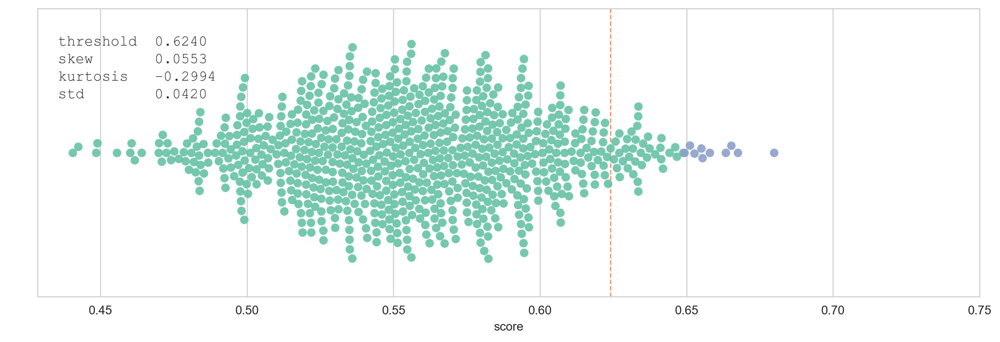

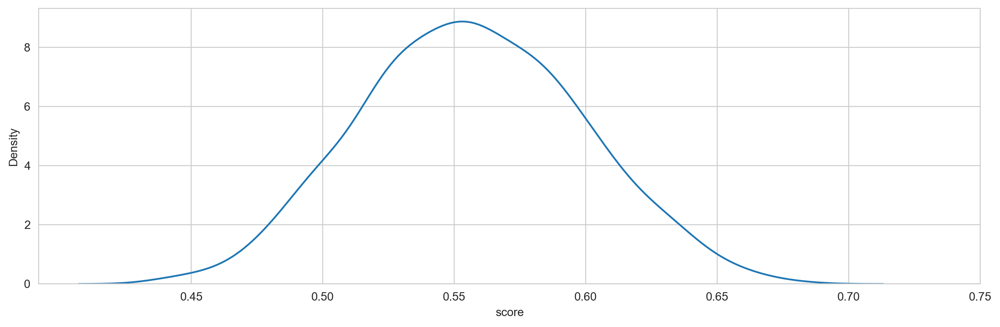

**Article 32**

Freeport-McMoRan - A Coffer Full Of Copper

Introduction

Freeport-McMoRan (FCX) is a pure play copper miner with operations in North America, South America (Peru and Chile), and in Indonesia. FCX’s portfolio of assets includes the Grasberg minerals district in Indonesia, one of the world’s largest copper and gold deposits; and significant mining operations in North America and South America, including the large-scale Morenci minerals district in Arizona and the Cerro Verde operation in Peru.

In a nutshell, I believe that copper is mission-critical for a more electrified world. FCX is well-positioned to capture this demand-driven wave for the 'green metal' from its world-class mines and long-lived reserves. Let FCX speak for themselves below.

[Figure of Freeport-McMoRan FCX 2Q21 Earnings Presentation]

Investment thesis

Favorable demand outlook

Anything with electricity requires some degree of copper be it wind turbines, solar panels, electric vehicles or energy storage. The green 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,632,Southern Copper,SCCO,Non-Energy Minerals,Other Metals/Minerals,"Southern Copper Corporation is a mining company that was founded in 1952. The current incarnation of Southern Copper can be traced to the 2005 acquisition of Southern Peru Copper Corporation by the Mexican copper producer Minera México. The company is a major producer and refiner of copper, molybdenum, zinc, silver, lead, and gold, and operates mines and smelters in Mexico and in Peru, in the Andes mountains southeast of Lima.",0.740792
1,364,Iamgold Corp,IAG,Non-Energy Minerals,Precious Metals,"Iamgold Corporation (formerly Iamgold International African Mining Gold Corporation) is a Canadian company that owns and operates gold mines in Burkina Faso, Suriname and Canada. Headquartered in Toronto, the company was incorporated in 1990, and went public on the Toronto Stock Exchange in 1996, with additional shares being listed on the New York Stock Exchange beginning in 2005. The company formerly owned or had stakes in the Sadiola and Yatela gold mines in Mali, the Mupane gold mine in Botswana, the Niobec niobium mine in Quebec, as well as a royalty in the Diavik Diamond Mine. Iamgold's early exploration work in Western Mali, particularly around Sadiola, was based on the fieldwork of Canadian geologist James C. Snell. M.Tech, P.Eng. Snell provided exploration coordinates to company fo",0.736481
2,764,Yamana Gold,AUY,Non-Energy Minerals,Precious Metals,"Inc. is a Canadian company that owns and operates gold, silver and copper mines in Canada, Chile, Brazil and Argentina. Headquartered in Toronto, the company was founded in 1994 and became listed on the Toronto Stock Exchange in 1995, the New York Stock Exchange in 2007, and the London Stock Exchange in 2020. The company became a gold producer after its 2003 re-restructuring in which Peter Marrone took over as Chief Executive Officer and it merged with Brazilian company Santa Elina Mines Corporation. The combined company was able to use Yamana's access to capital with Santa Elina development properties to bring the Chapada mine into production. From there the company combined with other TSX-listed companies RNC Gold, Desert Sun Mining, Viceroy Exploration, Northern Orion Resources, Meridia",0.723659
3,258,Encana Corporation,OVV,Energy Minerals,Oil & Gas Production,"Ovintiv Inc., formerly Encana Corporation, is a hydrocarbon exploration and production company organized in Delaware and headquartered in Denver, United States. It was founded and headquartered in Calgary, Alberta, and was the largest energy company and largest natural gas producer in Canada. The company was rebranded as Ovintiv and relocated to Denver in 2019–20.",0.723277
4,669,Teck Resources,TECK,Non-Energy Minerals,Other Metals/Minerals,"Teck Resources Limited, known as Teck Cominco until late 2008, is a diversified natural resources company headquartered in Vancouver, British Columbia, that is engaged in mining and mineral development, including coal for the steelmaking industry, copper, zinc, and energy. Secondary products include lead, silver, gold, molybdenum, germanium, indium and cadmium. Teck Resources was formed from the amalgamation of Teck and Cominco in 2001. In the 2020 Forbes Global 2000, Teck Resources was ranked as the 1616th -largest public company in the world.",0.721646
5,496,Newmont Mining,NEM,Non-Energy Minerals,Precious Metals,"Newmont, based in Greenwood Village, Colorado, United States, is the world's largest gold mining company. Incorporated in 1921, it has ownership of gold mines in Nevada, Colorado, Ontario, Quebec, Mexico, the Dominican Republic, Australia, Ghana, Argentina, Peru, and Suriname. In addition to gold, Newmont mines copper, silver, zinc and lead. Newmont has approximately 31,600 employees and contractors worldwide, and is the only gold company in the Standard & Poor's 500.",0.716865
6,412,Kinross Gold Corporation,KGC,Non-Energy Minerals,Precious Met

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
13,302,Freeport,FCX,Non-Energy Minerals,Other Metals/Minerals,"Freeport-McMoRan Inc., often called Freeport, is an American mining company based in the Freeport-McMoRan Center, in Phoenix, Arizona.",0.708622


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
10,171,Cleveland-Cliffs Inc.,CLF,Non-Energy Minerals,Steel,"Cleveland-Cliffs Inc., formerly Cliffs Natural Resources, is a Cleveland, Ohio-based company that specializes in the mining, beneficiation, and pelletizing of iron ore, as well as steelmaking, including stamping and tooling. It is the largest flat-rolled steel producer in North America.",0.710236
22,716,Vale,VALE,Non-Energy Minerals,Steel,"Vale S.A. (Portuguese pronunciation: [ˈvali]) is a Brazilian multinational corporation engaged in metals and mining and one of the largest logistics operators in Brazil. Vale, formerly Companhia Vale do Rio Doce (the Sweet River Valley Company, referring to the Doce River), is the largest producer of iron ore and nickel in the world. Vale also produces manganese, ferroalloys, copper, bauxite, potash, kaolin, and cobalt, currently operating nine hydroelectricity plants, and a large network of railroads, ships, and ports used to transport its products.",0.696132
76,21,Alcoa,AA,Non-Energy Minerals,Aluminum,"Alcoa Corporation (a portmanteau of Aluminum Company of America) is an American industrial corporation. It is the world's eighth largest producer of aluminum, with corporate headquarters in Pittsburgh, Pennsylvania. Alcoa conducts operations in 10 countries. Alcoa is a major producer of primary aluminum, fabricated aluminum, and alumina combined, through its active and growing participation in all major aspects of the industry: technology, mining, refining, smelting, fabricating, and recycling.",0.671370
406,709,United States Steel,X,Non-Energy Minerals,Steel,"United States Steel Corporation (NYSE: X), more commonly known as U.S. Steel, is an American integrated steel producer headquartered in Pittsburgh, Pennsylvania, with production operations in the United States and Central Europe. As of 2018, the company was the world's 38th-largest steel producer and the second-largest in the US, trailing only Nucor Corporation. Though renamed USX Corporation in 1986, the company was renamed United States Steel in 2001 after spinning off its energy business, including Marathon Oil, and other assets from its core steel concern.",0.610750


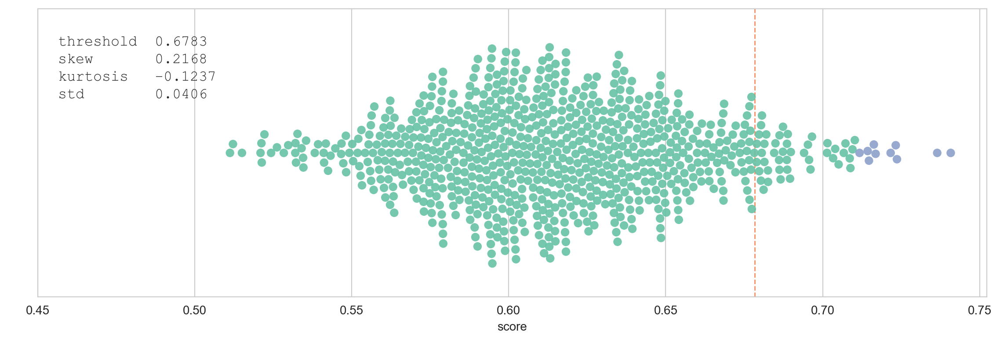

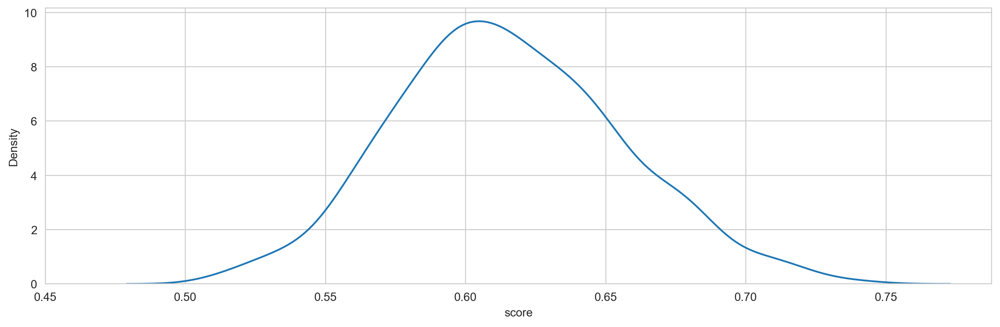

**Article 33**

Cleveland-Cliffs Sticks to ‘Self Sufficiency’ Model

Steelmaker's CEO discusses its recovery from pandemic stock plummet

Lourenco Goncalves, CEO of Cleveland-Cliffs  (CLF) - Get Cleveland-Cliffs Inc Report, recently discussed  the steelmaker’s share price recovery  --  about 800% -- over the past 18 months with  "Mad Money’s" Jim Cramer.

At the start of the pandemic in March 2020 , Cleveland-Cliffs stock tumbled to a low of $3.14 per share. The stock has been trading in the $24 range recently.

Cleveland-Cliffs is a fully integrated and self-sufficient steel producer. The firm has its hands in everything from digging the ore out of the ground to pelletizing of iron ore to stamping out parts made from completed steel.

Cleveland-Cliffs is now the largest flat-rolled steel company and the largest iron ore pellet producer in the U.S. and in North America, holding an industry-leading market position in automotive steel, according to the company’s website.

Goncalves argues that steel con

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,430,Li Auto Inc.,LI,Producer Manufacturing,Auto Parts: OEM,"Li Auto Inc., also known as Li Xiang, is a Chinese electric vehicle manufacturer headquartered in Beijing, with manufacturing facilities in Changzhou.",0.676841
1,148,Cerner,CERN,Technology Services,Information Technology Services,"Cerner Corporation is an American supplier of health information technology (HIT) services, devices, and hardware. As of February 2018, its products were in use at more than 27,000 facilities around the world. The company had more than 29,000 employees globally, with over 13,000 in Kansas City, Missouri. Its headquarters are in the suburb of North Kansas City, Missouri.",0.672687
2,512,Novo Nordisk,NVO,Health Technology,Pharmaceuticals: Major,"Novo Nordisk A/S is a Danish multinational pharmaceutical company headquartered in Bagsværd, Denmark, with production facilities in eight countries, and affiliates or offices in 5 countries. Novo Nordisk is controlled by majority shareholder Novo Holdings A/S which holds approximately 25% of its shares and a supermajority (45%) of its voting shares. Novo Nordisk is a full member of the European Federation of Pharmaceutical Industries and Associations (EFPIA).",0.671235
3,645,Steel Dynamics,STLD,Non-Energy Minerals,Steel,"Steel Dynamics, Inc., sometimes abbreviated as ""SDI"", is an American steel producer based in Fort Wayne, Indiana. With a production capacity of 13 million tons of steel, the company is the 3rd largest producer of carbon steel products in the United States. It is among the most profitable American steel companies in terms of profit margins and operating margin per ton. The company is ranked 299th on the Fortune 500.",0.669558
4,351,Honeywell,HON,Producer Manufacturing,Industrial Conglomerates,"Honeywell International Inc. is an American publicly traded, multinational conglomerate headquartered in Charlotte, North Carolina. It primarily operates in four areas of business: aerospace, building technologies, performance materials and technologies (PMT), and safety and productivity solutions (SPS). Honeywell is a Fortune 100 company, ranked 92nd in 2019. The company has a global workforce of approximately 110,000 workers, with approximately 44,000 employed in the United States. The current chairman and chief executive officer (CEO) is Darius Adamczyk.",0.664438
5,632,Southern Copper,SCCO,Non-Energy Minerals,Other Metals/Minerals,"Southern Copper Corporation is a mining company that was founded in 1952. The current incarnation of Southern Copper can be traced to the 2005 acquisition of Southern Peru Copper Corporation by the Mexican copper producer Minera México. The company is a major producer and refiner of copper, molybdenum, zinc, silver, lead, and gold, and operates mines and smelters in Mexico and in Peru, in the Andes mountains southeast of Lima.",0.663889
6,242,DTE Energy Co,DTE,Utilities,Electric Utilities,"DTE Energy (formerly Detroit Edison until 1996) is a Detroit-based diversified energy company involved in the development and management of energy-related businesses and services in the United States and Canada. Its operating units include an electric utility serving 2.2 million customers and a natural gas utility serving 1.3 million customers in Michigan. The DTE Energy portfolio includes non-utility energy businesses focused on power and industrial projects, energy marketing and trading.",0.657306
7,251,Elanco Animal Health,ELAN,Process Industries,Agricultural Commodities/Milling,"Elanco Animal Health Incorporated is an American pharmaceutical company which produces medicines and vaccinations for pets and livestock. Until 2019, the company was a subsidiary of Eli Lilly and Company, before being divested.",0.653135
8,776,Zoetis,ZTS,Health Technology,Pharmaceuticals: Generic,"Zoetis Inc. (/zō-EH-tis/) is an American drug company, the world's largest producer of medicine and vaccinations for pets and livestock. The 

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
45,171,Cleveland-Cliffs Inc.,CLF,Non-Energy Minerals,Steel,"Cleveland-Cliffs Inc., formerly Cliffs Natural Resources, is a Cleveland, Ohio-based company that specializes in the mining, beneficiation, and pelletizing of iron ore, as well as steelmaking, including stamping and tooling. It is the largest flat-rolled steel producer in North America.",0.638013


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
65,716,Vale,VALE,Non-Energy Minerals,Steel,"Vale S.A. (Portuguese pronunciation: [ˈvali]) is a Brazilian multinational corporation engaged in metals and mining and one of the largest logistics operators in Brazil. Vale, formerly Companhia Vale do Rio Doce (the Sweet River Valley Company, referring to the Doce River), is the largest producer of iron ore and nickel in the world. Vale also produces manganese, ferroalloys, copper, bauxite, potash, kaolin, and cobalt, currently operating nine hydroelectricity plants, and a large network of railroads, ships, and ports used to transport its products.",0.634170
126,709,United States Steel,X,Non-Energy Minerals,Steel,"United States Steel Corporation (NYSE: X), more commonly known as U.S. Steel, is an American integrated steel producer headquartered in Pittsburgh, Pennsylvania, with production operations in the United States and Central Europe. As of 2018, the company was the world's 38th-largest steel producer and the second-largest in the US, trailing only Nucor Corporation. Though renamed USX Corporation in 1986, the company was renamed United States Steel in 2001 after spinning off its energy business, including Marathon Oil, and other assets from its core steel concern.",0.623327


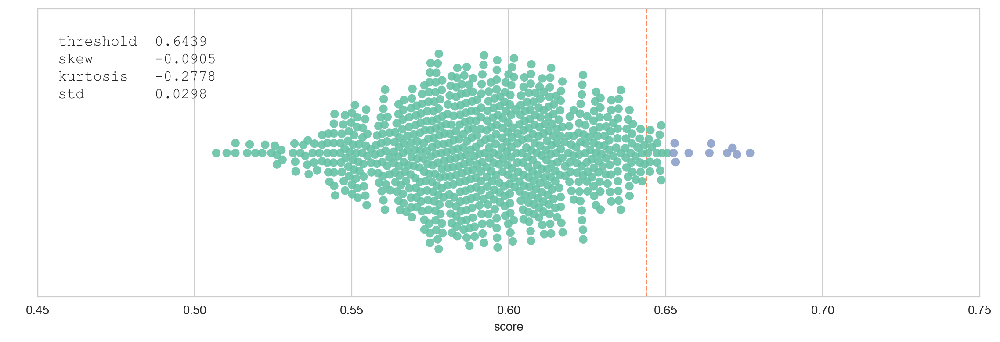

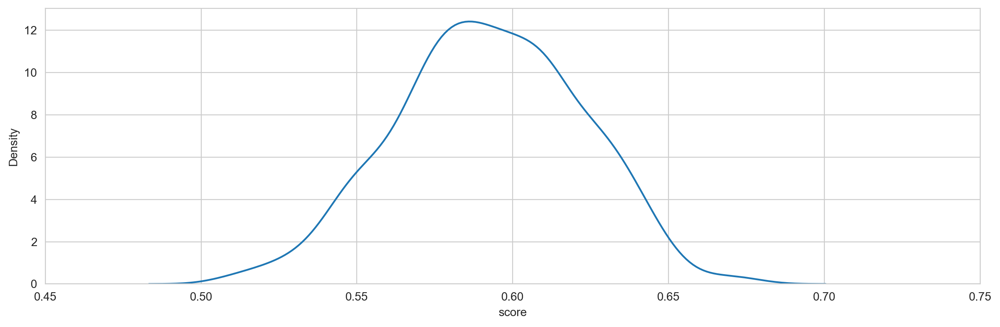

**Article 34**

US Steel Output Spikes 20% YTD on Higher Capacity, Solid Demand

U.S. raw steel production edged down on a weekly comparison basis for the week ending Sep 4 as lower production across Southern and Midwest offset gains in North East and Great Lakes. Capacity utilization — a key metric in the steel industry — remained close to the 85% level amid strong domestic demand.

According to the latest American Iron and Steel Institute ("AISI") weekly report, domestic raw steel production was 1,866,000 net tons for the week ending Sep 4, a 0.4% decrease from production of 1,873,000 net tons for the week ending Aug 28.

Notwithstanding the modest weak-on-weak decline, U.S. steel output remains higher than at the same time last year when shutdowns across major steel-consuming sectors due to the coronavirus pandemic put a crimp on steel demand. Per AISI, output for the reported week represents a 23.5% rise from production of 1,511,000 for the same period a year ago. Domestic steel production is also

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.704139
1,188,Companhia Siderurgica Nacional,SID,Non-Energy Minerals,Steel,"Companhia Siderúrgica Nacional (CSN) (en: National Siderurgy Company) is the largest fully integrated steel producer in Brazil and one of the largest in Latin America in terms of crude steel production. Its main plant is located in the city of Volta Redonda, in the state of Rio de Janeiro. Its current CEO is Benjamin Steinbruch.",0.698120
2,430,Li Auto Inc.,LI,Producer Manufacturing,Auto Parts: OEM,"Li Auto Inc., also known as Li Xiang, is a Chinese electric vehicle manufacturer headquartered in Beijing, with manufacturing facilities in Changzhou.",0.684264
3,513,NRG Energy,NRG,Utilities,Electric Utilities,"NRG Energy, Inc. is a large American energy company, headquartered in Houston, Texas. It was formerly the wholesale arm of Northern States Power Company (NSP), which became Xcel Energy, but became independent in 2000. NRG Energy is involved in energy generation and retail electricity. Their portfolio includes natural gas generation, coal generation, oil generation, nuclear generation, wind generation, utility scale generation, and distributed solar generation. NRG serves 2.9 million retail customers in Texas, Connecticut, Delaware, Illinois, Maryland, Massachusetts, New Jersey, New York, Pennsylvania, Ohio, and the District of Columbia.",0.681635
4,171,Cleveland-Cliffs Inc.,CLF,Non-Energy Minerals,Steel,"Cleveland-Cliffs Inc., formerly Cliffs Natural Resources, is a Cleveland, Ohio-based company that specializes in the mining, beneficiation, and pelletizing of iron ore, as well as steelmaking, including stamping and tooling. It is the largest flat-rolled steel producer in North America.",0.677356
5,645,Steel Dynamics,STLD,Non-Energy Minerals,Steel,"Steel Dynamics, Inc., sometimes abbreviated as ""SDI"", is an American steel producer based in Fort Wayne, Indiana. With a production capacity of 13 million tons of steel, the company is the 3rd largest producer of carbon steel products in the United States. It is among the most profitable American steel companies in terms of profit margins and operating margin per ton. The company is ranked 299th on the Fortune 500.",0.669777
6,483,National Oilwell Varco,NOV,Industrial Services,Oilfield Services/Equipment,"NOV Inc. is an American multinational corporation based in Houston, Texas. It is a leading worldwide provider of equipment and components used in oil and gas drilling and production operations, oilfield services, and supply chain integration services to the upstream oil and gas industry. The company conducts operations in more than 600 locations across six continents, operating through three reporting segments: Rig Technologies, Wellbore Technologies, and Completion & Production Solutions.",0.668155
7,706,Union Pacific,UNP,Transportation,Railroads,"The Union Pacific Corporation (Union Pacific) is a publicly traded railroad holding company. It was incorporated in Utah in 1969 and is headquartered in Omaha, Nebraska. It is the parent company of the current, Delaware-registered, form of the Union Pacific Railroad.",0.664005
8,716,Vale,VALE,Non-Energy Minerals,Steel,"Vale S.A. (Portuguese pronunciation: [ˈvali]) is a Brazilian multinational corporation engaged in metals and mining and one of the largest logistics operator

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
139,709,United States Steel,X,Non-Energy Minerals,Steel,"United States Steel Corporation (NYSE: X), more commonly known as U.S. Steel, is an American integrated steel producer headquartered in Pittsburgh, Pennsylvania, with production operations in the United States and Central Europe. As of 2018, the company was the world's 38th-largest steel producer and the second-largest in the US, trailing only Nucor Corporation. Though renamed USX Corporation in 1986, the company was renamed United States Steel in 2001 after spinning off its energy business, including Marathon Oil, and other assets from its core steel concern.",0.617721


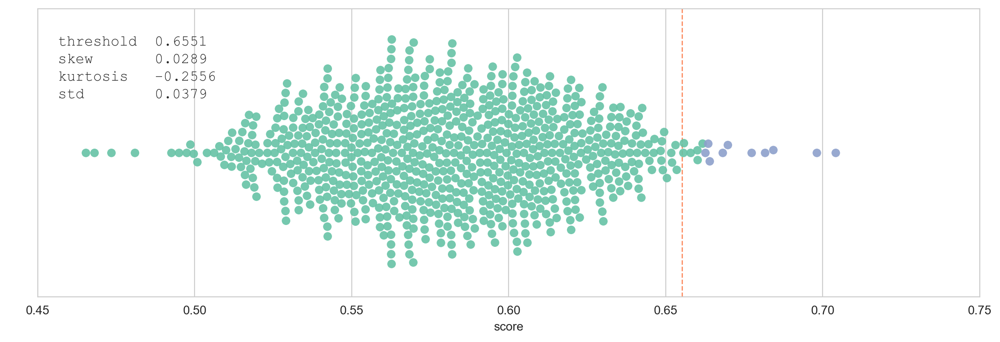

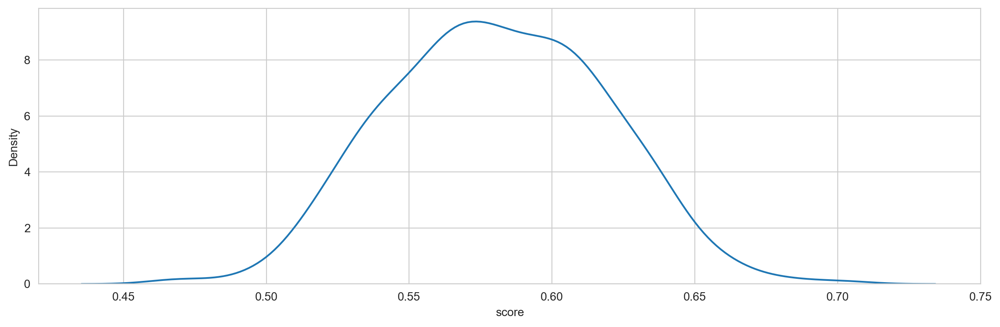

**Article 35**

Mining Firm Responsible for 270-Death Disaster Behind New Canada Fiasco

Before 39 of its workers were stuck underground for 40 hours, the Brazilian firm Vale was behind one of the deadliest mining disasters in history.

After two grueling days trapped underground, most of the 39 workers stuck in a mine in the Canadian city of Sudbury finally climbed to the surface on Tuesday. The grueling rescue operation began after an elevator accident left workers stranded almost 4,000 feet below ground—that’s four times the height of the Eiffel Tower.

While the rest of the workers are expected to escape unharmed, previous employees for the Brazilian firm Vale, which owns the Canadian Totten mine in Sudbury, were not as lucky.

On Jan. 25, 2019, a catastrophic mining dam collapse in Brumadinho, Brazil killed at least 270 people, mostly Vale employees. The collapse unleashed tons of waste into neighboring areas, engulfing nearby offices, farms, and a country house. The accident is considered one of

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,716,Vale,VALE,Non-Energy Minerals,Steel,"Vale S.A. (Portuguese pronunciation: [ˈvali]) is a Brazilian multinational corporation engaged in metals and mining and one of the largest logistics operators in Brazil. Vale, formerly Companhia Vale do Rio Doce (the Sweet River Valley Company, referring to the Doce River), is the largest producer of iron ore and nickel in the world. Vale also produces manganese, ferroalloys, copper, bauxite, potash, kaolin, and cobalt, currently operating nine hydroelectricity plants, and a large network of railroads, ships, and ports used to transport its products.",0.749280
1,412,Kinross Gold Corporation,KGC,Non-Energy Minerals,Precious Metals,"Kinross Gold Corporation is a Canadian-based gold and silver mining company founded in 1993 and headquartered in Toronto, Ontario, Canada. Kinross currently operates seven active gold mines, and was ranked fifth of the ""10 Top Gold-mining Companies"" of 2019 by InvestingNews. The company's mines are located in Brazil, Ghana, Mauritania, Russia and the United States. It trades under the KGC ticker in the New York Stock Exchange, and under K in the Toronto Stock Exchange.",0.717431
2,669,Teck Resources,TECK,Non-Energy Minerals,Other Metals/Minerals,"Teck Resources Limited, known as Teck Cominco until late 2008, is a diversified natural resources company headquartered in Vancouver, British Columbia, that is engaged in mining and mineral development, including coal for the steelmaking industry, copper, zinc, and energy. Secondary products include lead, silver, gold, molybdenum, germanium, indium and cadmium. Teck Resources was formed from the amalgamation of Teck and Cominco in 2001. In the 2020 Forbes Global 2000, Teck Resources was ranked as the 1616th -largest public company in the world.",0.694158
3,764,Yamana Gold,AUY,Non-Energy Minerals,Precious Metals,"Inc. is a Canadian company that owns and operates gold, silver and copper mines in Canada, Chile, Brazil and Argentina. Headquartered in Toronto, the company was founded in 1994 and became listed on the Toronto Stock Exchange in 1995, the New York Stock Exchange in 2007, and the London Stock Exchange in 2020. The company became a gold producer after its 2003 re-restructuring in which Peter Marrone took over as Chief Executive Officer and it merged with Brazilian company Santa Elina Mines Corporation. The combined company was able to use Yamana's access to capital with Santa Elina development properties to bring the Chapada mine into production. From there the company combined with other TSX-listed companies RNC Gold, Desert Sun Mining, Viceroy Exploration, Northern Orion Resources, Meridia",0.691964
4,252,Eldorado Gold Corporation,EGO,Non-Energy Minerals,Precious Metals,"Eldorado Gold Corporation is a Canadian company that owns and operates gold mines in Turkey, Greece and Canada. Since its merger with European Goldfields in 2011 the company has been pursuing the development of the Skouries mine, Olympias mine and Stratoni mine in Greece. The company previously developed and operated gold mines in China, Brazil and Mexico. Headquartered in Vancouver and listed on the Toronto and New York Stock Exchanges, Eldorado Gold has developed and operated assets from several merged companies HRC Developments Corporation, Afcan Mining Corporation, Sino Gold Mining, Brazauro Resources, Integra Gold, as well as European Goldfields.",0.689405
5,98,BHP Billiton,BHP,Non-Energy Minerals,Other Metals/Minerals,"BHP, formerly known as BHP Billiton, is the trading entity of BHP Group Limited and BHP Group plc, an Anglo-Australian multinational mining, metals and petroleum dual-listed public company headquartered in Melbourne, Victoria, Australia. The Broken Hill Proprietary Company was founded on 16 July 1885 in the mining town of Silverton, New South Wales. By 2017, BHP was the world's largest mining company, based on market capitalisation, and was Melbourne's third

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
54,171,Cleveland-Cliffs Inc.,CLF,Non-Energy Minerals,Steel,"Cleveland-Cliffs Inc., formerly Cliffs Natural Resources, is a Cleveland, Ohio-based company that specializes in the mining, beneficiation, and pelletizing of iron ore, as well as steelmaking, including stamping and tooling. It is the largest flat-rolled steel producer in North America.",0.634910
371,709,United States Steel,X,Non-Energy Minerals,Steel,"United States Steel Corporation (NYSE: X), more commonly known as U.S. Steel, is an American integrated steel producer headquartered in Pittsburgh, Pennsylvania, with production operations in the United States and Central Europe. As of 2018, the company was the world's 38th-largest steel producer and the second-largest in the US, trailing only Nucor Corporation. Though renamed USX Corporation in 1986, the company was renamed United States Steel in 2001 after spinning off its energy business, including Marathon Oil, and other assets from its core steel concern.",0.567097


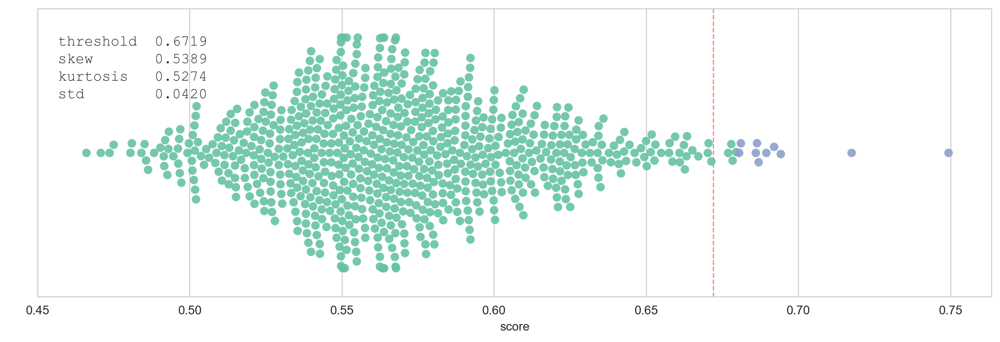

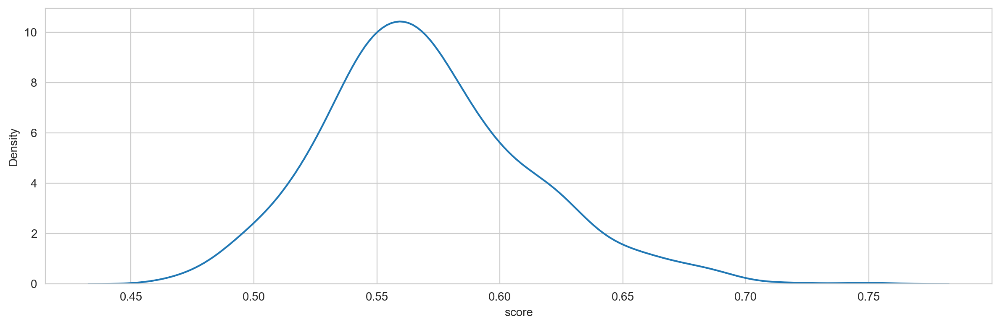

**Article 36**

Kohls CEO talks Amazon partnership, turning business into ‘lifestyle concept’

Michelle Gass prides strong partnerships as 'hallmark' of company

Retail giant Kohl's has been on a roll in the markets after a blowout earnings report and CEO Michelle Gass tagged the company’s success on its lifestyle approach on "The Claman Countdown."

Kohl's partnerships with major brands like Sephora, Lego and others have increased foot traffic in stores which Gass explained drives relevancy and widens the department store's demographic.

"We’ve been on a mission to really evolve and… transform the customer experience," she said. "Take everything that’s been great about Kohl's for years – we have phenomenal private brands like Sonoma, Croft & Barrow and the like – but also to bring more relevancy with new brands and new partnerships."

Gass mentioned Kohl's partnership with Amazon which has allowed customers to make returns and exchanges in-store, furthermore driving those relevancy and traffic factor

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,415,Kohl’s,KSS,Retail Trade,Department Stores,"Kohl's is an American department store retail chain, operated by Kohl's Corporation. As of February 2013 it is the largest department store chain in the United States, with 1,158 locations, operating stores in every U.S. state except Hawaii. The company was founded by Polish immigrant Maxwell Kohl, who opened a corner grocery store in Milwaukee, Wisconsin in 1927. It went on to become a successful chain in the local area, and in 1962 the company branched out by opening its first department store. British American Tobacco Company took a controlling interest in the company in 1972 while still managed by the Kohl Family, and in 1979, the corporation was sold to BATUS Inc. A group of investors purchased the company in 1986 from British American Tobacco and took it public in 1992.",0.702775
1,702,Ulta Beauty,ULTA,Retail Trade,Specialty Stores,"Ulta Beauty, Inc., formerly known as Ulta Salon, Cosmetics & Fragrance Inc. and before 2000 as Ulta3, is an American chain of beauty stores headquartered in Bolingbrook, Illinois. Ulta Beauty carries cosmetics, fragrances, nail products, bath and body products, beauty tools and haircare products. Each store also has a beauty salon.",0.688270
2,114,Box,BOX,Technology Services,Information Technology Services,"Box, Inc. (formerly Box.net), is an American internet company based in Redwood City, California. The company focuses on cloud content management and file sharing service for businesses. Official clients and apps are available for Windows, macOS, and several mobile platforms. Box was founded in 2005.",0.669819
3,172,Cloudera,CLDR,Technology Services,Packaged Software,"Cloudera, Inc. is a US-based company that provides an enterprise data cloud. Built on open source technology, Cloudera’s platform uses analytics and machine learning to yield insights from data through a secure connection. Cloudera’s platform works across hybrid, multi-cloud and on-premises architectures and provides multi-function analytics throughout the edge to AI data lifecycle.",0.669222
4,592,Rite Aid,RAD,Retail Trade,Drugstore Chains,"Rite Aid Corporation is an American drugstore chain based in Camp Hill, Pennsylvania. It was founded in 1962 in Scranton, Pennsylvania by Alex Grass under the name Thrift D Discount Center. The company ranked No. 150 in the 2020 Fortune 500 list of the largest United States corporations by total revenue. It is headquartered in Camp Hill, Pennsylvania, near Harrisburg. Rite Aid is the largest drugstore chain on the East Coast and the third largest in the U.S.",0.667155
5,663,Tanger Factory Outlet Centers,SKT,Finance,Real Estate Investment Trusts,"Tanger Factory Outlet Centers, Inc. (/ˈtæŋər/ TANG-ər) is a real estate investment trust headquartered in Greensboro, North Carolina that invests in shopping centers containing outlet stores. As of December 31, 2019, the company owned 32 shopping centers comprising 12.0 million square feet and over 2,400 stores. The company's largest tenants are Gap, Ascena Retail Group, Nike, Inc., PVH, H&M, Ralph Lauren Corporation, and VF Corporation.",0.664196
6,757,Workday,WDAY,Technology Services,Information Technology Services,"Workday, Inc., is an American on‑demand (cloud-based) financial management and human capital management software vendor. Workday was founded by David Duffield, founder and former CEO of ERP company PeopleSoft, and former PeopleSoft chief strategist Aneel Bhusri following Oracle's hostile takeover of PeopleSoft in 2005. In October 2012, it launched a successful initial public offering that valued the company at $9.5 billion. Competitors include SAP Successfactors, Ceridian and Oracle.",0.662156
7,201,Coty,COTY,Consumer Non-Durables,Household/Personal Care,"Coty Inc. is an American multinational beauty company founded in 1904 by François Coty. With its subsidiaries, it develops, manufactures, markets, and distributes fragrances

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
70,441,Macy’s,M,Retail Trade,Department Stores,"Macy's, Inc. (originally Federated Department Stores, Inc.) is an American holding company founded by Xavier Warren in 1929. Upon its establishment, Federated held ownership of the regional department store chains Abraham & Straus, Lazarus, Filene's, and Shillito's. Bloomingdale's joined Federated Department Stores the following year. Throughout its early history, frequent acquisitions and divestitures saw the company operate a number of nameplates. In 1994, Federated took over the department store chain Macy's. With the acquisition of The May Department Stores Company in 2005, the regional nameplates were retired and replaced by the Macy's and Bloomingdale's brands nationwide by 2006. Ultimately, Federated itself was renamed Macy's, Inc. in 2007.",0.630378


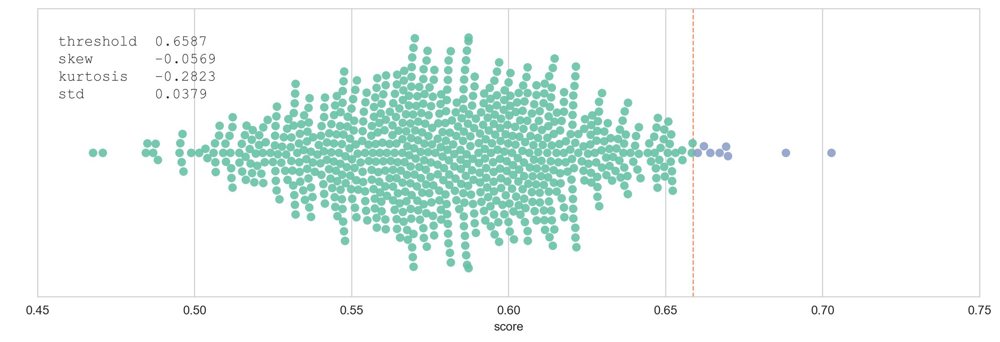

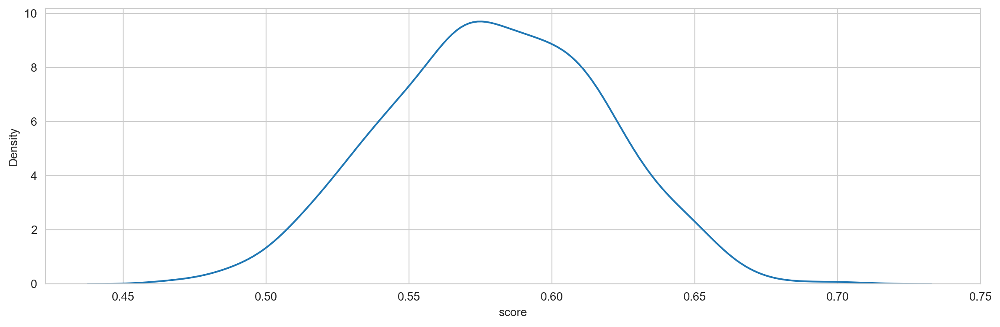

**Article 37**

Macy’s And Kohl’s Define Post-Pandemic Department Stores’ Look

Department stores of the future will operate with tighter inventories, speedy delivery and a host of merchandise partners. They will be profitable and will concentrate on developing smaller selling units.

Last week Macy’s and Kohl’s reported sales and earnings for the second quarter of 2021. Sales and earnings for both companies were above expectations, and the companies dutifully raised their sales and earnings expectations for the rest of the fiscal year. Their enthusiasm is justified. Things are more normal and even women’s dresses are selling at a better pace. The back-to-school business has been generating strong demand for children’s clothing and adult apparel, suggesting that the third quarter of the current year had a strong start despite the fact that the Delta variant of the coronavirus has rekindled fear among consumers.

All retail companies were complaining about delays in their supply lines and cost of trans

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,441,Macy’s,M,Retail Trade,Department Stores,"Macy's, Inc. (originally Federated Department Stores, Inc.) is an American holding company founded by Xavier Warren in 1929. Upon its establishment, Federated held ownership of the regional department store chains Abraham & Straus, Lazarus, Filene's, and Shillito's. Bloomingdale's joined Federated Department Stores the following year. Throughout its early history, frequent acquisitions and divestitures saw the company operate a number of nameplates. In 1994, Federated took over the department store chain Macy's. With the acquisition of The May Department Stores Company in 2005, the regional nameplates were retired and replaced by the Macy's and Bloomingdale's brands nationwide by 2006. Ultimately, Federated itself was renamed Macy's, Inc. in 2007.",0.725953
1,306,GAP,GPS,Retail Trade,Apparel/Footwear Retail,"The Gap, Inc., commonly known as Gap Inc. or Gap (stylized as GAP), is an American worldwide clothing and accessories retailer. Gap was founded in 1969 by Donald Fisher and Doris F. Fisher and is headquartered in San Francisco, California. The company operates six primary divisions: Gap (the namesake banner), Banana Republic, Old Navy, Intermix, Hill City, and Athleta. Gap Inc. is the largest specialty retailer in the United States, and is 3rd in total international locations, behind Inditex Group and H&M. As of September 2008, the company has approximately 135,000 employees and operates 3,727 stores worldwide, of which 2,406 are located in the U.S.",0.712795
2,577,Ralph Lauren,RL,Retail Trade,Apparel/Footwear Retail,"Ralph Lauren Corporation is an American publicly traded fashion company that was founded in 1967 by fashion designer Ralph Lauren. The company is headquartered in New York City, and it produces products ranging from the mid-range to the luxury segments. They are known for the marketing and distribution of products in four categories: apparel, home, accessories, and fragrances. The Company's brands include the mid-range Chaps brand, to the sub-premium Lauren Ralph Lauren brand, to the premium Polo Ralph Lauren, Double RL, Ralph Lauren Childrenswear, Denim & Supply Ralph Lauren, and Club Monaco brands, up to the full luxury Ralph Lauren Purple Label and Ralph Lauren Collection brands.",0.707305
3,201,Coty,COTY,Consumer Non-Durables,Household/Personal Care,"Coty Inc. is an American multinational beauty company founded in 1904 by François Coty. With its subsidiaries, it develops, manufactures, markets, and distributes fragrances, cosmetics, skin care, nail care, and both professional and retail hair care products. Coty owns around 77 brands as of 2018.",0.703967
4,415,Kohl’s,KSS,Retail Trade,Department Stores,"Kohl's is an American department store retail chain, operated by Kohl's Corporation. As of February 2013 it is the largest department store chain in the United States, with 1,158 locations, operating stores in every U.S. state except Hawaii. The company was founded by Polish immigrant Maxwell Kohl, who opened a corner grocery store in Milwaukee, Wisconsin in 1927. It went on to become a successful chain in the local area, and in 1962 the company branched out by opening its first department store. British American Tobacco Company took a controlling interest in the company in 1972 while still managed by the Kohl Family, and in 1979, the corporation was sold to BATUS Inc. A group of investors purchased the company in 1986 from British American Tobacco and took it public in 1992.",0.700843
5,413,KKR & Co,KKR,Finance,Investment Managers,"KKR & Co. Inc. (formerly known as Kohlberg Kravis Roberts & Co. and KKR & Co. L.P.) is an American global investment company that manages multiple alternative asset classes, including private equity, energy, infrastructure, real estate, credit, and, through its strategic partners, hedge funds. The firm has completed more than 280 private equity investments in portfolio co

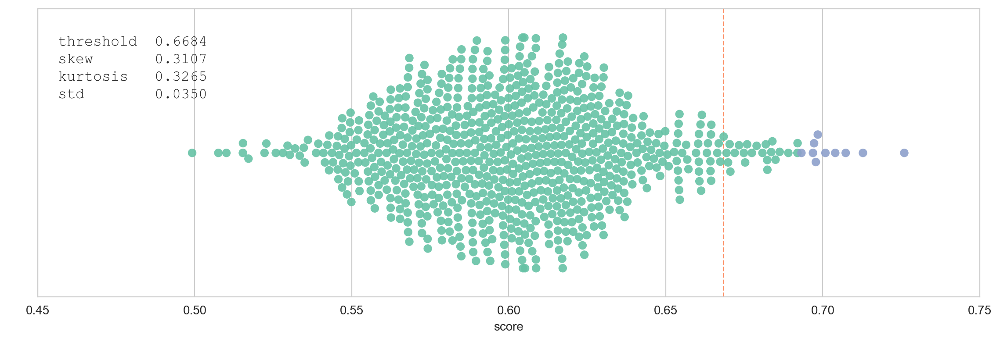

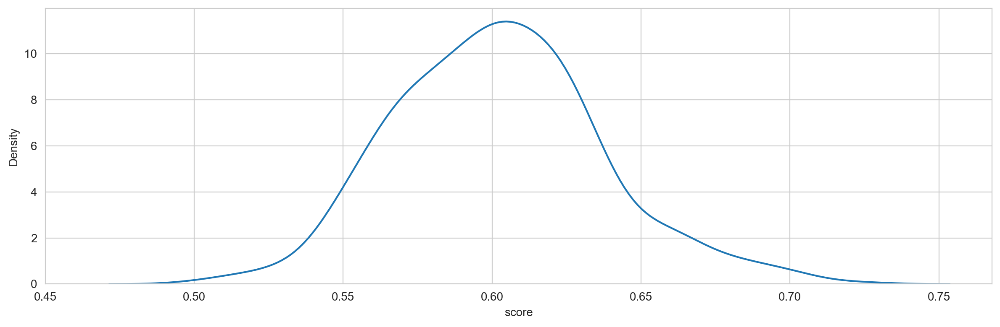

**Article 38**

What’s Next For Macy’s Stock After An 8% Move Last Week?

Macy’s stock (NYSE: M), a department store chain, increased by 8% in the last five trading days (one week). In comparison, the broader S&P500 index grew marginally over the same period. The company announced its plans to hire 76,000 employees for the upcoming holiday season, with approximately 37% of these new hires in permanent positions. Last year, about 6,800 seasonal workers remained with the company after holiday hiring in 2020. That said, the market reacted upward to this news probably because Macy’s (M) has fewer stores this year than in previous years, and yet they are hiring roughly the same amount of people for this holiday season. By the look of things, the company looks well-positioned to mitigate supply chain issues heading into the back half of the fiscal year.

Macy’s saw a stellar fiscal second-quarter after beating revenue and earnings expectations. The retailer’s sales increased 2% to $5.65 billion and adjusted

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,686,TJX Companies Inc,TJX,Retail Trade,Apparel/Footwear Retail,"The TJX Companies, Inc. (abbreviated TJX) is an American multinational off-price department store corporation, headquartered in Framingham, Massachusetts. It was formed as a subsidiary of Zayre Corp. in 1987, and became the legal successor to Zayre Corp. following a company reorganization in 1989.",0.699639
1,36,American Airlines,AAL,Transportation,Airlines,"American Airlines Group Inc. is an American publicly traded airline holding company headquartered in Fort Worth, Texas. It was formed on December 9, 2013, by the merger of AMR Corporation, the parent company of American Airlines, and US Airways Group, the parent company of US Airways. Integration was completed when the Federal Aviation Administration granted a single operating certificate for both carriers on April 8, 2015, and all flights now operate under the American Airlines brand.",0.681553
2,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.680260
3,159,Chewy,CHWY,Retail Trade,Internet Retail,"Chewy, Inc. is an American online retailer of pet food and other pet-related products based in Dania Beach, Florida. In 2017, Chewy was acquired by PetSmart for $3.35 billion, which was the largest ever acquisition of an e-commerce business at the time. The company completed its initial public offering in 2019, raising $1 billion. In 2020, total yearly net sales increased 47% to $7.15 billion from 2019 sales.",0.679580
4,702,Ulta Beauty,ULTA,Retail Trade,Specialty Stores,"Ulta Beauty, Inc., formerly known as Ulta Salon, Cosmetics & Fragrance Inc. and before 2000 as Ulta3, is an American chain of beauty stores headquartered in Bolingbrook, Illinois. Ulta Beauty carries cosmetics, fragrances, nail products, bath and body products, beauty tools and haircare products. Each store also has a beauty salon.",0.674324
5,118,Brixmor Property Group,BRX,Finance,Real Estate Investment Trusts,"Brixmor Property Group Inc. is a publicly traded real estate investment trust that invests in shopping centers. It owns and operates a high-quality, national portfolio of 400+ open-air retail centers comprising approximately 73 million square feet of prime retail space in established trade areas. Brixmor is a real estate partner to approximately 5,000 retailers including The TJX Companies, The Kroger Co., Publix Super Markets, Wal-Mart, Ross Stores and L.A. Fitness. It is organized in Maryland with its headquarters in New York City.",0.673296
6,664,Tapestry,TPR,Retail Trade,Apparel/Footwear Retail,"Tapestry, Inc. is an American multinational luxury fashion holding company. It is based in New York City and is the parent company of three major brands: Coach New York, Kate Spade New York and Stuart Weitzman. Originally named Coach, Inc., the business changed its name to Tapestry on October 31, 2017.",0.669004
7,69,ASML Holding,ASML,Producer Manufacturing,Industrial Machinery,ASML is a Dutch multinational company specializing in development and manufacturing of photolithography systems. Currently it is the largest supplier of photolithography systems primarily for the semiconductor industry. The company manufactures machines for the production of integrated circuits.,0.667880
8,305,GameStop,GME,Retail Trade,Electronics/Appliance Stores,"GameStop Corp. is an American video game, consumer electronics, and gam

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
10,441,Macy’s,M,Retail Trade,Department Stores,"Macy's, Inc. (originally Federated Department Stores, Inc.) is an American holding company founded by Xavier Warren in 1929. Upon its establishment, Federated held ownership of the regional department store chains Abraham & Straus, Lazarus, Filene's, and Shillito's. Bloomingdale's joined Federated Department Stores the following year. Throughout its early history, frequent acquisitions and divestitures saw the company operate a number of nameplates. In 1994, Federated took over the department store chain Macy's. With the acquisition of The May Department Stores Company in 2005, the regional nameplates were retired and replaced by the Macy's and Bloomingdale's brands nationwide by 2006. Ultimately, Federated itself was renamed Macy's, Inc. in 2007.",0.661628


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
18,415,Kohl’s,KSS,Retail Trade,Department Stores,"Kohl's is an American department store retail chain, operated by Kohl's Corporation. As of February 2013 it is the largest department store chain in the United States, with 1,158 locations, operating stores in every U.S. state except Hawaii. The company was founded by Polish immigrant Maxwell Kohl, who opened a corner grocery store in Milwaukee, Wisconsin in 1927. It went on to become a successful chain in the local area, and in 1962 the company branched out by opening its first department store. British American Tobacco Company took a controlling interest in the company in 1972 while still managed by the Kohl Family, and in 1979, the corporation was sold to BATUS Inc. A group of investors purchased the company in 1986 from British American Tobacco and took it public in 1992.",0.653074


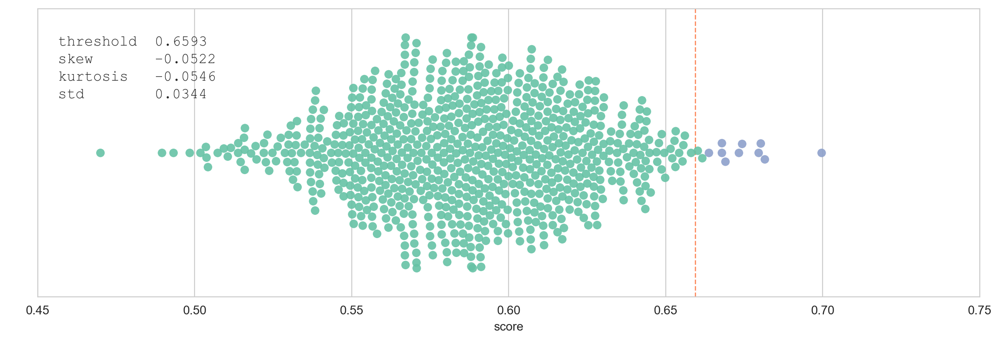

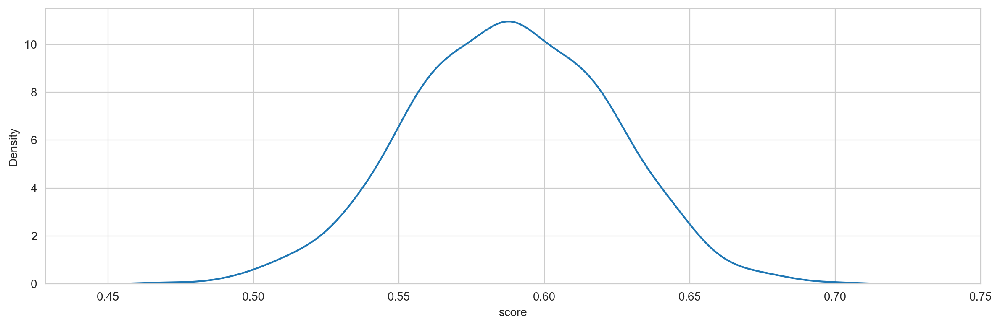

**Article 39**

Alibaba stock tumbles after report says Beijing wants to break up Alipay

Hong Kong (CNN Business) — Shares in Alibaba slumped again on Monday after the Financial Times reported that Beijing is planning to break up Alipay, the hugely popular payment app owned by its financial affiliate, Ant Group.

But that wasn't the only piece of news that led to the stock's decline. Investors are also concerned that Beijing is intensifying its ongoing crackdown on big tech, after regulators ordered internet firms — including Alibaba and Tencent — to stop blocking rivals' links on their platforms.

Alibaba (BABA) fell as much as 7% in Hong Kong, before trimming losses to 4.2% at the close. The stock has shed 46% since early November 2020, when Chinese regulators halted Ant Group's giant IPO at the last minute, erasing about $380 billion off Alibaba's market value. Ant Group was spun off from Jack Ma's Alibaba in 2011. Alibaba still owns a third of the fintech company.

Since yanking its IPO, regulato

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,161,China Mobile,CHL,Communications,Telecommunications Equipment,"China Mobile is the trade name of both China Mobile Limited (Chinese: 中国移动有限公司; pinyin: Zhōngguó Yídòng Yǒu Xiàn Gōngsī) and its ultimate controlling shareholder, China Mobile Communications Group Co., Ltd. (Chinese: 中国移动通信集团有限公司; pinyin: Zhōngguó Yídòng Tōngxìn Jítuán Gōngsī, formerly known as China Mobile Communications Corporation, ""CMCC""), a Chinese state-owned company. China Mobile Limited provides mobile voice and multimedia services through its nationwide mobile telecommunications network across mainland China and Hong Kong.",0.720579
1,769,YY,YY,Technology Services,Internet Software/Services,"YY is a major Chinese video-based social network, a subsidiary of . It has over 300 million users. It features a virtual currency which users earn through activities such as karaoke or creating tutorial videos and which is later converted to real cash. Launched in 2005 as duowan.com (Nasdaq: YY), it originally targeted gamers, before broadening to include video streaming and chat features for uses such as concerts, fashion and sports. Users exchange ""virtual roses"" as a form of currency, with top users said to earn as much as $20,000 per month. In November 2012, YY was listed on the NASDAQ.",0.701149
2,23,Alibaba,BABA,Retail Trade,Internet Retail,"Alibaba Group Holding Limited, also known as Alibaba Group and Alibaba.com, is a Chinese multinational technology company specializing in e-commerce, retail, Internet, and technology. Founded on 28 June 1999 in Hangzhou, Zhejiang, the company provides consumer-to-consumer (C2C), business-to-consumer (B2C), and business-to-business (B2B) sales services via web portals, as well as electronic payment services, shopping search engines and cloud computing services. It owns and operates a diverse portfolio of companies around the world in numerous business sectors.",0.698347
3,468,Mizuho Financial Group,MFG,Finance,Major Banks,"Mizuho Financial Group, Inc. (株式会社みずほフィナンシャルグループ, Kabushiki-gaisha Mizuho Finansharu Gurūpu), abbreviated as MHFG, or simply called Mizuho, is a banking holding company headquartered in the Ōtemachi district of Chiyoda, Tokyo, Japan. The name ""mizuho (瑞穂)"" literally means ""abundant rice"" in Japanese and ""harvest"" in the figurative sense. Upon its founding, it was the largest bank in the world by assets. It is considered a systemically important bank by the Financial Stability Board.",0.696861
4,628,Sogou,SOGO,Technology Services,Internet Software/Services,"Sogou, Inc. (Chinese: 搜狗; pinyin: Sōugǒu; lit. 'Search-dog') is a Chinese technology company that offers a search engine. It is a subsidiary of Sohu, Inc. The offices of Sogou are located on the southeast corner of Tsinghua University in Beijing. Sogou also has offices in Chengdu co-located with Tencent's office building. In April 2018, Sogou established a R&D center in Guangzhou.",0.694503
5,469,Mobile TeleSystems PJSC,MBT,Communications,Wireless Telecommunications,"MTS (Russian: Мобильные ТелеСистемы, МТС, ""Mobile TeleSystems""), headquartered in Moscow, is the largest mobile network operator in Russia, operating on GSM, UMTS and LTE standards. Apart from cellular network, the company also offers local telephone service, broadband, mobile television, cable television, satellite television and digital television. As of Q1 2021, the company serves over 84.9 million subscribers in Russia, Armenia and Belarus.",0.691943
6,471,Momo,MOMO,Technology Services,Information Technology Services,"Momo (Chinese: 陌陌; pinyin: mò mò) is a free social search and instant messaging mobile app. The app allows users to chat with nearby friends and strangers. Momo provides users with free instant messaging services through Wifi, 3G and 4G. The client software is available for Android, iOS, and Windows Phone. Momo officially began operations in July 2011, and a month later, launched the first version 

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
12,396,JD.com,JD,Retail Trade,Internet Retail,"JD.com, Inc. (Chinese: 京东; pinyin: Jīngdōng), also known as Jingdong and formerly called 360buy, is a Chinese e-commerce company headquartered in Beijing. It is one of the two massive B2C online retailers in China by transaction volume and revenue, a member of the Fortune Global 500 and a major competitor to Alibaba-run Tmall.",0.671887
15,730,Vipshop Holdings Limited,VIPS,Retail Trade,Internet Retail,"Vipshop (Chinese: 唯品会; pinyin: Wei Pin Hui) is a Chinese company that operates the e-commerce website VIP.com (formerly Vipshop.com) specializing in online discount sales. Vipshop is based out of Guangzhou, Guangdong, China, and was listed on New York Stock Exchange (NYSE) on March 23, 2012. As of 2017, Vipshop had 52.1 million customers, and there were 269.8 million orders for the year 2016. Following Tmall and JD.com, it is now the third largest e-commerce site in China.",0.663908


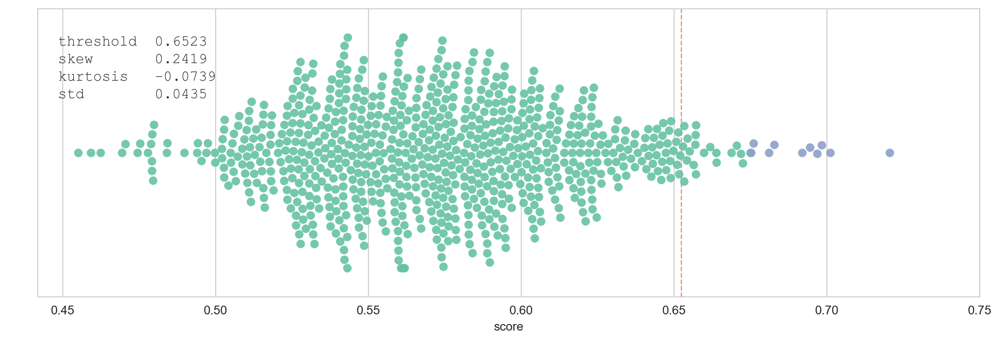

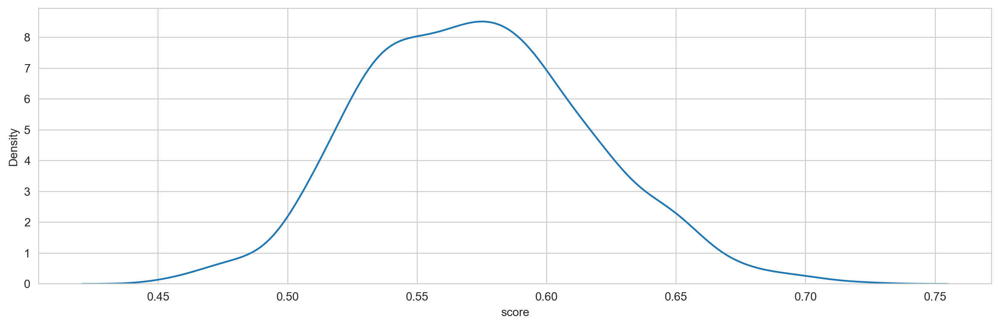

**Article 40**

Why JD.com Is My Top Chinese E-Commerce Stock

There are a lot of options for investors to choose from in Chinese e-commerce.

In this Backstage Pass segment recorded on Aug. 23, Fool contributors Jeremy Bowman and Brian Withers explain why JD.com (NASDAQ:JD) is their favorite in the sector. Among JD's assets are its vast logistics network, innovative technology, and its push into new industries like telehealth and supermarkets.

Jeremy Bowman: I think my favorite of the three for a while has been JD.com. I like what they are doing a lot in logistics. I think they are building out a lot of the competitive advantages that we've seen with Amazon as far as logistics. They started off doing first-party. They're adding more marketplace sales. They can provide logistics services as well. I like the way they are moving into healthcare with an online pharmacy. I think they are doing some telehealth things, which is pretty cool. They've added on groceries. They started off as mostly selling ele

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,163,Ciena Corporation,CIEN,Electronic Technology,Telecommunications Equipment,"Ciena Corporation is an American telecommunications networking equipment and software services supplier based in Hanover, Maryland. The company has been described by The Baltimore Sun as the ""world's biggest player in optical connectivity."" The company reported revenues of $3.57 billion for 2019. Ciena has approximately 6,000 employees, as of October 2018. Gary Smith serves as president and chief executive officer (CEO). Customers include AT&T, Deutsche Telekom, Korea Telecom, Sprint Corporation, and Verizon Communications.",0.702956
1,58,Appian Corporation,APPN,Technology Services,Packaged Software,"Appian Corporation is a cloud computing and enterprise software company headquartered in McLean, Virginia, part of the Dulles Technology Corridor. The company sells a platform as a service (PaaS) for building enterprise software applications. It is focused on low-code development, business process management, and case management markets.",0.673674
2,408,Keysight Technologies,KEYS,Electronic Technology,Electronic Equipment/Instruments,"Keysight Technologies, or Keysight, is an American company that manufactures electronics test and measurement equipment and software. In 2014, Keysight was spun off from Agilent Technologies, taking with it the product lines focused on electronics and radio, leaving Agilent with the chemical and bio-analytical products. The name is a blend of key and insight, and was chosen to convey that the company ""unlocks"" ""critical or key insights"".",0.673076
3,372,Infinera Corporation,INFN,Electronic Technology,Telecommunications Equipment,"Infinera Corporation is a San Jose, California-based vertically integrated manufacturer of Wavelength division multiplexing (WDM)-based packet optical transmission equipment and IP transport technologies for the telecommunications service provider market. It is a pioneer in designing and manufacturing of large-scale photonic integrated circuits (PICs). The company sells hardware and software networking options for Tier 1 carrier, Internet content provider, cable operator, government, and enterprise networks.",0.671817
4,737,Walgreens Boots,WBA,Retail Trade,Drugstore Chains,"Walgreens Boots Alliance, Inc. is a holding company headquartered in Deerfield, Illinois that owns the retail pharmacy chains Walgreens and Boots, as well as several pharmaceutical manufacturing, wholesale, and distribution companies. The company was formed on December 31, 2014, after Walgreens purchased the 55% stake in Alliance Boots that it did not already own. The total price of the acquisition was $4.9 billion in cash and 144.3 million common shares with fair value of $10.7 billion. Walgreens had previously purchased 45% of the company for $4.0 billion and 83.4 million common shares in August 2012 with an option to purchase the remaining shares within three years. Walgreens became a subsidiary of the newly created company after the transactions were completed. As of 2020, Walgreens Bo",0.669542
5,610,Seagate Technology,STX,Electronic Technology,Computer Peripherals,"Seagate Technology Holdings plc, an Irish public limited company (commonly referred to as Seagate), is an American data storage company. It was incorporated in 1978 as Shugart Technology and commenced business in 1979. Since 2010, the company has been incorporated in Dublin, Ireland, with operational headquarters in Fremont, California, United States.",0.669403
6,487,NeoPhotonics,NPTN,Electronic Technology,Electronic Components,"NeoPhotonics Corporation is an American public corporation based in San Jose, California. It was founded in 1996. The company develops, manufactures and sells optoelectronic products that transmit, receive and switch high speed digital optical signals for communications networks, These products include transceivers, tunable lasers, high bandwidth receivers, optical se

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
63,396,JD.com,JD,Retail Trade,Internet Retail,"JD.com, Inc. (Chinese: 京东; pinyin: Jīngdōng), also known as Jingdong and formerly called 360buy, is a Chinese e-commerce company headquartered in Beijing. It is one of the two massive B2C online retailers in China by transaction volume and revenue, a member of the Fortune Global 500 and a major competitor to Alibaba-run Tmall.",0.639495


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
14,730,Vipshop Holdings Limited,VIPS,Retail Trade,Internet Retail,"Vipshop (Chinese: 唯品会; pinyin: Wei Pin Hui) is a Chinese company that operates the e-commerce website VIP.com (formerly Vipshop.com) specializing in online discount sales. Vipshop is based out of Guangzhou, Guangdong, China, and was listed on New York Stock Exchange (NYSE) on March 23, 2012. As of 2017, Vipshop had 52.1 million customers, and there were 269.8 million orders for the year 2016. Following Tmall and JD.com, it is now the third largest e-commerce site in China.",0.654216
39,23,Alibaba,BABA,Retail Trade,Internet Retail,"Alibaba Group Holding Limited, also known as Alibaba Group and Alibaba.com, is a Chinese multinational technology company specializing in e-commerce, retail, Internet, and technology. Founded on 28 June 1999 in Hangzhou, Zhejiang, the company provides consumer-to-consumer (C2C), business-to-consumer (B2C), and business-to-business (B2B) sales services via web portals, as well as electronic payment services, shopping search engines and cloud computing services. It owns and operates a diverse portfolio of companies around the world in numerous business sectors.",0.646546


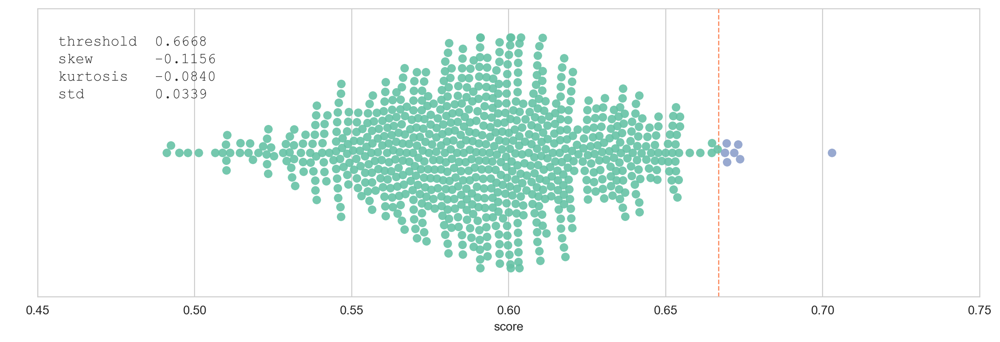

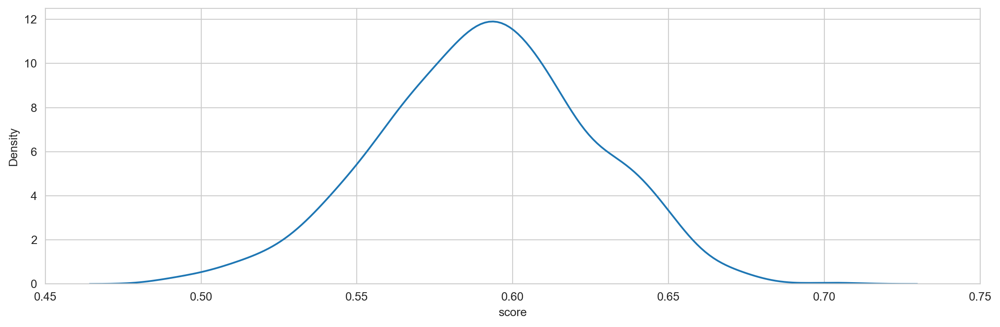

**Article 41**

Why Vipshop Stock Crashed (Further) Today

What happened

Shares of Vipshop Holdings (NYSE:VIPS) slumped again on Thursday, losing as much as 10.6% before recovering some of its losses. As of 2:21 p.m. EDT, the stock was down 5.3%.

The Chinese e-commerce company plunged anew after a Wall Street analyst posited that its immediate future looks bleak.

So what

Vipshop has had a rough year thus far and the bad times could continue. So says J.P. Morgan analyst Andre Chang, who downgraded the stock from overweight (buy) to neutral (hold), while slashing its price target in half, from $22 to $11, according to a report by The Fly. 

It's important to note that the stock has already lost nearly 74% of its value since hitting a new all-time high earlier this year. Chang believes that even after this rout, Vipshop stock could have further to fall in the coming months, as challenges remain for the online retailer. The analyst is forecasting revenue growth of just 5% year over year in the second 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,396,JD.com,JD,Retail Trade,Internet Retail,"JD.com, Inc. (Chinese: 京东; pinyin: Jīngdōng), also known as Jingdong and formerly called 360buy, is a Chinese e-commerce company headquartered in Beijing. It is one of the two massive B2C online retailers in China by transaction volume and revenue, a member of the Fortune Global 500 and a major competitor to Alibaba-run Tmall.",0.673674
1,332,Hanesbrands,HBI,Consumer Non-Durables,Apparel/Footwear,"Hanesbrands Inc. is an American multinational clothing company based in Winston-Salem, North Carolina. It employs 65,300 people internationally. On September 6, 2006, the company and several brands were spun off by the Sara Lee Corporation. Hanesbrands owns several clothing brands, including Hanes, Champion, Playtex, Bali, L'eggs, Just My Size, , Barely There, Wonderbra, Dim, Berlei, Bonds, Duofold, , , , Celebrity, , , , Maidenform, , Ritmo, , , Sol, , , Bonds and Zorba.",0.667513
2,730,Vipshop Holdings Limited,VIPS,Retail Trade,Internet Retail,"Vipshop (Chinese: 唯品会; pinyin: Wei Pin Hui) is a Chinese company that operates the e-commerce website VIP.com (formerly Vipshop.com) specializing in online discount sales. Vipshop is based out of Guangzhou, Guangdong, China, and was listed on New York Stock Exchange (NYSE) on March 23, 2012. As of 2017, Vipshop had 52.1 million customers, and there were 269.8 million orders for the year 2016. Following Tmall and JD.com, it is now the third largest e-commerce site in China.",0.655679
3,23,Alibaba,BABA,Retail Trade,Internet Retail,"Alibaba Group Holding Limited, also known as Alibaba Group and Alibaba.com, is a Chinese multinational technology company specializing in e-commerce, retail, Internet, and technology. Founded on 28 June 1999 in Hangzhou, Zhejiang, the company provides consumer-to-consumer (C2C), business-to-consumer (B2C), and business-to-business (B2B) sales services via web portals, as well as electronic payment services, shopping search engines and cloud computing services. It owns and operates a diverse portfolio of companies around the world in numerous business sectors.",0.654733
4,448,Marvell Technology,MRVL,Electronic Technology,Semiconductors,None,0.651233
5,202,Coupang,CPNG,Retail Trade,Internet Retail,"Coupang (Korean: 쿠팡) is a South Korean e-commerce company based in Seoul, South Korea, and incorporated in Delaware, United States. Founded in 2010 by Bom Kim, the company expanded to become the largest online marketplace in South Korea. Its expansion led the company to the video streaming distribution after launch the service Coupang Play. Coupang is often referred to as the ""Amazon of South Korea"", due its position and corporate size in South Korean online market.",0.649623
6,273,Evercore,EVR,Finance,Investment Banks/Brokers,"Evercore Inc., formerly known as Evercore Partners, is a global independent investment banking advisory firm founded in 1995 by Roger Altman, David Offensend, and Austin Beutner. Evercore's Investment Banking business advises its clients on mergers and acquisitions, divestitures, restructurings, financings, public offerings, private placements and other strategic transactions and also provides institutional investors with macro and fundamental equity research, sales and trading execution. Evercore's Investment Management business comprises wealth management, institutional asset management and private equity investing. Evercore serves clients from 28 offices in North America, Europe, South America and Asia. Since 1995, the firm has advised on more than $3 trillion of merger, acquisition, re",0.647322
7,533,Ozon,OZON,Retail Trade,Internet Retail,"Ozon is one of the first e-commerce companies in Russia, sometimes referred to as ""the Amazon of Russia."" Established in 1998 as an online bookstore, Ozon was one of the three biggest online retail platforms in the country by 2019. It was named as the #3 most valuable Russian internet company of 2020

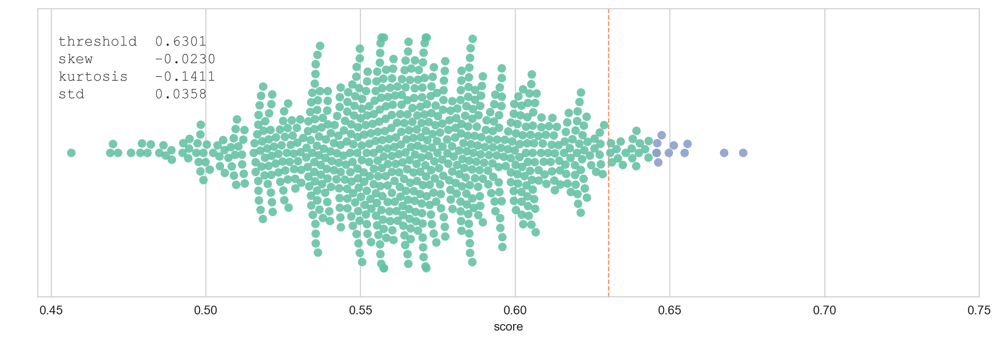

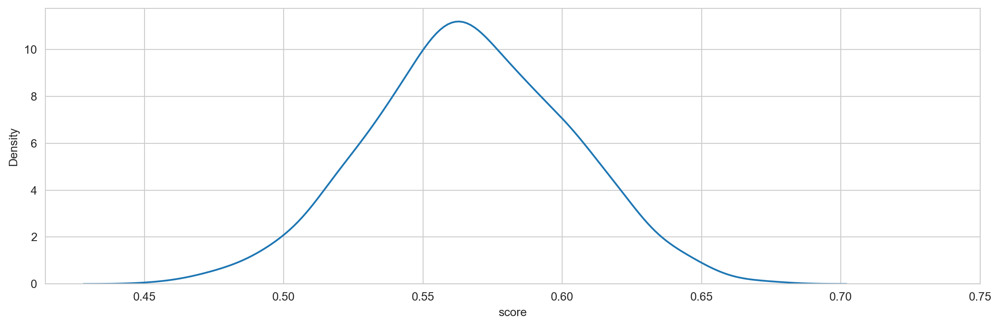

**Article 42**

Cisco Exec Riffs On Global 5G Core Delays

A 5G standalone (SA) core, more than anything else, defines what is and isn’t true 5G, and deployments remain astonishingly rare globally. 

Multiple factors have thus far precluded an abundance of 5G cores, including technical, financial, and readiness, according to Cisco EVP Jonathan Davidson.

Because most operators initially deployed 5G on a non-standalone (NSA) core anchored to 4G LTE, engineers are left no choice but to manage and operate networks, at least temporarily, running on 4G LTE, 5G NSA, and 5G SA. And that’s complicated, the GM of Cisco’s Mass-Scale Infrastructure Group, explained in a phone interview. 

“If you were to look at the call flows for how you do handoffs from 4G to 5G NSA to 5G SA, the control plane complexity is really high. And a lot of [operators] are putting in different cores, and so the handoffs are challenging,” he said. 

Signaling issues become less troublesome in a converged core — an effort that will help

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,488,NetApp,NTAP,Electronic Technology,Computer Peripherals,"NetApp, Inc. is an American hybrid cloud data services and data management company headquartered in Sunnyvale, California. It has ranked in the Fortune 500 since 2012. Founded in 1992 with an IPO in 1995, NetApp offers cloud data services for management of applications and data both online and physically.",0.733091
1,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.724043
2,733,VMware,VMW,Technology Services,Information Technology Services,"VMware, Inc. is an American cloud computing and virtualization technology company headquartered in California. VMware was the first commercially successful company to virtualize the x86 architecture. VMware's desktop software runs on Microsoft Windows, Linux, and macOS, while its enterprise software hypervisor for servers, VMware ESXi, is a bare-metal hypervisor that runs directly on server hardware without requiring an additional underlying operating system.",0.723460
3,487,NeoPhotonics,NPTN,Electronic Technology,Electronic Components,"NeoPhotonics Corporation is an American public corporation based in San Jose, California. It was founded in 1996. The company develops, manufactures and sells optoelectronic products that transmit, receive and switch high speed digital optical signals for communications networks, These products include transceivers, tunable lasers, high bandwidth receivers, optical semiconductors, photonic integrated circuits, and 100 gigabit per second and above modules."" These are each ""cost-effective components that handle massive amounts of data at very high speeds"".",0.721956
4,47,Analog Devices,ADI,Electronic Technology,Semiconductors,"Analog Devices, Inc. (ADI), also known simply as Analog, is an American multinational semiconductor company specializing in data conversion, signal processing and power management technology, headquartered in Wilmington, Massachusetts. In 2012, Analog Devices led the worldwide data converter market with a 48.5% share, according to analyst firm Databeans.The company manufactures analog, mixed-signal and digital signal processing (DSP) integrated circuits (ICs) used in electronic equipment.",0.712452
5,279,F5 Networks,FFIV,Electronic Technology,Computer Communications,"F5, Inc. is an American company that specializes in application delivery networking (ADN), application availability & performance, multi-cloud management, application security, network security, access & authorization and online fraud prevention. F5 is headquartered in Seattle, Washington, with additional development, manufacturing, and administrative offices worldwide. F5's offering was originally based on Application Delivery Controllers (ADC) solutions, but has since expanded into a wide variety of application layer, automation, multi-cloud and security services.",0.712396
6,403,Juniper Networks,JNPR,Technology Services,Information Technology Services,"Juniper Networks, Inc. is an American multinational corporation headquartered in Sunnyvale, California. The company develops and markets networking products, including routers, switches, network management software, network security products, and software-defined networking technology.",0.708580
7,734,Vonage Holdings,VG,Communications,Specialty Telecommunications,"Vonage (/ˈvɒnɪdʒ/, legal name Vonage Holdings Corp.) is an American publicly held business cloud communications provider. Headquartered in Holmdel Township, New Jersey, the co

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
26,167,Cisco,CSCO,Technology Services,Information Technology Services,"Cisco Systems, Inc. is an American multinational technology conglomerate headquartered in San Jose, California, in the center of Silicon Valley. Cisco develops, manufactures and sells networking hardware, software, telecommunications equipment and other high-technology services and products. Through its numerous acquired subsidiaries, such as OpenDNS, Webex, Jabber and Jasper, Cisco specializes in specific tech markets, such as the Internet of Things (IoT), domain security and energy management. On January 25, 2021, Cisco reincorporated in Delaware.",0.681479


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
449,72,AT&T,T,Communications,Major Telecommunications,"AT&T Inc. is an American multinational conglomerate holding company that is Delaware-registered but headquartered at Whitacre Tower in Downtown Dallas, Texas. It is the world's largest telecommunications company, it is also the largest provider of mobile telephone services in the U.S. As of 2020, AT&T was ranked 9th on the Fortune 500 rankings of the largest United States corporations, with revenues of $181 billion. The current AT&T reconstitutes much of the former Bell System, and includes four of the seven ""Baby Bells"" along with the original AT&T Corp., including the long-distance division.",0.587903


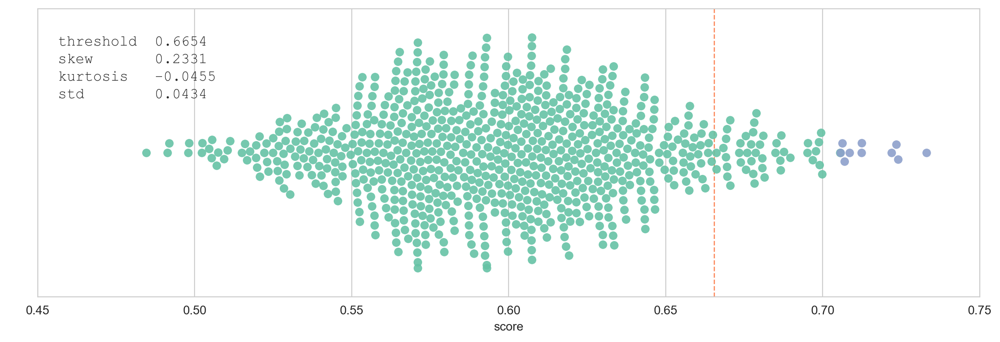

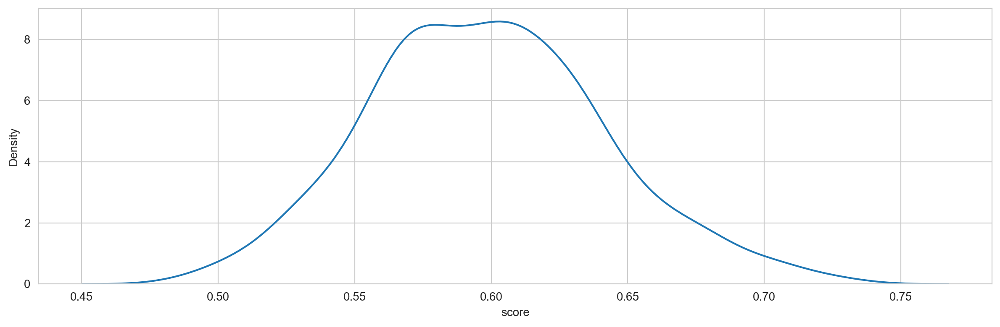

**Article 43**

iQIYI romantic drama 'One and Only' tops popularity rankings and generates buzz on social media

BEIJING, Sept. 9, 2021 /PRNewswire/ -- iQIYI Inc. (NASDAQ: IQ) ("iQIYI" or the "Company"), an innovative market-leading online entertainment service in China, is pleased to announce that its recently released romantic drama series One and Only has become a huge hit both domestically and overseas. The show has achieved a content popularity index of over 8,500 on the Company's platform since its release, having also topped the popularity rankings on multiple renowned Chinese content review platforms. The show is also among the top five drama series in terms of overseas viewership on iQIYI's international app (iQ.com), attracting much attention on global social media platforms. One and Only proves itself to be another iQIYI overseas hit that, like Story of Yanxi Palace, combines traditional Chinese aesthetics with original storytelling and universal appeal. 

Reserved its narrative style, One 

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,388,iQIYI,IQ,Technology Services,Internet Software/Services,"iQIYI (Chinese: 贾奇艺; simplified Chinese: 爱奇艺; traditional Chinese: 愛奇藝; pinyin: Ài qí yì), formerly Qiyi (奇艺), is a Chinese online video platform based in Beijing & Shanghai launched on April 22, 2010.",0.760759
1,674,Tencent Music Entertainment Group,TME,Technology Services,Internet Software/Services,"Tencent Music Entertainment Group (TME; Chinese: 腾讯音乐娱乐集团; pinyin: Téngxùn Yīnyuè Yúlè Jítuán) is a company that develops music streaming services for the Chinese market. Tencent Music's apps include QQ Music, Kugou, , and WeSing; which have more than 800 million active users and 120 million paying subscribers. As of July 2016, Tencent Music's three services held an estimated 56% market share of music streaming services in China.",0.733174
2,471,Momo,MOMO,Technology Services,Information Technology Services,"Momo (Chinese: 陌陌; pinyin: mò mò) is a free social search and instant messaging mobile app. The app allows users to chat with nearby friends and strangers. Momo provides users with free instant messaging services through Wifi, 3G and 4G. The client software is available for Android, iOS, and Windows Phone. Momo officially began operations in July 2011, and a month later, launched the first version of the app for iOS. Momo filed for a NASDAQ IPO on November 7, 2014 and was listed in December 2014.",0.707290
3,99,Bilibili,BILI,Technology Services,Internet Software/Services,"Bilibili (stylized bilibili, simplified Chinese: 哔哩哔哩; traditional Chinese: 嗶哩嗶哩; pinyin: bīlībīlī), also nicknamed B Site (B站) in China, is a Chinese video sharing website based in Shanghai, themed around animation, comics, and games (ACG), where users can submit, view and add overlaid commentary on videos. Bilibili uses Adobe Flash or HTML5 player, to play user submitted videos hosted by either itself or third-party sources, featuring a scrolling danmu (""bullet curtain"" : 弹幕 Chinese: danmu; Japanese: danmaku) commenting system. Since the mid-2010s, Bilibili began to expand to a broader audience from its original niche market that focused on anime and games, and it has become one of the major Chinese video on demand over-the-top streaming platforms that programs critically acclaimed and p",0.703026
4,362,HUYA,HUYA,Technology Services,Packaged Software,"Huya Live (Chinese: 虎牙直播) is a Chinese video live streaming service. The site is one of the largest of its kind in China, and also operates globally as Nimo TV. Similar to other streaming services like Twitch, the site primarily focuses on video game live streaming and includes official broadcasts of esports competitions. In addition, Huya also has live broadcasts for a variety of other genres, including cooking, traditional sports and ""real life"" streams.",0.698795
5,490,Netflix,NFLX,Consumer Services,Cable/Satellite TV,"Netflix, Inc. is an American over-the-top content platform and production company headquartered in Los Gatos, California. Netflix was founded in 1997 by Reed Hastings and Marc Randolph in Scotts Valley, California. The company's primary business is a subscription-based streaming service offering online streaming from a library of films and television series, including those produced in-house. As of July 2021, Netflix had 209 million subscribers, including 72 million in the United States and Canada. It is available worldwide except in mainland China (due to local restrictions), Syria, North Korea, and Crimea (due to US sanctions). The company has offices in Canada, France, Brazil, the Netherlands, India, Japan, South Korea, and the United Kingdom. Netflix is a member of the Motion Picture A",0.696775
6,769,YY,YY,Technology Services,Internet Software/Services,"YY is a major Chinese video-based social network, a subsidiary of . It has over 300 million users. It features a virtual currency which users earn through activities such as karaoke or creating tutorial videos 

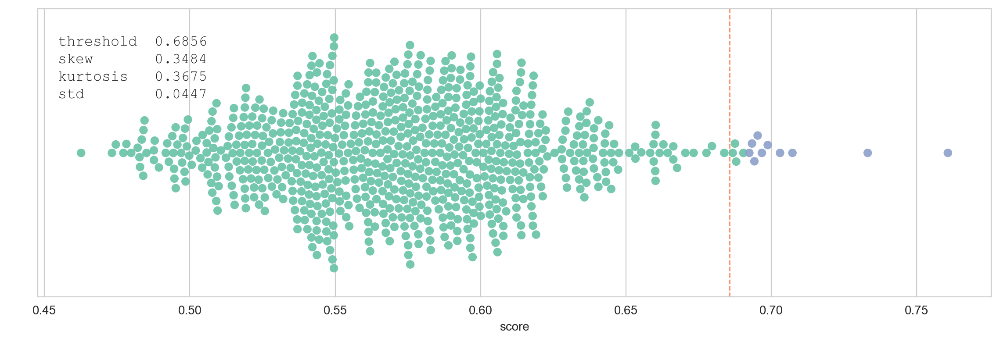

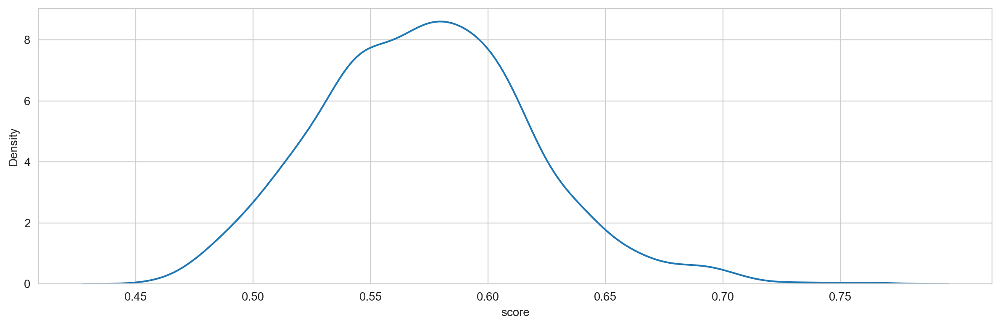

**Article 44**

Tencent Music Entertainment Group (NYSE:TME) Expected to Announce Quarterly Sales of $1.21 Billion

Equities analysts expect Tencent Music Entertainment Group (NYSE:TME) to announce $1.21 billion in sales for the current quarter, according to Zacks Investment Research. Two analysts have issued estimates for Tencent Music Entertainment Group's earnings. The lowest sales estimate is $1.20 billion and the highest is $1.21 billion. Tencent Music Entertainment Group posted sales of $1.12 billion in the same quarter last year, which would indicate a positive year over year growth rate of 8%. The firm is scheduled to issue its next quarterly earnings results on Tuesday, November 9th.

Tencent Music Stock is a Risky Yet Rewarding Bet Much Lower

On average, analysts expect that Tencent Music Entertainment Group will report full-year sales of $4.91 billion for the current financial year, with estimates ranging from $4.88 billion to $4.96 billion. For the next financial year, analysts expect tha

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,674,Tencent Music Entertainment Group,TME,Technology Services,Internet Software/Services,"Tencent Music Entertainment Group (TME; Chinese: 腾讯音乐娱乐集团; pinyin: Téngxùn Yīnyuè Yúlè Jítuán) is a company that develops music streaming services for the Chinese market. Tencent Music's apps include QQ Music, Kugou, , and WeSing; which have more than 800 million active users and 120 million paying subscribers. As of July 2016, Tencent Music's three services held an estimated 56% market share of music streaming services in China.",0.774636
1,769,YY,YY,Technology Services,Internet Software/Services,"YY is a major Chinese video-based social network, a subsidiary of . It has over 300 million users. It features a virtual currency which users earn through activities such as karaoke or creating tutorial videos and which is later converted to real cash. Launched in 2005 as duowan.com (Nasdaq: YY), it originally targeted gamers, before broadening to include video streaming and chat features for uses such as concerts, fashion and sports. Users exchange ""virtual roses"" as a form of currency, with top users said to earn as much as $20,000 per month. In November 2012, YY was listed on the NASDAQ.",0.729893


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
499,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.591772


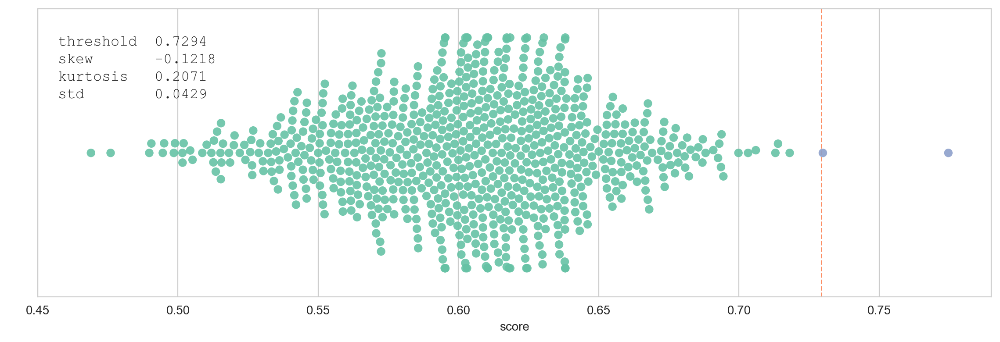

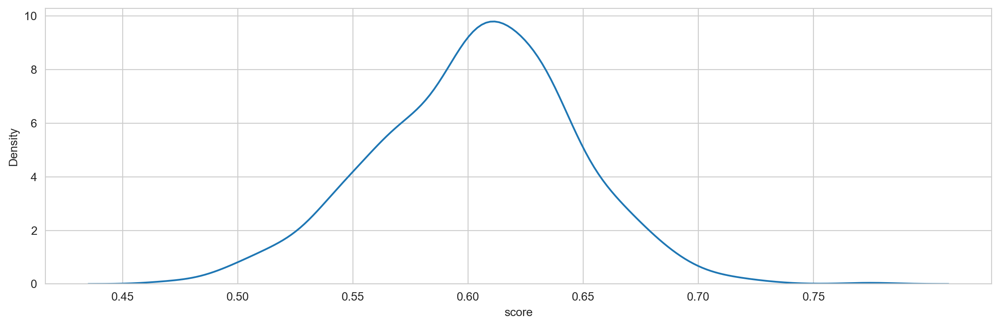

**Article 45**

Uber to benefit from a government takeover of Didi given its more than $5 billion stake, analyst says

Shares of Uber Technologies Inc. UBER, -2.69% rose 0.5% in premarket trading Friday, as the ride-sharing company was set to benefit from a potential investment in China-based rival Didi Global Inc. DIDI, -3.16% by China's government, according to Gordon Haskett analyst Robert Mollins. Didi's stock jumped 4.8% ahead of Friday's open after Bloomberg reported that China had proposed making an investment. Uber has disclosed that it owned about $6.3 billion worth of Didi's stock at the end of 2020, and said it sold $207 million worth of its investment in January and had agreed to sell another $293 million worth of Didi shares in the first half of 2021. "If the Bloomberg article proves to be true, we see this as a positive for Uber," Gordon Haskett's Mollins wrote in a note to clients. "Uber has been very upfront about wanting to monetize its stake in Didi and we see a transaction with Beij

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,226,DiDi Global Inc.,DIDI,Technology Services,Packaged Software,"Didi Chuxing Technology Co., (stylized DiDi, Chinese: 滴滴出行; pinyin: Dīdī Chūxíng, pronounced [tɨ́tɨ́ ʈʂʰúɕɪ̌ŋ]), formerly named Didi Dache (嘀嘀打车) and Didi Kuaidi (Chinese: 滴滴快的), is a Chinese vehicle for hire company headquartered in Beijing with over 550 million users and tens of millions of drivers. The company provides app-based transportation services, including taxi hailing, private car hailing, social ride-sharing, and bike sharing; on-demand delivery services; and automobile services, including sales, leasing, financing, maintenance, fleet operation, electric vehicle charging, and co-development of vehicles with automakers. The company is a subsidiary of Xiaoju Kuaizhi Inc.",0.714825
1,482,Nasdaq OMX Group,NDAQ,Finance,Investment Banks/Brokers,"Nasdaq, Inc. is an American multinational financial services corporation that owns and operates three stock exchanges in the United States: the namesake Nasdaq stock exchange, the Philadelphia Stock Exchange, and the Boston Stock Exchange, and seven European stock exchanges: Nasdaq Copenhagen, Nasdaq Helsinki, Nasdaq Iceland, Nasdaq Riga, Nasdaq Stockholm, Nasdaq Tallinn, and Nasdaq Vilnius. It is headquartered in New York City, and its president and chief executive officer is Adena Friedman.",0.706370
2,273,Evercore,EVR,Finance,Investment Banks/Brokers,"Evercore Inc., formerly known as Evercore Partners, is a global independent investment banking advisory firm founded in 1995 by Roger Altman, David Offensend, and Austin Beutner. Evercore's Investment Banking business advises its clients on mergers and acquisitions, divestitures, restructurings, financings, public offerings, private placements and other strategic transactions and also provides institutional investors with macro and fundamental equity research, sales and trading execution. Evercore's Investment Management business comprises wealth management, institutional asset management and private equity investing. Evercore serves clients from 28 offices in North America, Europe, South America and Asia. Since 1995, the firm has advised on more than $3 trillion of merger, acquisition, re",0.704596
3,161,China Mobile,CHL,Communications,Telecommunications Equipment,"China Mobile is the trade name of both China Mobile Limited (Chinese: 中国移动有限公司; pinyin: Zhōngguó Yídòng Yǒu Xiàn Gōngsī) and its ultimate controlling shareholder, China Mobile Communications Group Co., Ltd. (Chinese: 中国移动通信集团有限公司; pinyin: Zhōngguó Yídòng Tōngxìn Jítuán Gōngsī, formerly known as China Mobile Communications Corporation, ""CMCC""), a Chinese state-owned company. China Mobile Limited provides mobile voice and multimedia services through its nationwide mobile telecommunications network across mainland China and Hong Kong.",0.695021
4,121,Brookfield Infrastructure Partners,BIP,Utilities,Alternative Power Generation,"Brookfield Infrastructure Partners L.P. is a publicly traded limited partnership with corporate headquarters in Toronto, Canada, that engages in the acquisition and management of infrastructure assets on a global basis. Until a spin-off in January 2008, Brookfield Infrastructure was an operating unit of Brookfield Asset Management, which retains a 30 percent ownership and acts as the partnership's general manager. The company's assets carried a book value of US$21.3 billion, on December 31, 2016.",0.694139
5,23,Alibaba,BABA,Retail Trade,Internet Retail,"Alibaba Group Holding Limited, also known as Alibaba Group and Alibaba.com, is a Chinese multinational technology company specializing in e-commerce, retail, Internet, and technology. Founded on 28 June 1999 in Hangzhou, Zhejiang, the company provides consumer-to-consumer (C2C), business-to-consumer (B2C), and business-to-business (B2B) sales services via web portals, as well as electronic payment services, shopping search engines and cloud computing services. It owns a

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
169,699,Uber,UBER,Technology Services,Packaged Software,"Uber Technologies, Inc., commonly known as Uber, is an American technology company. Its services include ride-hailing, food delivery (Uber Eats), package delivery, couriers, freight transportation, and, through a partnership with Lime, electric bicycle and motorized scooter rental. The company is based in San Francisco and has operations in over 900 metropolitan areas worldwide. It is one of the largest firms in the gig economy.",0.642985


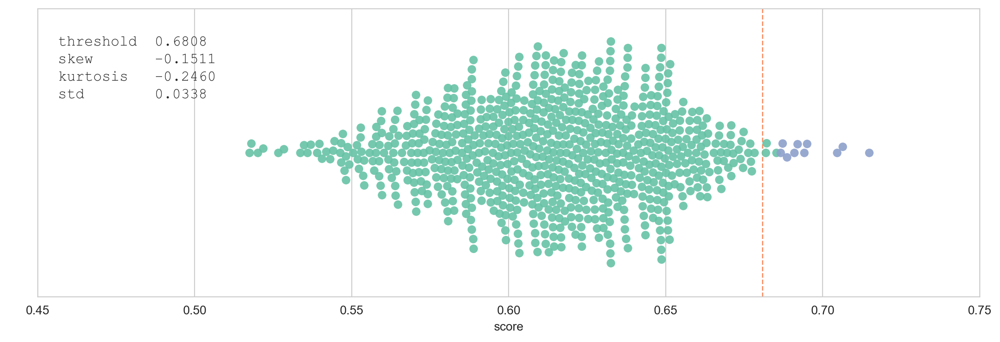

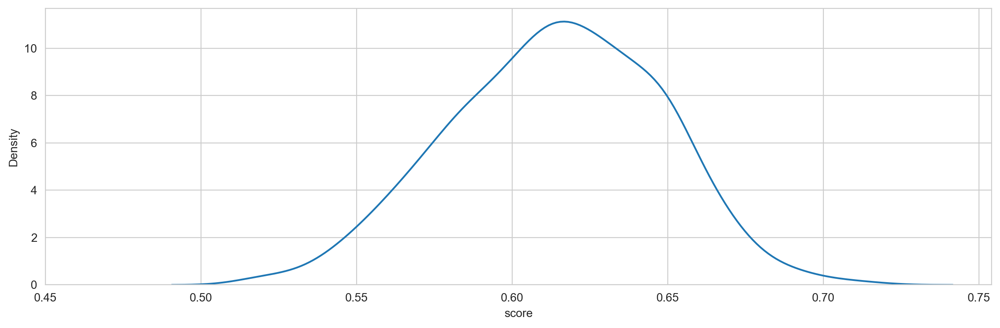

**Article 46**

Does Didi's crash point to the future of U.S.-China financial frictions?

Didi Global Inc., China’s largest ride-hailing app operator, went public on the New York Stock Exchange on June 30, pricing its initial public offering at the top of its range at $14 (¥1,540), meaning its total market value would reach some ¥8 trillion.

It is not surprising that the market welcomed the debut, considering the company’s rapid growth in the roughly nine years after its launch, making full use of artificial intelligence and data systems as its business strategy.

But shock waves hit the market only a few days later. Didi shares fell as much as 25% compared to the closing price from the previous week, after Chinese regulators on July 4 ordered app stores to remove the company’s app, citing serious legal violations regarding its collection and usage of personal information, and the Chinese government announced on July 6 it would tighten oversight of companies listed overseas.

The Didi crash, along wi

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,23,Alibaba,BABA,Retail Trade,Internet Retail,"Alibaba Group Holding Limited, also known as Alibaba Group and Alibaba.com, is a Chinese multinational technology company specializing in e-commerce, retail, Internet, and technology. Founded on 28 June 1999 in Hangzhou, Zhejiang, the company provides consumer-to-consumer (C2C), business-to-consumer (B2C), and business-to-business (B2B) sales services via web portals, as well as electronic payment services, shopping search engines and cloud computing services. It owns and operates a diverse portfolio of companies around the world in numerous business sectors.",0.751609
1,492,New Oriental Education & Tech Group,EDU,Consumer Services,Other Consumer Services,"New Oriental Education & Technology Group Inc. (Chinese: 新东方教育科技集团, NYSE: EDU), more commonly New Oriental (Chinese: 新东方), is a provider of private educational services in China. The headquarters of New Oriental is located in the Haidian district of Beijing. It is currently the largest comprehensive private educational company in China based on the number of program offerings, total student enrollments, and geographic presence. The business of New Oriental includes pre-school education, general courses for students of various age levels, online education, overseas study consulting, and textbook publishing. New Oriental was the first Chinese educational institution to enter the New York Stock Exchange in the United States, holding its IPO in 2006. As of 2016, New Oriental has built 67 short",0.749831
2,468,Mizuho Financial Group,MFG,Finance,Major Banks,"Mizuho Financial Group, Inc. (株式会社みずほフィナンシャルグループ, Kabushiki-gaisha Mizuho Finansharu Gurūpu), abbreviated as MHFG, or simply called Mizuho, is a banking holding company headquartered in the Ōtemachi district of Chiyoda, Tokyo, Japan. The name ""mizuho (瑞穂)"" literally means ""abundant rice"" in Japanese and ""harvest"" in the figurative sense. Upon its founding, it was the largest bank in the world by assets. It is considered a systemically important bank by the Financial Stability Board.",0.742785
3,482,Nasdaq OMX Group,NDAQ,Finance,Investment Banks/Brokers,"Nasdaq, Inc. is an American multinational financial services corporation that owns and operates three stock exchanges in the United States: the namesake Nasdaq stock exchange, the Philadelphia Stock Exchange, and the Boston Stock Exchange, and seven European stock exchanges: Nasdaq Copenhagen, Nasdaq Helsinki, Nasdaq Iceland, Nasdaq Riga, Nasdaq Stockholm, Nasdaq Tallinn, and Nasdaq Vilnius. It is headquartered in New York City, and its president and chief executive officer is Adena Friedman.",0.739007
4,480,MUFJ Financial Group,MUFG,Finance,Major Banks,"Mitsubishi UFJ Financial Group, Inc. (MUFG; 株式会社三菱UFJフィナンシャル・グループ, Kabushiki gaisha Mitsubishi Yūefujei Finansharu Gurūpu) is a Japanese bank holding and financial services company headquartered in Chiyoda, Tokyo, Japan.",0.734700
5,644,State Street,STT,Finance,Regional Banks,"State Street Corporation is an American financial services and bank holding company headquartered at One Lincoln Street in Boston with operations worldwide. It is the second-oldest continually operating United States bank; its predecessor, Union Bank, was founded in 1792. State Street is ranked 15th on the list of largest banks in the United States by assets. It is one of the largest asset management companies in the world with US$3.1 trillion under management and US$38.8 trillion under custody and administration. It is the second largest custodian bank in the world, and it is considered a systemically important bank by the Financial Stability Board.",0.734127
6,161,China Mobile,CHL,Communications,Telecommunications Equipment,"China Mobile is the trade name of both China Mobile Limited (Chinese: 中国移动有限公司; pinyin: Zhōngguó Yídòng Yǒu Xiàn Gōngsī) and its ultimate controlling shareholder, China Mobile Communications Group Co., Ltd. (Chinese: 中

**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
321,699,Uber,UBER,Technology Services,Packaged Software,"Uber Technologies, Inc., commonly known as Uber, is an American technology company. Its services include ride-hailing, food delivery (Uber Eats), package delivery, couriers, freight transportation, and, through a partnership with Lime, electric bicycle and motorized scooter rental. The company is based in San Francisco and has operations in over 900 metropolitan areas worldwide. It is one of the largest firms in the gig economy.",0.626797


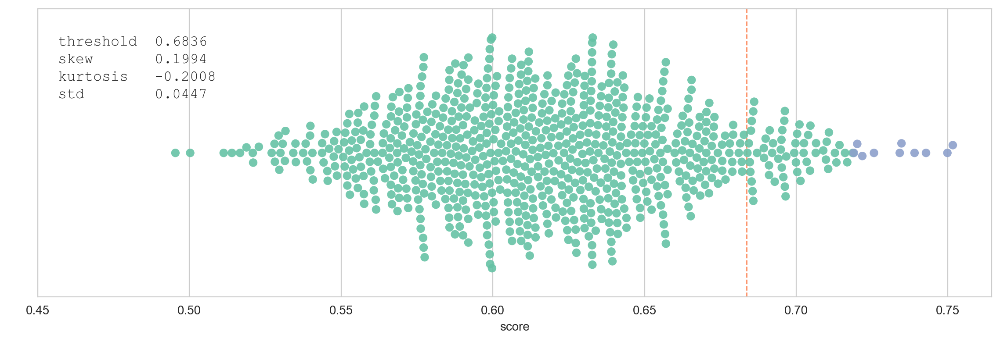

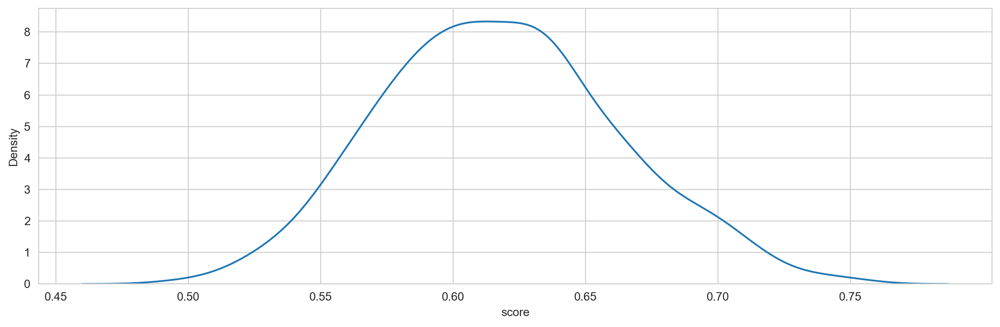

**Article 47**

Microsoft (MSFT) Set to Release Windows 11

Microsoft Corporation (MSFT) is set to release the latest version of its best-selling operating system Windows 11 on Oct. 5, the company announced in a blog post. Dubbed "the first version of a new era of Windows," the operating system is a long-awaited successor to Windows 10, which was released back in 2015.

KEY TAKEAWAYS

1. Microsoft is set to release Windows 11, the latest version of its best-selling operating system, on Oct. 5.
2. Windows 11 features several upgrades for productivity in a hybrid work environment, a new Microsoft store, and is the "best Windows ever for gaming."
3. Analysts estimate that Windows 11 will contribute 19% of Microsoft's overall profit margins for this year,

Windows 11 features several updates aimed at many customer segments. For example, it has an updated Start menu and a sleek design of rounded corners and sharper colors that some say is similar to Apple Inc.'s (AAPL) Mac OS.

The operating system is also

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,11,Advanced Micro Devices,AMD,Electronic Technology,Semiconductors,"Advanced Micro Devices, Inc. (AMD) is an American multinational semiconductor company based in Santa Clara, California, that develops computer processors and related technologies for business and consumer markets. While it initially manufactured its own processors, the company later outsourced its manufacturing, a practice known as going fabless, after GlobalFoundries was spun off in 2009. AMD's main products include microprocessors, motherboard chipsets, embedded processors and graphics processors for servers, workstations, personal computers and embedded system applications.",0.765295
1,610,Seagate Technology,STX,Electronic Technology,Computer Peripherals,"Seagate Technology Holdings plc, an Irish public limited company (commonly referred to as Seagate), is an American data storage company. It was incorporated in 1978 as Shugart Technology and commenced business in 1979. Since 2010, the company has been incorporated in Dublin, Ireland, with operational headquarters in Fremont, California, United States.",0.760057
2,733,VMware,VMW,Technology Services,Information Technology Services,"VMware, Inc. is an American cloud computing and virtualization technology company headquartered in California. VMware was the first commercially successful company to virtualize the x86 architecture. VMware's desktop software runs on Microsoft Windows, Linux, and macOS, while its enterprise software hypervisor for servers, VMware ESXi, is a bare-metal hypervisor that runs directly on server hardware without requiring an additional underlying operating system.",0.754618
3,279,F5 Networks,FFIV,Electronic Technology,Computer Communications,"F5, Inc. is an American company that specializes in application delivery networking (ADN), application availability & performance, multi-cloud management, application security, network security, access & authorization and online fraud prevention. F5 is headquartered in Seattle, Washington, with additional development, manufacturing, and administrative offices worldwide. F5's offering was originally based on Application Delivery Controllers (ADC) solutions, but has since expanded into a wide variety of application layer, automation, multi-cloud and security services.",0.745304
4,628,Sogou,SOGO,Technology Services,Internet Software/Services,"Sogou, Inc. (Chinese: 搜狗; pinyin: Sōugǒu; lit. 'Search-dog') is a Chinese technology company that offers a search engine. It is a subsidiary of Sohu, Inc. The offices of Sogou are located on the southeast corner of Tsinghua University in Beijing. Sogou also has offices in Chengdu co-located with Tencent's office building. In April 2018, Sogou established a R&D center in Guangzhou.",0.742245
5,762,Xilinx,XLNX,Electronic Technology,Semiconductors,"Xilinx, Inc. (/ˈzaɪlɪŋks/ ZY-links) is an American technology company that is primarily a supplier of programmable logic devices. The company invented the field-programmable gate array (FPGA). It is the semiconductor company that created the first fabless manufacturing model. Co-founded by Ross Freeman, Bernard Vonderschmitt, and James V Barnett II in 1984, the company went public on the NASDAQ in 1989. AMD announced its acquisition of Xilinx in October 2020.",0.738011
6,216,Datadog,DDOG,Technology Services,Packaged Software,"Datadog is a data observability service for cloud-scale applications, providing monitoring of servers, databases, tools, and services, through a SaaS-based data analytics platform.",0.735492
7,355,HP,HPQ,Electronic Technology,Computer Processing Hardware,"HP Inc. is an American multinational information technology company headquartered in Palo Alto, California, that develops personal computers (PCs), printers and related supplies, as well as 3D printing solutions. HP is listed on the New York Stock Exchange and is a constituent of the S&P 500 Index. It is the world's 2nd largest persona

**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
232,467,Microsoft,MSFT,Technology Services,Packaged Software,"Stamps.com is an American company that provides Internet-based mailing and shipping services. Stamps.com is a public company and trades on the NASDAQ exchange under the symbol STMP. The company's main offices are located in El Segundo, California.",0.642372


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
13,517,Nvidia,NVDA,Electronic Technology,Semiconductors,"Nvidia Corporation (/ɛnˈvɪdiə/ en-VID-ee-ə) is an American multinational technology company incorporated in Delaware and based in Santa Clara, California. It designs graphics processing units (GPUs) for the gaming and professional markets, as well as system on a chip units (SoCs) for the mobile computing and automotive market. Its primary GPU line, labeled ""GeForce"", is in direct competition with the GPUs of the ""Radeon"" brand by Advanced Micro Devices (AMD). Nvidia expanded its presence in the gaming industry with its handheld game consoles Shield Portable, Shield Tablet, and Shield Android TV and its cloud gaming service GeForce Now. Its professional line of GPUs are used in workstations for applications in such fields as architecture, engineering and construction, media and entertainmen",0.724831
23,375,Intel,INTC,Electronic Technology,Semiconductors,"Intel Corporation is an American multinational corporation and technology company headquartered in Santa Clara, California, in Silicon Valley. It is the world's largest semiconductor chip manufacturer by revenue, and is the developer of the x86 series of microprocessors, the processors found in most personal computers (PCs). Incorporated in Delaware, Intel ranked No. 45 in the 2020 Fortune 500 list of the largest United States corporations by total revenue during nearly a decade, from 2007 to 2016 fiscal years.",0.714975
28,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.710548
40,660,Taiwan Semiconductor,TSM,Electronic Technology,Semiconductors,"Taiwan Semiconductor Manufacturing Company, Limited (TSMC; Chinese: 台灣積體電路製造股份有限公司; pinyin: Táiwān jī tǐ diànlù zhìzào gǔfèn yǒuxiàn gōngsī, also called Taiwan Semiconductor) is a Taiwanese multinational semiconductor contract manufacturing and design company. It is the world's most valuable semiconductor company, the world's largest dedicated independent (pure-play) semiconductor foundry, and one of Taiwan's largest companies, with its headquarters and main operations located in the Hsinchu Science Park in Hsinchu. It is majority owned by foreign investors.",0.698629
46,466,Micron Technology,MU,Electronic Technology,Semiconductors,"Micron Technology, Inc. is an American producer of computer memory and computer data storage including dynamic random-access memory, flash memory, and USB flash drives. It is headquartered in Boise, Idaho. Its consumer products are marketed under the brands Crucial and Ballistix. Micron and Intel together created IM Flash Technologies, which produces NAND flash memory. It owned Lexar between 2006 and 2017.",0.693916


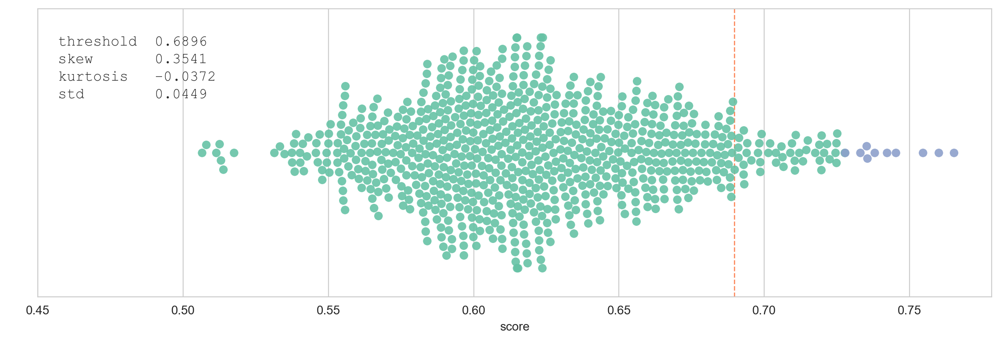

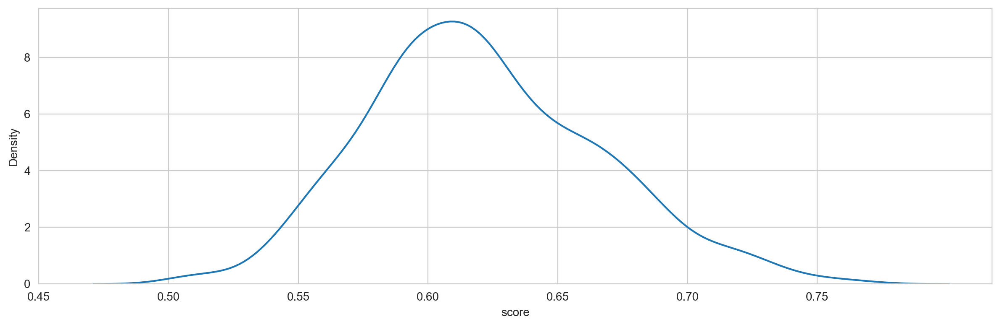

**Article 48**

Is Palantir Stock a Buy?

Palantir is creatively investing in building future revenue streams, making it a great idea for long-term investors.

Key Points

1. The "big data" market opportunity is massive and should continue growing in the years ahead.
2. Palantir is growing its government business in the short term while taking a long-term approach with commercial customers, investing in start-up type companies.
3. The stock is expensive but not unreasonable, considering the expected long-term revenue growth and accelerating free cash flow generation.

Innovation isn't just about what a company sells but also about how management runs the business. Big data software company Palantir Technologies (NYSE:PLTR) is getting creative, planting seeds now that could yield revenue growth down the road.

The stock receives much attention from Wall Street, but don't let that alone push you to consider Palantir for your portfolio. Here are three reasons Palantir is a great investment idea for long-

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,172,Cloudera,CLDR,Technology Services,Packaged Software,"Cloudera, Inc. is a US-based company that provides an enterprise data cloud. Built on open source technology, Cloudera’s platform uses analytics and machine learning to yield insights from data through a secure connection. Cloudera’s platform works across hybrid, multi-cloud and on-premises architectures and provides multi-function analytics throughout the edge to AI data lifecycle.",0.750055
1,515,Nutanix,NTNX,Technology Services,Packaged Software,"Nutanix, Inc. is an American cloud computing company that sells software, cloud services (such as desktops as a service, disaster Recovery as a service, and cloud monitoring), and software-defined storage.",0.714924


**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
79,537,Palantir,PLTR,Technology Services,Packaged Software,"Palantir Technologies is a public American software company that specializes in big data analytics. Headquartered in Denver, Colorado, it was founded by Peter Thiel, Nathan Gettings, Joe Lonsdale, Stephen Cohen, and Alex Karp in 2003. The company's name is derived from The Lord of the Rings where the magical palantíri were ""seeing-stones,"" described as indestructible balls of crystal used for communication and to see events in other parts of the world.",0.665045


**Missed stocks regarded as relevant**

,index,stock_name,ticker_symbol,sector,industry,comment,score
156,676,Tesla,TSLA,Consumer Durables,Motor Vehicles,"Tesla, Inc. is an American electric vehicle, clean energy, and technology company based in Palo Alto, California, United States. Tesla designs and manufactures electric cars, battery energy storage from home to grid-scale, solar panels and solar roof tiles, and related products and services. In 2020, Tesla had the most sales of battery electric vehicles and plug-in electric vehicles, capturing 16% of the plug-in market (which includes plug-in hybrids) and 23% of the battery-electric (purely electric) market. Through its subsidiary Tesla Energy, the company develops and is a major installer of photovoltaic systems in the United States. Tesla Energy is also one of the largest global suppliers of battery energy storage systems, with 3 gigawatt-hours (GWh) installed in 2020.",0.650350
388,59,Apple,AAPL,Electronic Technology,Telecommunications Equipment,"Apple Inc. is an American multinational technology company that specializes in consumer electronics, computer software, and online services. Apple is the world's largest technology company by revenue (totaling $274.5 billion in 2020) and, since January 2021, the world's most valuable company. As of 2021, Apple is the world's fourth-largest PC vendor by unit sales, and fourth-largest smartphone manufacturer. It is one of the Big Five American information technology companies, along with Amazon, Google, Microsoft, and Facebook.",0.617403


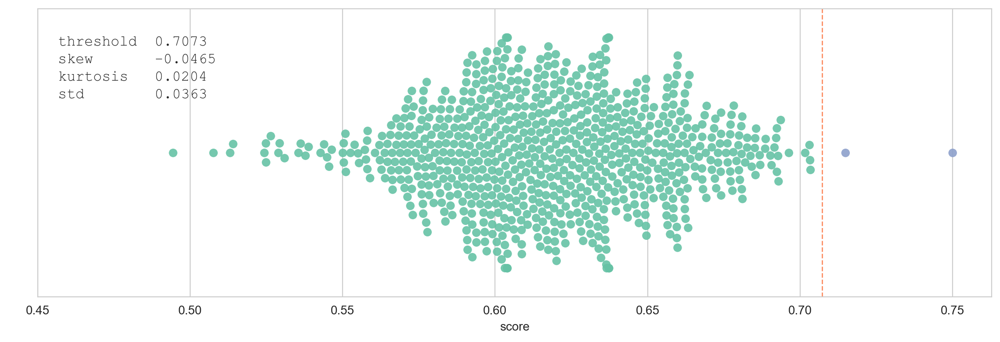

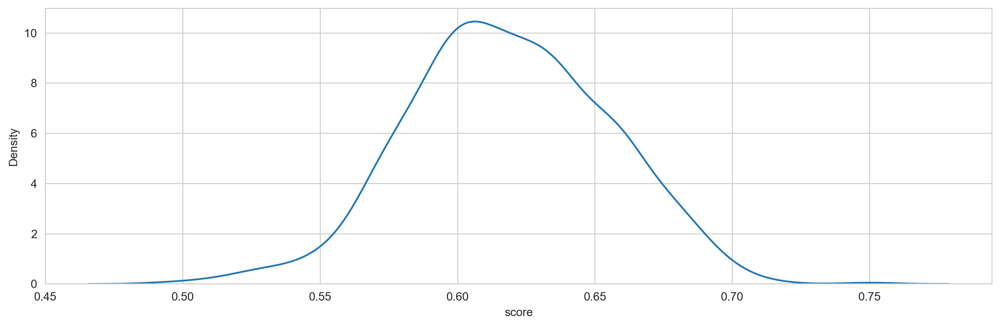

**Article 49**

Palantir backs satellite intelligence company

Palantir has extended its partnership with an emerging geospatial intelligence firm by making an equity investment.

Terms of Palantir's investment in BlackSky Holdings were not disclosed, but it follows a pilot program that saw BlackSky deliver insights and intelligence to Palantir customers within minutes of collection and without human interaction.

BlackSky said Wednesday that program involved several geospatial intelligence customers.

“This collaboration further enables BlackSky to put the power of real-time intelligence in the hands of the user by allowing Palantir customers to directly task our satellites, reduce decision-making timelines and increase the delivery of on-demand insights,” BlackSky CEO Brian O’Toole said in a release.

Following the pilot, the two companies have signed a multi-year software subscription agreement. They will integrate BlackSKy’s Spectra AI offering with Palantir Foundry.

“This partnership directly co

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,172,Cloudera,CLDR,Technology Services,Packaged Software,"Cloudera, Inc. is a US-based company that provides an enterprise data cloud. Built on open source technology, Cloudera’s platform uses analytics and machine learning to yield insights from data through a secure connection. Cloudera’s platform works across hybrid, multi-cloud and on-premises architectures and provides multi-function analytics throughout the edge to AI data lifecycle.",0.790358


**Missed stocks regarded as top**

,index,stock_name,ticker_symbol,sector,industry,comment,score
10,537,Palantir,PLTR,Technology Services,Packaged Software,"Palantir Technologies is a public American software company that specializes in big data analytics. Headquartered in Denver, Colorado, it was founded by Peter Thiel, Nathan Gettings, Joe Lonsdale, Stephen Cohen, and Alex Karp in 2003. The company's name is derived from The Lord of the Rings where the magical palantíri were ""seeing-stones,"" described as indestructible balls of crystal used for communication and to see events in other parts of the world.",0.709170


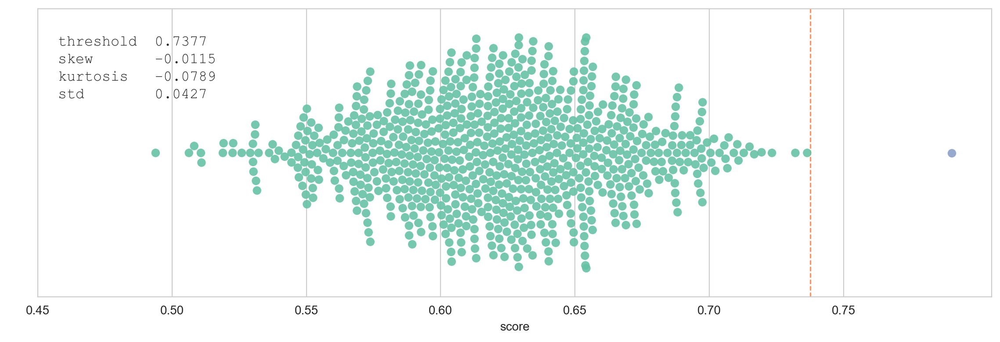

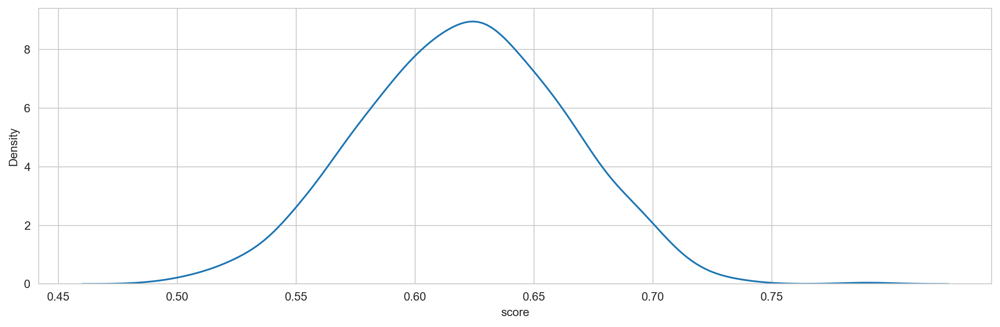

**Article 50**

Uber drivers to stage 24-hour strike

Drivers at ride hailing giant Uber are staging a strike on Tuesday over issues including pay and claims that workers are being unfairly dismissed.

Members of the App Drivers and Couriers Union (ADCU) will hold protests in London, Bristol, Birmingham, Nottingham, Sheffield, Manchester, Leeds and Glasgow, and are urging people not to use the service during the 24-hour walkout.

The union has accused the company of failing to implement a court ruling to pay waiting time, which it says makes up around 40% of an Uber driver’s working time, and claims that large numbers of drivers are being unfairly sacked.

Uber insisted it is working with unions to raise standards for drivers.

The union is also in dispute over the introduction of fixed price fares which it claims has led to reduced driver incomes.

Yaseen Aslam, ADCU president said: “It is shameful that Uber continues to defy the highest court in the land to cheat 70,000 workers out of pay for 40% of

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,699,Uber,UBER,Technology Services,Packaged Software,"Uber Technologies, Inc., commonly known as Uber, is an American technology company. Its services include ride-hailing, food delivery (Uber Eats), package delivery, couriers, freight transportation, and, through a partnership with Lime, electric bicycle and motorized scooter rental. The company is based in San Francisco and has operations in over 900 metropolitan areas worldwide. It is one of the largest firms in the gig economy.",0.682775
1,440,Lyft,LYFT,Technology Services,Packaged Software,"Lyft, Inc. develops, markets, and operates a mobile app, offering vehicles for hire, motorized scooters, a bicycle-sharing system, and food delivery. The company is based in San Francisco, California and operates in 644 cities in the United States and 12 cities in Canada. With a 30% market share, Lyft is the second-largest ridesharing company in the United States after Uber.",0.672396
2,238,DoorDash Inc,DASH,Technology Services,Internet Software/Services,"DoorDash, Inc. operates an online food ordering and food delivery platform. It is based in San Francisco, California, United States. With a 56% market share, it is the largest food delivery company in the United States. It also has a 60% market share in the convenience delivery category. As of December 31, 2020, the platform served 450,000 merchants, 20,000,000 consumers, and 1 million deliverers.",0.666397
3,396,JD.com,JD,Retail Trade,Internet Retail,"JD.com, Inc. (Chinese: 京东; pinyin: Jīngdōng), also known as Jingdong and formerly called 360buy, is a Chinese e-commerce company headquartered in Beijing. It is one of the two massive B2C online retailers in China by transaction volume and revenue, a member of the Fortune Global 500 and a major competitor to Alibaba-run Tmall.",0.661927
4,226,DiDi Global Inc.,DIDI,Technology Services,Packaged Software,"Didi Chuxing Technology Co., (stylized DiDi, Chinese: 滴滴出行; pinyin: Dīdī Chūxíng, pronounced [tɨ́tɨ́ ʈʂʰúɕɪ̌ŋ]), formerly named Didi Dache (嘀嘀打车) and Didi Kuaidi (Chinese: 滴滴快的), is a Chinese vehicle for hire company headquartered in Beijing with over 550 million users and tens of millions of drivers. The company provides app-based transportation services, including taxi hailing, private car hailing, social ride-sharing, and bike sharing; on-demand delivery services; and automobile services, including sales, leasing, financing, maintenance, fleet operation, electric vehicle charging, and co-development of vehicles with automakers. The company is a subsidiary of Xiaoju Kuaizhi Inc.",0.651418
5,520,Oatly,OTLY,Consumer Non-Durables,Food: Major Diversified,"Oatly Group AB is a Swedish food company that produces alternatives to dairy products from oats. Oatly was formed in the 1990s using research from Lund University. Oatly has headquarters in Malmö and a production and development center in Landskrona. Oatly's key markets are Sweden, Germany and the U.K., and its products were available in 60,000 retail stores and 32,200 coffee shops around the world as of 31 December 2020. Oatly can also be found in 11,000 coffee and tea shops in China, and at more than 6,000 retail and specialty shops across the country, including thousands of Starbucks locations.",0.649441
6,667,Tata Motors,TTM,Consumer Durables,Motor Vehicles,"Tata Motors Limited is an Indian multinational automotive manufacturing company, headquartered in Mumbai, Maharashtra which is part of Tata Group. The company produces passenger cars, trucks, vans, coaches, buses, sports cars, construction equipment and military vehicles. On 17 January 2017, Natarajan Chandrasekaran was appointed chairman of the company Tata Group. Tata Motors increased its UV market share to over 8% in FY2019.",0.647770
7,402,Jumia,JMIA,Technology Services,Internet Software/Services,"Jumia is an online marketplace for electronics, and fashion among others targeting several African countries. The compan

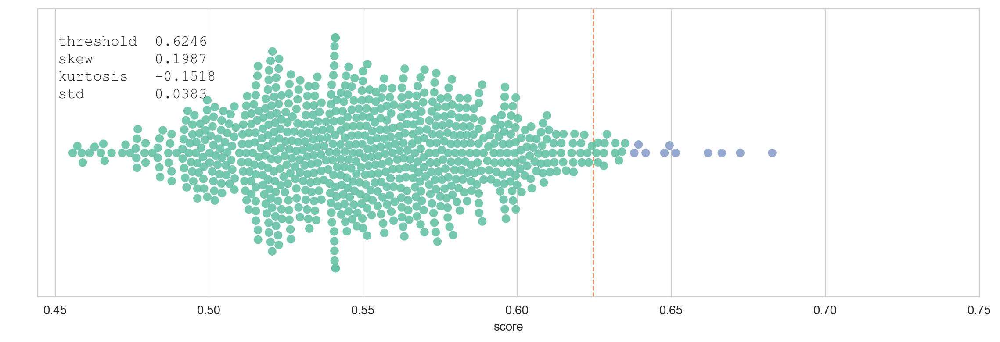

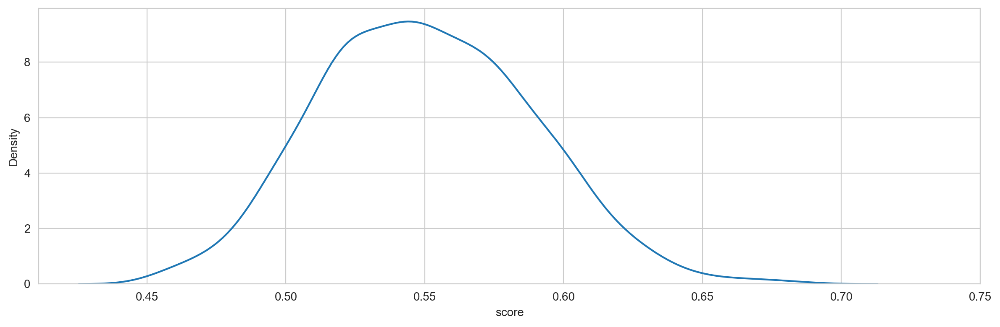

**Article 51**

American Airlines vs. United: Which Airline Stock Is a Better Investment?

AAL – Airlines stocks could be poised to make a comeback in the next 12-months, especially if the pandemic is brought under control. Which is why today I’m going to take a look at American Airlines (AAL) and United Airlines (UAL) to see which is the better investment.

The airline sector was among the worst hit amid the COVID-19 pandemic.  Traveling ground to a halt and airline companies burnt billions of dollars in cash to stay afloat.  

Since the onset of the coronavirus, most airline stocks have modestly rebounded from their Spring 2020 lows but the U.S. Global Jets ETF (JETS) is still trading down more than 23% from it’s pre-covid level.  This could be an opportune time to take advantage of these cheaper prices, as economies around the world continue to reopen.  

Which is why today I’m going to analyze two stocks in the airline industry, American Airlines (AAL) and United Airlines (UAL), to see which is cu

**Top stocks**

,index,stock_name,ticker_symbol,sector,industry,comment,score
0,36,American Airlines,AAL,Transportation,Airlines,"American Airlines Group Inc. is an American publicly traded airline holding company headquartered in Fort Worth, Texas. It was formed on December 9, 2013, by the merger of AMR Corporation, the parent company of American Airlines, and US Airways Group, the parent company of US Airways. Integration was completed when the Federal Aviation Administration granted a single operating certificate for both carriers on April 8, 2015, and all flights now operate under the American Airlines brand.",0.724055
1,692,Trip.com,TCOM,Consumer Services,Other Consumer Services,"Trip.com Group Limited (Chinese: 携程集团, formerly Ctrip.com International) is a Chinese multinational online travel company that provides services including accommodation reservation, transportation ticketing, packaged tours and corporate travel management. Founded in 1999, the company owns and operates Trip.com, Skyscanner, Qunar, and Ctrip, all of which are online travel agencies. Founded in 1999, it is currently the largest online travel agency (OTA) in China and one of the largest travel service providers in the world.",0.705813
2,482,Nasdaq OMX Group,NDAQ,Finance,Investment Banks/Brokers,"Nasdaq, Inc. is an American multinational financial services corporation that owns and operates three stock exchanges in the United States: the namesake Nasdaq stock exchange, the Philadelphia Stock Exchange, and the Boston Stock Exchange, and seven European stock exchanges: Nasdaq Copenhagen, Nasdaq Helsinki, Nasdaq Iceland, Nasdaq Riga, Nasdaq Stockholm, Nasdaq Tallinn, and Nasdaq Vilnius. It is headquartered in New York City, and its president and chief executive officer is Adena Friedman.",0.699479
3,16,Air Lease Corporation,AL,Finance,Finance/Rental/Leasing,"Air Lease Corporation (ALC) is an American aircraft leasing company founded in 2010 and headed by Steven F. Udvar-Házy. Air Lease purchases new commercial aircraft through direct orders from Boeing, Airbus, Embraer and ATR, and leases them to its airline customers worldwide through specialized aircraft leasing and financing. At the end of 2017, Air Lease reported that it owns 244 Airbus, Boeing, Embraer, and ATR aircraft, which it leases to over 91 airlines across 55 countries in every major geographical region in the world.",0.695374
4,345,Hilton Grand Vacations,HGV,Finance,Real Estate Development,"Hilton Grand Vacations Inc. is based in Orlando, Florida, United States, with regional offices located in Las Vegas, Nevada, Oahu, Hawaii, New York City, Marco Island, Florida and Sanibel Island, Florida. It was formerly a wholly owned subsidiary of Hilton Inc. (formerly Hilton Worldwide) until it was spun off into a publicly traded company. As of December 31, 2019, it has 55 properties with 8,916 rooms in 5 countries and territories, all franchised.",0.692052
5,273,Evercore,EVR,Finance,Investment Banks/Brokers,"Evercore Inc., formerly known as Evercore Partners, is a global independent investment banking advisory firm founded in 1995 by Roger Altman, David Offensend, and Austin Beutner. Evercore's Investment Banking business advises its clients on mergers and acquisitions, divestitures, restructurings, financings, public offerings, private placements and other strategic transactions and also provides institutional investors with macro and fundamental equity research, sales and trading execution. Evercore's Investment Management business comprises wealth management, institutional asset management and private equity investing. Evercore serves clients from 28 offices in North America, Europe, South America and Asia. Since 1995, the firm has advised on more than $3 trillion of merger, acquisition, re",0.692022
6,137,Carnival,CCL,Consumer Services,Hotels/Resorts/Cruise lines,"Carnival Corporation & plc is a British-American cruise operator, currently the world's largest travel leisure company, with a combined fleet of over 1

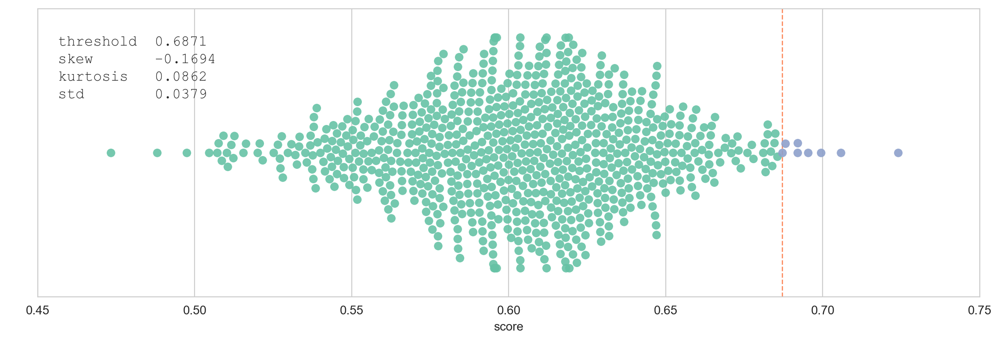

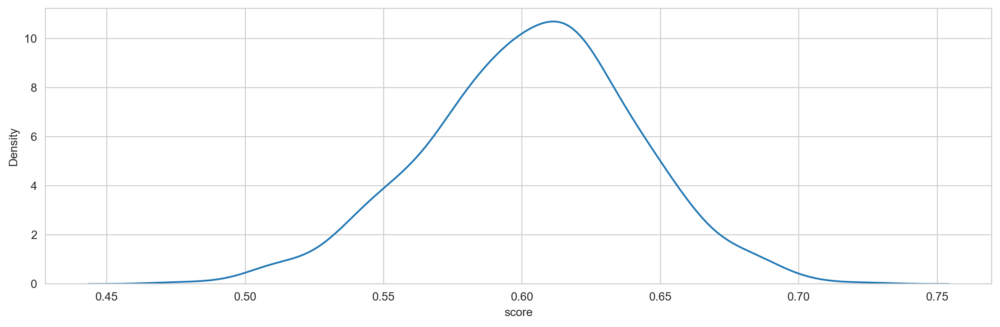

In [59]:
for article_id in range(len(articles)):
    _ = show_results(article_id, models=models, stocks_df=stocks_df, articles=articles)

### Selecting which articles to discard in place of out-of-sample articles

In [25]:
to_discard = [2, 13, 16, 18, 21, 25, 30, 31, 33, 38, 40, 42, 45, 47, 48, 49]
len(to_discard)

16

### Saving article matches for user study 

In [26]:
article_matches = {k:v.to_dict(orient="records") for k,v in article_matches.items() 
                   if int(k) not in to_discard}

In [27]:
output_path = Path("../../data/test/user_study/temp/article_matches_v2.json")
output_path.parent.mkdir(exist_ok=True)

with open(output_path, "w", encoding="utf-8") as fp:
    json.dump(article_matches, fp, ensure_ascii=False, indent="\t")

### Displaying more results of articles noted in the evaluation document

In [ ]:
def show_more_results(article_id, more=15):
    stocks = show_results(article_id)
    with pd.option_context("display.max_colwidth", None):
        print_strong("More results:")
        display(left_align_text(stocks.head(more)))

In [ ]:
for article_id in [8,9,11,12,15,16,20,23,24,27,30,34,36,39,41,42,43,44,51]:
    show_more_results(article_id)